# Mini Project

# Unveiling promising HIV1-RT inhibitors: ML based exploration of abacavir analogues

### Prediction of IC50 values 

In [ ]:
#importing necessary libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
#loading the dataset

In [ ]:
df=pd.read_excel("/HIV1-RT.xlsx")

In [ ]:
df

,Ligand,Ligand SMILES,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,Target Source Organism According to Curator or DataSource,Ki (nM),IC50 (nM),Kd (nM),EC50 (nM),...,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain,UniProt (SwissProt) Alternative ID(s) of Target Chain,UniProt (TrEMBL) Submitted Name of Target Chain,UniProt (TrEMBL) Entry Name of Target Chain,UniProt (TrEMBL) Primary ID of Target Chain,UniProt (TrEMBL) Secondary ID(s) of Target Chain,UniProt (TrEMBL) Alternative ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,NaN,NaN,0.019,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,NaN,NaN,0.03,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,NaN,NaN,0.156,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,NaN,NaN,21.7,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN


# New Section

In [ ]:
df.shape

(1333, 47)

In [ ]:
# The dataset consists of 1333 rows and 47 columns

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1333 entries, 0 to 1332
Data columns (total 47 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Ligand                                                                1333 non-null   int64  
 1   Ligand SMILES                                                         1333 non-null   object 
 2   BindingDB MonomerID                                                   1333 non-null   int64  
 3   BindingDB Ligand Name                                                 1333 non-null   object 
 4   Target Name Assigned by Curator or DataSource                         1333 non-null   object 
 5   Target Source Organism According to Curator or DataSource             0 non-null      float64
 6   Ki (nM)                                                               0 non-null      float64
 7

In [ ]:
df.dtypes

Ligand                                                                    int64
Ligand SMILES                                                            object
BindingDB MonomerID                                                       int64
BindingDB Ligand Name                                                    object
Target Name Assigned by Curator or DataSource                            object
Target Source Organism According to Curator or DataSource               float64
Ki (nM)                                                                 float64
IC50 (nM)                                                                object
Kd (nM)                                                                 float64
EC50 (nM)                                                               float64
kon (M-1-s-1)                                                           float64
koff (s-1)                                                              float64
pH                                      

In [ ]:
# there are object ,int ,float datatypes

### percentage of missing values

In [ ]:
df.isnull().sum()/len(df)*100

Ligand                                                                    0.000000
Ligand SMILES                                                             0.000000
BindingDB MonomerID                                                       0.000000
BindingDB Ligand Name                                                     0.000000
Target Name Assigned by Curator or DataSource                             0.000000
Target Source Organism According to Curator or DataSource               100.000000
Ki (nM)                                                                 100.000000
IC50 (nM)                                                                 9.677419
Kd (nM)                                                                  99.924981
EC50 (nM)                                                                90.397599
kon (M-1-s-1)                                                           100.000000
koff (s-1)                                                              100.000000
pH  

In [ ]:
for i in df.columns:
  if (df[i].isnull().sum()/len(df)*100) > 50:
    print(i)

Target Source Organism According to Curator or DataSource
Ki (nM)
Kd (nM)
EC50 (nM)
kon (M-1-s-1)
koff (s-1)
PMID
PubChem AID
Patent Number
Ligand HET ID in PDB
PDB ID(s) for Ligand-Target Complex
ChEBI ID of Ligand
ChEMBL ID of Ligand
DrugBank ID of Ligand
IUPHAR_GRAC ID of Ligand
KEGG ID of Ligand
ZINC ID of Ligand
UniProt (SwissProt) Alternative ID(s) of Target Chain
UniProt (TrEMBL) Submitted Name of Target Chain
UniProt (TrEMBL) Entry Name of Target Chain
UniProt (TrEMBL) Primary ID of Target Chain
UniProt (TrEMBL) Secondary ID(s) of Target Chain
UniProt (TrEMBL) Alternative ID(s) of Target Chain


# 22 features are having more than 50% null values

In [ ]:
# so they can be dropped

In [ ]:
df.isnull().sum()

Ligand                                                                     0
Ligand SMILES                                                              0
BindingDB MonomerID                                                        0
BindingDB Ligand Name                                                      0
Target Name Assigned by Curator or DataSource                              0
Target Source Organism According to Curator or DataSource               1333
Ki (nM)                                                                 1333
IC50 (nM)                                                                129
Kd (nM)                                                                 1332
EC50 (nM)                                                               1205
kon (M-1-s-1)                                                           1333
koff (s-1)                                                              1333
pH                                                                       546

In [ ]:

missing_percentage = (df.isnull().mean() * 100)


columns_to_drop = missing_percentage[missing_percentage > 50].index


df1 = df.drop(columns=columns_to_drop)

In [ ]:
df1

,Ligand,Ligand SMILES,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,IC50 (nM),pH,Temp (C),Curation/DataSource,Article DOI,...,Link to Ligand-Target Pair in BindingDB,PubChem CID,PubChem SID,Number of Protein Chains in Target (>1 implies a multichain complex),BindingDB Target Chain Sequence,PDB ID(s) of Target Chain,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,0.019,NaN,NaN,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,86708067,312525539,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,0.03,NaN,NaN,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,68044413,313362598,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,0.09,5.5,25.00 C,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,71522429,315662700,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,0.09,5.5,25.00 C,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,71523119,313084935,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,0.156,5.5,25.00 C,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,71519695,313084894,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,21,NaN,NaN,Curated from the literature by BindingDB,10.1021/jm0704705,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,54677528,49846473,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,21,7.8,37.00 C,Curated from the literature by BindingDB,10.1021/jm800245z,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,54737247,56374481,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,21,7.8,37.00 C,Curated from the literature by BindingDB,10.1021/jm0704705,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,54677474,49846440,1,MGARASVLSGGELDRWEKIRLRPGGKKKYKLKHIVWASRELERFAV...,"1DTQ,1DTT,1E6J,1EP4,1ESK,1FK9,1HIV,1HRH,1HXB,1...",Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5"
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,21.7,5.5,25.00 C,US Patent,NaN,...,http://www.bindingdb.org/jsp/dbsearch/PrimaryS...,86573740,313084895,1,MGA

### after dropping the columns reduced to 24

In [ ]:
newdf=df[["Ligand SMILES","BindingDB MonomerID","IC50 (nM)"]]

In [ ]:
newdf

,Ligand SMILES,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


### taking necessary column for descriptor generation using padelpy

In [ ]:
newdf.dtypes

Ligand SMILES          object
BindingDB MonomerID     int64
IC50 (nM)              object
dtype: object

In [ ]:
newdf["IC50 (nM)"].unique()

array([0.019, 0.03, 0.09, 0.156, 0.18, 0.196, 0.3, 0.308, 0.31, 0.33,
       0.34, 0.39, 0.43, 0.44, 0.45, 0.47, 0.54, 0.59, 0.63, 0.75, 0.77,
       0.84, 0.85, 0.9, 1.23, 1.32, 1.45, 1.61, 1.77, 1.95, 2, 2.01, 2.03,
       2.27, 2.4, 2.43, 2.6, 2.71, 2.73, 2.9, 3, 22, 23, 23.4, 24, 25,
       25.9, 26, 26.9, 27, 27.5, 28, 29, 30, 30.5, 31, 31.5, 32, 33, 33.7,
       33.8, 34.7, 35, 36, 37, 38, 39, 40, 41, 42, 42.7, 43.8, 44, 45,
       45.8, 48, 50, 52, 53, 57, 59, 59.4, 60, 60.9, 61, 62, 62.4, 63, 64,
       66, 66.1, 66.6, 67, 68, 69, 70, 71, 72.8, 73.5, 74, 74.1, 76, 79,
       80, 85, 86, 89, 90, 92.5, 93.999997, 94, 96.6, 99, 100, '>100',
       106, 109, 110, 116.999999, 118, 120, 121, 124, 125, 130, 140,
       150.999993, 153, 164.000005, 165, 174.999997, 175, 179, 180,
       180.999994, 184.3, 190, 191, 194, 200, 210, 216, 220, 223, 230,
       240, 247, 250, 266.000003, 280.999988, 298.000008, 300, 316, 330,
       336, 340.999991, 358, 384.000003, 409, 421.000004, 433.999

In [ ]:
newdf["IC50 (nM)"].dtype

dtype('O')

### 1. the IC50 is in the object type
### 2. it contains null values and other > ,< symbols
### so we need to remove this and change the datatype into float

In [ ]:
newdf["IC50 (nM)"].value_counts()

7.000000       47
6.000000       40
5.000000       35
9.000000       30
4.000000       25
               ..
1894.000053     1
1889.999986     1
1878.000021     1
1856.999993     1
21.700000       1
Name: IC50 (nM), Length: 651, dtype: int64

In [ ]:
newdf.isnull().sum()

Ligand SMILES            0
BindingDB MonomerID      0
IC50 (nM)              129
dtype: int64

In [ ]:
# IC50 contains 129 missing values

### making symbols to nan values and converting the datatype

In [ ]:
def  nanmaker():
    for i in range(len(newdf['IC50 (nM)'])):
        for k in str(newdf['IC50 (nM)'][i]):
            if k in "<>":
                newdf['IC50 (nM)'][i] = np.nan

def str_to_float(strng):
    new_str = ''
    for i in str(strng):
        if i not in ' <>,':
            new_str += i
    return float(new_str)

In [ ]:
nanmaker()

<ipython-input-32-53de7c3357f0>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  newdf['IC50 (nM)'][i] = np.nan


In [ ]:
newdf['IC50 (nM)'].isnull().sum()

168

In [ ]:
for i in range(len(newdf['IC50 (nM)'])):
    strng = newdf['IC50 (nM)'][i]
    #print(type(strng))
    newdf['IC50 (nM)'][i]=str_to_float(strng)

<ipython-input-35-68c0f9780c84>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  newdf['IC50 (nM)'][i]=str_to_float(strng)


In [ ]:
newdf['IC50 (nM)'].dtype

dtype('O')

In [ ]:
newdf['IC50 (nM)'].dtype

dtype('O')

filtering Ic50 values

In [ ]:
for i in range(len(newdf['IC50 (nM)'])):
    if newdf['IC50 (nM)'][i] > 1000:
        newdf['IC50 (nM)'][i] = np.nan

<ipython-input-38-586ea6821b69>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  newdf['IC50 (nM)'][i] = np.nan


In [ ]:
newdf.isnull().sum()

Ligand SMILES            0
BindingDB MonomerID      0
IC50 (nM)              613
dtype: int64

In [ ]:
newdf.isnull().sum()/len(newdf)*100

Ligand SMILES           0.000000
BindingDB MonomerID     0.000000
IC50 (nM)              45.986497
dtype: float64

In [ ]:
# around 40% of the IC50 is null values

In [ ]:
newdf = newdf.dropna()

In [ ]:
newdf

,Ligand SMILES,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


In [ ]:
newdf['IC50 (nM)'].unique()

array([0.019, 0.03, 0.09, 0.156, 0.18, 0.196, 0.3, 0.308, 0.31, 0.33,
       0.34, 0.39, 0.43, 0.44, 0.45, 0.47, 0.54, 0.59, 0.63, 0.75, 0.77,
       0.84, 0.85, 0.9, 1.23, 1.32, 1.45, 1.61, 1.77, 1.95, 2.0, 2.01,
       2.03, 2.27, 2.4, 2.43, 2.6, 2.71, 2.73, 2.9, 3.0, 22.0, 23.0, 23.4,
       24.0, 25.0, 25.9, 26.0, 26.9, 27.0, 27.5, 28.0, 29.0, 30.0, 30.5,
       31.0, 31.5, 32.0, 33.0, 33.7, 33.8, 34.7, 35.0, 36.0, 37.0, 38.0,
       39.0, 40.0, 41.0, 42.0, 42.7, 43.8, 44.0, 45.0, 45.8, 48.0, 50.0,
       52.0, 53.0, 57.0, 59.0, 59.4, 60.0, 60.9, 61.0, 62.0, 62.4, 63.0,
       64.0, 66.0, 66.1, 66.6, 67.0, 68.0, 69.0, 70.0, 71.0, 72.8, 73.5,
       74.0, 74.1, 76.0, 79.0, 80.0, 85.0, 86.0, 89.0, 90.0, 92.5,
       93.999997, 94.0, 96.6, 99.0, 100.0, 106.0, 109.0, 110.0,
       116.999999, 118.0, 120.0, 121.0, 124.0, 125.0, 130.0, 140.0,
       150.999993, 153.0, 164.000005, 165.0, 174.999997, 175.0, 179.0,
       180.0, 180.999994, 184.3, 190.0, 191.0, 194.0, 200.0, 210.0, 216.0,
 

In [ ]:
newdf.isnull().sum()

Ligand SMILES          0
BindingDB MonomerID    0
IC50 (nM)              0
dtype: int64

In [ ]:
# missing values have been replaced

1. The initial dataset contains 1333 rows × 47 columns is reduced to 720 rows × 3 columns.
            2. Problems identified with the dataset are rectified.
            3. The next step is descriptor generation from the smiles (simple molecular input line entry system).

# Descriptor Generation

In [ ]:
!pip install rdkit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.7/29.7 MB 52.9 MB/s eta 0:00:00


In [ ]:
from rdkit import Chem

# Define the MolBlock string for the SMILES string with a charged ion
molblock = """
     RDKit          2D

  6  5  0  0  0  0            999 V2000
    0.0000    0.0000    0.0000 C   0  0  1  0  0  0  0  0  0  0  0  0
    1.0118    0.0000    0.0000 N   0  1  1  0  0  0  0  0  0  0  0  0
    1.7687    0.0000    0.8769 O   0 -1  1  0  0  0  0  0  0  0  0  0
    1.7687    0.0000   -0.8769 O   0 -1  1  0  0  0  0  0  0  0  0   0
   -0.7479    0.0000    0.8769 H   0  0  0  0  0  0  0  0  0  0  0   0
   -0.7479    0.0000   -0.8769 H   0  0  0  0  0  0  0  0  0  0  0   0
  1  2  1  0  0  0  0
  1  3  2  0  0  0  0
  1  4  1  0  0  0  0
  2  5  1  0  0  0  0
  2  6  1  0  0  0  0
M  END
"""

# Create the RDKit molecule object from the MolBlock
mol = Chem.MolFromMolBlock(molblock)

# Print the molecule object
print(mol)


In [ ]:
!pip install padelpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.9/20.9 MB 18.3 MB/s eta 0:00:00


### PaDEL-Descriptor is a software for calculating molecular descriptors and fingerprints.

In [ ]:
from padelpy import from_smiles


In [ ]:
l=[]
for i in newdf["Ligand SMILES"]:
  l.append(i)

In [ ]:
l

['CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)OC)C(c1ccccc1)c1ccccc1)S(=O)(=O)c1ccc(CO)cc1',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)CC[C@@H](CO)N(CCC(C)C)S(=O)(=O)c1ccc(N)cc1',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)(C)C)S(=O)(=O)c1ccc2[nH]ccc2c1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)(C)C)S(=O)(=O)c1ccc2cc[nH]c2c1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)(C)C)S(=O)(=O)c1ccc(CO)cc1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(C(C)C)S(=O)(=O)c1ccc(CO)cc1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)(C)C)S(=O)(=O)c1ccc(N)cc1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)C)S(=O)(=O)c1ccc(N)cc1)C(F)(F)F',
 'COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H](c1ccc(s1)[C@@H](CO)N(CCC(C)(C)C)S(=O)(=O)c1ccc2cn[nH]c2c1)C(F)(F)F',
 'COC(=O)N[C@

In [ ]:
len(l)

720

In [ ]:
import multiprocessing

In [ ]:
newdf.shape

(720, 3)

In [ ]:
newdf.to_csv('cleaned.csv', index=False)

In [ ]:
import os

# Check the current working directory
current_directory = os.getcwd()
print("Current Working Directory:", current_directory)

# List files in the current working directory
files_in_directory = os.listdir(current_directory)
print("Files in Current Directory:", files_in_directory)


Current Working Directory: /content
Files in Current Directory: ['.config', 'drive', 'cleaned.csv', 'sample_data']


In [ ]:
#l = newdf["Ligand SMILES"].to_list()


#chunk_size = 5


#x = 350
#for i in range(145):
   # y = x + chunk_size
    #chunk_compounds = l[x:y]
    #from_smiles(chunk_compounds, output_csv="d" + str(i) + '.csv', threads=1,timeout=300)
    #x = y

###import pandas as pd
from padelpy import from_smiles

l = df["Ligand SMILES"].to_list()
chunk_size = 5

x = 0
for i in range(145):
    y = x + chunk_size
    chunk_compounds = l[x:y]
    try:
        from_smiles(chunk_compounds, output_csv="g" + str(i) + '.csv', threads=1, timeout=600)
    except Exception as e:
        print(f"Error occurred in chunk {i}: {e}")
    x = y


In [ ]:
dffinal=pd.read_csv("/merged_descriptors.csv")

In [ ]:
dffinal

,Name,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,AUTOGEN_20230725160446506152130224721_1,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,AUTOGEN_20230725160446506152130224721_2,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AUTOGEN_20230725160446506152130224721_3,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,AUTOGEN_20230725160446506152130224721_4,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AUTOGEN_20230725160446506152130224721_5,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
305,AUTOGEN_20230725171312602784456422964_1,0,0.1249,0.015600,39.7246,62.375895,12,25,51,36,...,0.785561,0.138321,0.550504,0.483983,0.381453,27.056722,131.027869,321.909515,0.678341,1.415940
306,AUTOGEN_20230725171312602784456422964_2,0,0.5136,0.263785,49.1401,53.755516,6,18,44,32,...,0.850053,0.117179,0.531618,0.408047,0.416403,23.753068,74.081934,141.577516,0.775080,1.356067
307,AUTOGEN_20230725171312602784456422964_3,0,0.5781,0.334200,50.2462,66.560895,12,25,53,38,...,0.889453,0.067065,0.589904,0.393542,0.383429,34.290438,119.043875,257.912582,0.834180,1.366874
308,AUTOGEN_20230725171312602784456422964_4,0,0.4650,0.216225,39.4631,60.905309,12,25,48,35,...,0.843823,0.099719,0.503499,0.427673,0.334323,29.656965,120.861980,274.437443,0.765735,1.265495


In [ ]:
dffinal.duplicated().sum()

0

In [ ]:
ls

In [ ]:
err=[]
for i in range(145):
  ls=pd.read_csv('/content/d'+str(i)+'.csv')
  if ls.shape != (5,1876):
    err.append(i)
    print(i)

In [ ]:
err

In [ ]:
s=(0,0)
for i in range(len(err)):
  nw=pd.read_csv('/content/d'+str(err[i])+'.csv')
  nw.shape

  print(nw)

In [ ]:
s

### descriptor generation took more time and failed again and again 

In [ ]:
lw=pd.read_csv('/content/d22.csv')
lw

In [ ]:
dffinal

In [ ]:
newdf

,Ligand SMILES,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


## descriptor generation failed due to runtime error so in an approach to merge two dataframes

In [ ]:
df

,Ligand,Ligand SMILES,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,Target Source Organism According to Curator or DataSource,Ki (nM),IC50 (nM),Kd (nM),EC50 (nM),...,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain,UniProt (SwissProt) Alternative ID(s) of Target Chain,UniProt (TrEMBL) Submitted Name of Target Chain,UniProt (TrEMBL) Entry Name of Target Chain,UniProt (TrEMBL) Primary ID of Target Chain,UniProt (TrEMBL) Secondary ID(s) of Target Chain,UniProt (TrEMBL) Alternative ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,NaN,NaN,0.019,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,NaN,NaN,0.03,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,NaN,NaN,0.156,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,NaN,NaN,21.7,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.dtypes

Ligand                                                                    int64
Ligand SMILES                                                            object
BindingDB MonomerID                                                       int64
BindingDB Ligand Name                                                    object
Target Name Assigned by Curator or DataSource                            object
Target Source Organism According to Curator or DataSource               float64
Ki (nM)                                                                 float64
IC50 (nM)                                                                object
Kd (nM)                                                                 float64
EC50 (nM)                                                               float64
kon (M-1-s-1)                                                           float64
koff (s-1)                                                              float64
pH                                      

In [ ]:
df1=pd.read_csv(r"/smiles_and_desc.csv")

### dataset with previously determined descriptors

In [ ]:
df1

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1317,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1318,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060
1319,1319,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,-0.8089,0.654319,95.6867,99.240755,22,22,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df2=newdf.copy(deep = True)

In [ ]:
df2

,Ligand SMILES,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


In [ ]:
df2.rename(columns={'Ligand SMILES': 'smiles'}, inplace=True)

### rename Ligand smiles to smiles to get merging based on smiles

In [ ]:
df2

,smiles,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


### tries different types of merging techniques

In [ ]:
merged_data= pd.merge(df1, df2, on='smiles')

In [ ]:
merged_data

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds,BindingDB MonomerID,IC50 (nM)
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168608,0.019
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467,0.03
2,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467,240.0
3,259,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467,0.03
4,259,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467,240.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1124,1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073,267340,21.0
1125,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404,22659,21.0
1126,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885,25342,21.0
1127,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060,22626,21.0


In [ ]:
merged= df1.merge(df2, on='smiles', how='left')

### left join

In [ ]:
merged

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds,BindingDB MonomerID,IC50 (nM)
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168608.0,0.019
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467.0,0.03
2,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467.0,240.0
3,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60623.0,0.09
4,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60623.0,6.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1728,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885,25342.0,21.0
1729,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060,22626.0,21.0
1730,1319,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,-0.8089,0.654319,95.6867,99.240755,22,22,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,180172.0,21.7
1731,1320,FC(F)Oc1cc(Oc2c(ncn(Cc3ccc(=O)[nH]n3)c2=O)C(F)...,0,0.4908,0.240885,41.1691,49.840930,6,18,42,...,0.520153,0.457516,0.396613,23.316552,101.473351,229.490588,0.658180,1.374282,267387.0,22.0


In [ ]:

duplicates_df1 = df1[df1.duplicated(subset='smiles', keep=False)]


duplicates_df2 = df2[df2.duplicated(subset='smiles', keep=False)]


In [ ]:
duplicates_df1


,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,8,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,112.668306,26,27,96,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23,23,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,112.668306,26,27,96,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
47,47,Fc1cccc(c1F)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(c3)C#N)...,0,1.4244,2.028915,41.2081,60.685723,12,25,48,...,0.843788,0.103136,0.541466,0.527696,0.418116,29.063134,115.959075,258.411090,0.765682,1.487278
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1305,1305,FC(F)c1cc(Cn2cnc(c(Oc3cc(Cl)cc(c3)C#N)c2=O)C(F...,0,1.0688,1.142333,45.0080,50.552137,6,18,41,...,0.862202,0.080547,0.601267,0.371192,0.337618,24.298248,72.868209,154.204198,0.793304,1.310077
1306,1306,FC(F)(F)c1ncn(Cc2cc(-c3ccc(cc3)C#N)c(=O)[nH]n2...,0,0.4997,0.249700,45.6617,63.098516,12,25,49,...,0.866480,0.102786,0.619940,0.485865,0.413594,31.946711,121.299196,242.492916,0.799719,1.519399
1314,1314,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.884471,0.082094,0.587702,0.450770,0.401060,38.452594,155.145704,331.631228,0.826706,1.439531
1315,1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073


In [ ]:
duplicates_df2

,smiles,BindingDB MonomerID,IC50 (nM)
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
8,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180164,0.308
23,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180164,0.63
47,Fc1cccc(c1F)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(c3)C#N)...,267344,3.0
...,...,...,...
1317,FC(F)c1cc(Cn2cnc(c(Oc3cc(Cl)cc(c3)C#N)c2=O)C(F...,267326,20.0
1318,FC(F)(F)c1ncn(Cc2cc(-c3ccc(cc3)C#N)c(=O)[nH]n2...,267298,20.0
1326,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0
1327,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0


In [ ]:

df1.drop_duplicates(subset='smiles', keep='first', inplace=True)
df2.drop_duplicates(subset='smiles', keep='first', inplace=True)


merged = df1.merge(df2, on='smiles', how='left')


In [ ]:
merged

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds,BindingDB MonomerID,IC50 (nM)
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168608.0,0.019
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60467.0,0.03
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60623.0,0.09
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,180212.0,0.09
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,180171.0,0.156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1067,1314,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.587702,0.450770,0.401060,38.452594,155.145704,331.631228,0.826706,1.439531,267340.0,21.0
1068,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404,22659.0,21.0
1069,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885,25342.0,21.0
1070,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060,22626.0,21.0


In [ ]:

rows_with_nan = merged[merged.isnull().any(axis=1)]


In [ ]:

merged_cleaned = merged.dropna()


merged_cleaned.reset_index(drop=True, inplace=True)


In [ ]:
merged_cleaned

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds,BindingDB MonomerID,IC50 (nM)
0,27,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7105,0.504810,90.3277,104.191376,26,27,86,...,0.522559,0.443191,0.500585,38.339733,218.376185,532.604848,0.741472,1.466335,180222.0,0.85
1,36,CN(C)C1(CCOCC1)c1nc(C(=O)NCc2ccc(F)cc2)c(O)c(=...,0,-1.9103,3.649246,62.1901,60.034825,6,12,54,...,0.550733,0.407823,0.491578,24.527732,90.326902,202.792821,0.740806,1.450133,25330.0,2.0
2,39,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCc1cc...,0,-1.5561,2.421447,79.1612,104.382962,31,32,84,...,0.621296,0.395174,0.292432,41.366634,257.442440,717.495221,0.739996,1.308902,180151.0,2.27
3,45,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.5331,6.416596,93.5590,107.271720,21,22,92,...,0.578936,0.417562,0.427853,42.560142,222.949151,539.819072,0.793001,1.424351,168611.0,2.73
4,47,Fc1cccc(c1F)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(c3)C#N)...,0,1.4244,2.028915,41.2081,60.685723,12,25,48,...,0.541466,0.527696,0.418116,29.063134,115.959075,258.411090,0.765682,1.487278,267344.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,1312,CN1C[C@H](F)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c(O...,0,-0.9183,0.843275,52.6158,52.935860,6,12,47,...,0.572092,0.489574,0.358692,24.740634,67.296092,139.601006,0.818478,1.420357,22624.0,20.0
345,1314,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.587702,0.450770,0.401060,38.452594,155.145704,331.631228,0.826706,1.439531,267340.0,21.0
346,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404,22659.0,21.0
347,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885,25342.0,21.0


### the left join only produced 349 rows after preprocessing so trying inner join

In [ ]:
newdf.duplicated().sum()

179

In [ ]:
df1.duplicated().sum()

0

In [ ]:
df1

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1314,1314,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,0,2.5495,6.499950,47.8899,64.471516,12,25,52,...,0.884471,0.082094,0.587702,0.450770,0.401060,38.452594,155.145704,331.631228,0.826706,1.439531
1316,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1317,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1318,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [ ]:
dfdws=pd.read_csv(r"/smiles_and_desc.csv")

In [ ]:
dfdws

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1317,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1318,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060
1319,1319,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,-0.8089,0.654319,95.6867,99.240755,22,22,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
dfdws.duplicated().sum()

0

### as the left join doesn't provide accurate results doing an inner join

In [ ]:
df

,Ligand,Ligand SMILES,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,Target Source Organism According to Curator or DataSource,Ki (nM),IC50 (nM),Kd (nM),EC50 (nM),...,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain,UniProt (SwissProt) Alternative ID(s) of Target Chain,UniProt (TrEMBL) Submitted Name of Target Chain,UniProt (TrEMBL) Entry Name of Target Chain,UniProt (TrEMBL) Primary ID of Target Chain,UniProt (TrEMBL) Secondary ID(s) of Target Chain,UniProt (TrEMBL) Alternative ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,NaN,NaN,0.019,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,NaN,NaN,0.03,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,NaN,NaN,0.156,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,NaN,NaN,21.7,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
l1=df[["Ligand SMILES","BindingDB MonomerID","IC50 (nM)"]]

In [ ]:
l1

,Ligand SMILES,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


In [ ]:
l1.rename(columns={'Ligand SMILES': 'smiles'}, inplace=True)

<ipython-input-108-60e8811ca865>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  l1.rename(columns={'Ligand SMILES': 'smiles'}, inplace=True)


In [ ]:
l1.duplicated(subset=['smiles'],keep='first').sum()

249

In [ ]:
l1.drop_duplicates(subset='smiles', keep='first', inplace=True)


<ipython-input-111-a6f1149a9730>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  l1.drop_duplicates(subset='smiles', keep='first', inplace=True)


In [ ]:
l1.duplicated(subset=['smiles'],keep='first').sum()

0

In [ ]:
l2=pd.read_csv(r"/smiles_and_desc.csv")

In [ ]:
l2

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1317,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1318,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060
1319,1319,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,-0.8089,0.654319,95.6867,99.240755,22,22,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
l2.duplicated().sum()

0

In [2]:
# checking duplicates

In [ ]:
l1.shape

(1084, 3)

In [ ]:
l2.shape

(1321, 1877)

# merging dataframes

In [ ]:
m1= l1.merge(l2, on='smiles', how='inner')

In [ ]:
m1

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,259,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,1064,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21,1315,0,2.5495,6.499950,47.8899,64.471516,12,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [ ]:
m1.duplicated().sum()

0

In [ ]:
m1.isnull().sum()

smiles                   0
BindingDB MonomerID      0
IC50 (nM)              128
Unnamed: 0               0
nAcid                    0
                      ... 
Ts                     272
As                     272
Vs                     272
Ks                     272
Ds                     272
Length: 1879, dtype: int64

In [ ]:
m1.isnull().mean()*100

smiles                  0.000000
BindingDB MonomerID     0.000000
IC50 (nM)               9.689629
Unnamed: 0              0.000000
nAcid                   0.000000
                         ...    
Ts                     20.590462
As                     20.590462
Vs                     20.590462
Ks                     20.590462
Ds                     20.590462
Length: 1879, dtype: float64

In [ ]:
m1.to_csv('final1.csv', index=False)

# the final1.csv is the csv file containing merged data

In [1]:
import pandas as pd
import numpy as np

## new approach to merge dataframes based on smile structure that exist in both dataframe

In [6]:
df1=pd.read_excel(r"C:\Users\aswin\Videos\mini\HIV1-RT.xlsx")

In [7]:
df2=pd.read_csv(r"C:\Users\aswin\Videos\mini\smiles_and_desc.csv")

## Final merged dataset

In [8]:
df1

,Ligand,Ligand SMILES,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,Target Source Organism According to Curator or DataSource,Ki (nM),IC50 (nM),Kd (nM),EC50 (nM),...,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain,UniProt (SwissProt) Alternative ID(s) of Target Chain,UniProt (TrEMBL) Submitted Name of Target Chain,UniProt (TrEMBL) Entry Name of Target Chain,UniProt (TrEMBL) Primary ID of Target Chain,UniProt (TrEMBL) Secondary ID(s) of Target Chain,UniProt (TrEMBL) Alternative ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,NaN,NaN,0.019,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,NaN,NaN,0.03,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,NaN,NaN,0.156,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,NaN,NaN,21.7,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
x=df1[["smiles","BindingDB MonomerID","IC50 (nM)"]]

In [45]:
x

,smiles,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


In [51]:
file_path = 'c:/Users/aswin/Downloads/check1.csv'


x.to_csv(file_path, index=False)

In [52]:
file_path = 'c:/Users/aswin/Downloads/check2.csv'

y.to_csv(file_path, index=False)

In [49]:
y.to_csv('check2.csv', index=False)

In [46]:
y=data[["smiles","BindingDB MonomerID","IC50 (nM)"]]

In [47]:
y

,smiles,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0


In [9]:
df2

,Unnamed: 0,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,1316,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1317,1317,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1318,1318,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060
1319,1319,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,-0.8089,0.654319,95.6867,99.240755,22,22,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
df1.rename(columns={'Ligand SMILES': 'smiles'}, inplace=True)

In [11]:
df1

,Ligand,smiles,BindingDB MonomerID,BindingDB Ligand Name,Target Name Assigned by Curator or DataSource,Target Source Organism According to Curator or DataSource,Ki (nM),IC50 (nM),Kd (nM),EC50 (nM),...,UniProt (SwissProt) Recommended Name of Target Chain,UniProt (SwissProt) Entry Name of Target Chain,UniProt (SwissProt) Primary ID of Target Chain,UniProt (SwissProt) Secondary ID(s) of Target Chain,UniProt (SwissProt) Alternative ID(s) of Target Chain,UniProt (TrEMBL) Submitted Name of Target Chain,UniProt (TrEMBL) Entry Name of Target Chain,UniProt (TrEMBL) Primary ID of Target Chain,UniProt (TrEMBL) Secondary ID(s) of Target Chain,UniProt (TrEMBL) Alternative ID(s) of Target Chain
0,312533,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,"US9079834, 2",Gag-Pol polyprotein,NaN,NaN,0.019,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1,312532,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,"BDBM168607::US9079834, 1-1",Gag-Pol polyprotein,NaN,NaN,0.03,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
2,326750,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,"BDBM180165::US9133157, 103",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
3,326797,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,"US9133157, 94",Gag-Pol polyprotein,NaN,NaN,0.09,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
4,326756,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,"US9133157, 53",Gag-Pol polyprotein,NaN,NaN,0.156,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,40956,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,"N-Me-pyrimidone deriv., 58::N-[(3,4-difluoroph...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1329,45986,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,"N-methyl-pyrimidinone derivative, 18",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1330,40923,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,"N-Me-pyrimidone deriv., 25::N-[(4-fluorophenyl...",Gag-Pol polyprotein,NaN,NaN,21,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN
1331,326757,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,"US9133157, 54",Gag-Pol polyprotein,NaN,NaN,21.7,NaN,NaN,...,Gag-Pol polyprotein,POL_HV1H2,P04585,"O09777,Q9WJC5",NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
df3=df1[["smiles","BindingDB MonomerID","IC50 (nM)"]]

In [13]:
df3

,smiles,BindingDB MonomerID,IC50 (nM)
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156
...,...,...,...
1328,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21
1329,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21
1330,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21
1331,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180172,21.7


In [26]:
data=pd.read_csv(r"c:\Users\aswin\Downloads\final1.csv")

C:\Users\aswin\AppData\Local\Temp\ipykernel_16460\3947517103.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv(r"c:\Users\aswin\Downloads\final1.csv")


In [27]:
data

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,259,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,1064,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1315,0,2.5495,6.499950,47.8899,64.471516,12,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [58]:
ltst = pd.merge(x, y, on='BindingDB MonomerID', suffixes=('_x', '_y'), how='inner')



In [59]:
ltst

,smiles_x,BindingDB MonomerID,IC50 (nM)_x,smiles_y,IC50 (nM)_y
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,240,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,240,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
...,...,...,...,...,...
1129,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,21.0
1130,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,21.0
1131,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,21.0
1132,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,21.0


In [61]:
ltst.drop_duplicates(column=["BindingDB MonomerID"])

,smiles_x,BindingDB MonomerID,IC50 (nM)_x,smiles_y,IC50 (nM)_y
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,240,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0.09
7,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,6.14,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0.09
...,...,...,...,...,...
1126,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,21.0
1130,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,21.0
1131,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,21.0
1132,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,21.0


In [62]:
ltst.drop_duplicates(subset='BindingDB MonomerID', keep='first', inplace=True)


# verification of merged dataframe by comparing it with HIVI-RT dataset on IC50 value

In [63]:
ltst

,smiles_x,BindingDB MonomerID,IC50 (nM)_x,smiles_y,IC50 (nM)_y
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0.019
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0.03
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0.09
9,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0.09
10,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0.156
...,...,...,...,...,...
1126,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,21.0
1130,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,21.0
1131,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,21.0
1132,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,21.0


# on comparing both datasets have same IC50 values so we can proceed with final1 dataset

In [1]:
import pandas as pd

In [2]:
import numpy as np

In [3]:
data=pd.read_csv(r"c:\Users\aswin\Downloads\final1.csv")

C:\Users\aswin\AppData\Local\Temp\ipykernel_8636\3947517103.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv(r"c:\Users\aswin\Downloads\final1.csv")


### reading the merge

In [4]:
data

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,259,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,1064,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1315,0,2.5495,6.499950,47.8899,64.471516,12,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [5]:
data.duplicated().sum()

0

In [95]:
#checking for duplicates

In [6]:
data.isnull().sum()

smiles                   0
BindingDB MonomerID      0
IC50 (nM)              128
Unnamed: 0               0
nAcid                    0
                      ... 
Ts                     272
As                     272
Vs                     272
Ks                     272
Ds                     272
Length: 1879, dtype: int64

### function to remove nan

In [7]:
def  nan_creator():
    for i in range(len(data['IC50 (nM)'])):
        for k in str(data['IC50 (nM)'][i]):
            if k in "<>":
                data['IC50 (nM)'][i] = np.nan

def str_to_float(strng):
    new_str = ''
    for i in str(strng):
        if i not in ' <>,':
            new_str += i
    return float(new_str) 

### removing symbols like '>','<' etc

In [8]:
nan_creator()

C:\Users\aswin\AppData\Local\Temp\ipykernel_8636\3731800234.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['IC50 (nM)'][i] = np.nan


In [9]:
data['IC50 (nM)'].isnull().sum()

168

In [10]:
for i in range(len(data['IC50 (nM)'])):
    strng = data['IC50 (nM)'][i]
    #print(type(strng))
    data['IC50 (nM)'][i]=str_to_float(strng)

C:\Users\aswin\AppData\Local\Temp\ipykernel_8636\3551870467.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['IC50 (nM)'][i]=str_to_float(strng)


### taking only Ic50 values below 10000

In [11]:
for i in range(len(data['IC50 (nM)'])):
    if data['IC50 (nM)'][i] > 10000:
        data['IC50 (nM)'][i] = np.nan

C:\Users\aswin\AppData\Local\Temp\ipykernel_8636\4213174710.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['IC50 (nM)'][i] = np.nan


In [12]:
data['IC50 (nM)'].isnull().sum()

287

### 287 null  values in IC50  so we need to remove it

In [13]:
data.dropna(subset=['IC50 (nM)'], inplace=True)

In [14]:
data

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,259,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,1064,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1315,0,2.5495,6.499950,47.8899,64.471516,12,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [15]:
data['IC50 (nM)'].isnull().sum()

0

In [16]:
data['IC50 (nM)'].unique()

array([0.019, 0.03, 0.09, 0.156, 0.18, 0.196, 0.3, 0.308, 0.31, 0.33,
       0.34, 0.39, 0.43, 0.44, 0.45, 0.47, 0.54, 0.59, 0.63, 0.75, 0.77,
       0.84, 0.85, 0.9, 1.23, 1.32, 1.45, 1.61, 1.77, 1.95, 2.0, 2.01,
       2.03, 2.27, 2.4, 2.43, 2.6, 2.71, 2.73, 2.9, 3.0, 22.0, 23.0, 23.4,
       24.0, 25.0, 25.9, 26.0, 26.9, 27.0, 27.5, 28.0, 29.0, 30.0, 30.5,
       31.0, 31.5, 32.0, 33.0, 33.8, 34.7, 35.0, 36.0, 37.0, 38.0, 39.0,
       40.0, 41.0, 42.0, 42.7, 43.8, 44.0, 45.0, 45.8, 48.0, 50.0, 52.0,
       53.0, 59.0, 59.4, 60.0, 60.9, 61.0, 62.0, 62.4, 63.0, 64.0, 66.0,
       66.1, 66.6, 67.0, 68.0, 69.0, 70.0, 71.0, 72.8, 73.5, 74.0, 74.1,
       76.0, 79.0, 80.0, 85.0, 86.0, 89.0, 92.5, 93.999997, 94.0, 96.6,
       99.0, 100.0, 106.0, 109.0, 110.0, 116.999999, 118.0, 120.0, 121.0,
       124.0, 125.0, 130.0, 140.0, 150.999993, 153.0, 164.000005, 165.0,
       174.999997, 175.0, 179.0, 180.0, 180.999994, 184.3, 190.0, 191.0,
       194.0, 200.0, 210.0, 216.0, 223.0, 230.0, 247.0

In [17]:
duplicates_count = data.duplicated(subset='BindingDB MonomerID').sum()

In [18]:
duplicates_count

234

In [19]:
duplicates_ = data.duplicated(subset='smiles').sum()

In [20]:
duplicates_

234

In [21]:
data1=data.copy(deep=True)

In [22]:
data1

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,259,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,1064,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1315,0,2.5495,6.499950,47.8899,64.471516,12,...,0.850536,0.122912,0.621411,0.369075,0.398586,35.164466,161.229823,317.089490,0.775804,1.389073
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [23]:
data1.drop_duplicates(subset='BindingDB MonomerID', keep='first', inplace=True)

In [24]:
data1

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09,3,0,0.7012,0.491681,100.0666,113.995099,26,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,4,0,0.6729,0.452794,104.0434,112.603892,23,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1314,0,2.5495,6.499950,47.8899,64.471516,12,...,0.884471,0.082094,0.587702,0.450770,0.401060,38.452594,155.145704,331.631228,0.826706,1.439531
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,0.866533,0.071711,0.552484,0.485193,0.496727,22.654614,61.630120,128.904081,0.799799,1.534404
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,0.614281,0.307051,0.632646,0.497349,0.363890,25.396997,168.407981,436.868334,0.421422,1.493885
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,0.792853,0.136444,0.551504,0.442712,0.420844,24.557286,104.862467,242.691978,0.689280,1.415060


In [25]:
data1.duplicated(subset='smiles').sum()

0

In [26]:
data1.isnull().sum()

smiles                   0
BindingDB MonomerID      0
IC50 (nM)                0
Unnamed: 0               0
nAcid                    0
                      ... 
Ts                     197
As                     197
Vs                     197
Ks                     197
Ds                     197
Length: 1879, dtype: int64

In [27]:
data1.isnull().mean()*100

smiles                  0.000
BindingDB MonomerID     0.000
IC50 (nM)               0.000
Unnamed: 0              0.000
nAcid                   0.000
                        ...  
Ts                     24.625
As                     24.625
Vs                     24.625
Ks                     24.625
Ds                     24.625
Length: 1879, dtype: float64

24% null values

In [28]:
for i in data1.columns:
    print(i,end = '---')
    print(data1[i].isnull().sum())

smiles---0
BindingDB MonomerID---0
IC50 (nM)---0
Unnamed: 0---0
nAcid---0
ALogP---0
ALogp2---0
AMR---0
apol---0
naAromAtom---0
nAromBond---0
nAtom---0
nHeavyAtom---0
nH---0
nB---0
nC---0
nN---0
nO---0
nS---0
nP---0
nF---0
nCl---0
nBr---0
nI---0
nX---0
ATS0m---0
ATS1m---0
ATS2m---0
ATS3m---0
ATS4m---0
ATS5m---0
ATS6m---0
ATS7m---0
ATS8m---0
ATS0v---0
ATS1v---0
ATS2v---0
ATS3v---0
ATS4v---0
ATS5v---0
ATS6v---0
ATS7v---0
ATS8v---0
ATS0e---0
ATS1e---0
ATS2e---0
ATS3e---0
ATS4e---0
ATS5e---0
ATS6e---0
ATS7e---0
ATS8e---0
ATS0p---0
ATS1p---0
ATS2p---0
ATS3p---0
ATS4p---0
ATS5p---0
ATS6p---0
ATS7p---0
ATS8p---0
ATS0i---0
ATS1i---0
ATS2i---0
ATS3i---0
ATS4i---0
ATS5i---0
ATS6i---0
ATS7i---0
ATS8i---0
ATS0s---0
ATS1s---0
ATS2s---0
ATS3s---0
ATS4s---0
ATS5s---0
ATS6s---0
ATS7s---0
ATS8s---0
AATS0m---0
AATS1m---0
AATS2m---0
AATS3m---0
AATS4m---0
AATS5m---0
AATS6m---0
AATS7m---0
AATS8m---0
AATS0v---0
AATS1v---0
AATS2v---0
AATS3v---0
AATS4v---0
AATS5v---0
AATS6v---0
AATS7v---0
AATS8v---0
AATS0e---0

In [29]:

num_columns_with_163_nulls = 0

for column in data1.columns:
    if data1[column].isnull().sum() == 197:
        num_columns_with_163_nulls += 1

print("Number of columns with a sum of 197 null values in data1:", num_columns_with_197_nulls)


Number of columns with a sum of 197 null values in data1: 431


# 431 columns have 197 null values so we need to remove them

In [30]:
null_counts = data1.isnull().sum()

columns_to_drop = null_counts[null_counts == 197].index.tolist()

data1.drop(columns=columns_to_drop, inplace=True)

data1

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09,3,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,4,0,0.6729,0.452794,104.0434,112.603892,23,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1314,0,2.5495,6.499950,47.8899,64.471516,12,...,11.212465,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,8.211360,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,7.542963,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,7.650399,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146


In [31]:
data1.isnull().sum()

smiles                 0
BindingDB MonomerID    0
IC50 (nM)              0
Unnamed: 0             0
nAcid                  0
                      ..
WTPT-5                 0
WPATH                  0
WPOL                   0
XLogP                  0
Zagreb                 0
Length: 1448, dtype: int64

In [32]:
are_null_values_present = data1.isnull().any(axis=0).any()

print("Are there any null values in the dataset with 1478 columns:", are_null_values_present)

Are there any null values in the dataset with 1478 columns: True


In [33]:
for i in data1.columns:
    print(i,end = '---')
    print(data1[i].isnull().sum())

smiles---0
BindingDB MonomerID---0
IC50 (nM)---0
Unnamed: 0---0
nAcid---0
ALogP---0
ALogp2---0
AMR---0
apol---0
naAromAtom---0
nAromBond---0
nAtom---0
nHeavyAtom---0
nH---0
nB---0
nC---0
nN---0
nO---0
nS---0
nP---0
nF---0
nCl---0
nBr---0
nI---0
nX---0
ATS0m---0
ATS1m---0
ATS2m---0
ATS3m---0
ATS4m---0
ATS5m---0
ATS6m---0
ATS7m---0
ATS8m---0
ATS0v---0
ATS1v---0
ATS2v---0
ATS3v---0
ATS4v---0
ATS5v---0
ATS6v---0
ATS7v---0
ATS8v---0
ATS0e---0
ATS1e---0
ATS2e---0
ATS3e---0
ATS4e---0
ATS5e---0
ATS6e---0
ATS7e---0
ATS8e---0
ATS0p---0
ATS1p---0
ATS2p---0
ATS3p---0
ATS4p---0
ATS5p---0
ATS6p---0
ATS7p---0
ATS8p---0
ATS0i---0
ATS1i---0
ATS2i---0
ATS3i---0
ATS4i---0
ATS5i---0
ATS6i---0
ATS7i---0
ATS8i---0
ATS0s---0
ATS1s---0
ATS2s---0
ATS3s---0
ATS4s---0
ATS5s---0
ATS6s---0
ATS7s---0
ATS8s---0
AATS0m---0
AATS1m---0
AATS2m---0
AATS3m---0
AATS4m---0
AATS5m---0
AATS6m---0
AATS7m---0
AATS8m---0
AATS0v---0
AATS1v---0
AATS2v---0
AATS3v---0
AATS4v---0
AATS5v---0
AATS6v---0
AATS7v---0
AATS8v---0
AATS0e---0

In [35]:
data2=data1.copy(deep=True)

In [36]:
data2

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09,3,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,4,0,0.6729,0.452794,104.0434,112.603892,23,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1314,0,2.5495,6.499950,47.8899,64.471516,12,...,11.212465,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,8.211360,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,7.542963,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,7.650399,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146


In [37]:

data2.dropna(inplace=True)




# after all preprocessing the final dataset for ML approach

In [38]:
data2

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.03,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.09,2,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.09,3,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,4,0,0.6729,0.452794,104.0434,112.603892,23,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,FC(F)(F)Oc1ccc(cc1)-c1cc(Cn2cnc(c(Oc3cc(Cl)cc(...,267340,21.0,1314,0,2.5495,6.499950,47.8899,64.471516,12,...,11.212465,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214
1317,CN1CCOCC1c1nc(C(=O)NCc2ccc(F)c(F)c2)c(O)c(=O)n1C,22659,21.0,1316,0,-0.7108,0.505237,57.3498,53.737860,6,...,8.211360,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146
1318,COc1cccc(CNC(=O)c2nc(n(C)c(=O)c2O)C(C)(C)NC(=O...,25342,21.0,1317,0,-2.1905,4.798290,82.5325,69.170997,6,...,7.542963,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172
1319,CN1CC[C@@H](O)C[C@H]1c1nc(C(=O)NCc2ccc(F)cc2)c...,22626,21.0,1318,0,-2.1463,4.606604,57.2195,56.941239,6,...,7.650399,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146


# final dataframe have 799 rows and 1448 columns

In [39]:
are_null_values_present = data2.isnull().any(axis=0).any()

print("Are there any null values in the dataset with 1478 columns:", are_null_values_present)

Are there any null values in the dataset with 1478 columns: False


In [42]:
file_path = 'c:/Users/aswin/Downloads/original.csv'

data2.to_csv(file_path, index=False)

In [40]:
data2.isnull().sum()

smiles                 0
BindingDB MonomerID    0
IC50 (nM)              0
Unnamed: 0             0
nAcid                  0
                      ..
WTPT-5                 0
WPATH                  0
WPOL                   0
XLogP                  0
Zagreb                 0
Length: 1448, dtype: int64

### no null values

In [44]:
data2.duplicated().sum()

0

In [45]:
data2.duplicated(subset='smiles').sum()

0

# an approach to model generation before feature selection 

In [41]:
final_df = data2.drop(columns = ['smiles','BindingDB MonomerID','Unnamed: 0'])
final_df.head()

,IC50 (nM),nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,0.019,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,0.03,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,0.156,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274


In [42]:
from sklearn.feature_selection import SelectKBest, f_regression

In [43]:

correlation_matrix = final_df.corr()


highly_correlated_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) >= 0.9:
            colname_i = correlation_matrix.columns[i]
            colname_j = correlation_matrix.columns[j]
            highly_correlated_features.add(colname_i)
            highly_correlated_features.add(colname_j)

data1_filtered = final_df.drop(columns=highly_correlated_features)


print(final_df)


C:\Users\aswin\AppData\Local\Temp\ipykernel_8636\913733541.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df.corr()


     IC50 (nM)  nAcid   ALogP     ALogp2       AMR        apol  naAromAtom  \
0        0.019      0 -3.6627  13.415371   92.6757  104.533685          18   
1         0.03      0 -2.9286   8.576698   91.7693  102.514685          18   
3         0.09      0  0.7012   0.491681  100.0666  113.995099          26   
5         0.09      0  0.7012   0.491681  100.0666  113.995099          26   
6        0.156      0  0.6729   0.452794  104.0434  112.603892          23   
...        ...    ...     ...        ...       ...         ...         ...   
1315      21.0      0  2.5495   6.499950   47.8899   64.471516          12   
1317      21.0      0 -0.7108   0.505237   57.3498   53.737860           6   
1318      21.0      0 -2.1905   4.798290   82.5325   69.170997           6   
1319      21.0      0 -2.1463   4.606604   57.2195   56.941239           6   
1320      21.7      0 -0.8089   0.654319   95.6867   99.240755          22   

      nAromBond  nAtom  nHeavyAtom  ...        AMW      WTPT-1 

# RFE technique

In [44]:
final_df

,IC50 (nM),nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,0.019,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,0.03,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,0.156,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,21.0,0,2.5495,6.499950,47.8899,64.471516,12,25,52,40,...,11.212465,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214
1317,21.0,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,28,...,8.211360,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146
1318,21.0,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,34,...,7.542963,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172
1319,21.0,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,28,...,7.650399,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146


In [45]:
final_df.isnull().sum()

IC50 (nM)    0
nAcid        0
ALogP        0
ALogp2       0
AMR          0
            ..
WTPT-5       0
WPATH        0
WPOL         0
XLogP        0
Zagreb       0
Length: 1445, dtype: int64

In [57]:
final_df

,IC50 (nM),nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,0.019,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,0.03,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
3,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
5,0.09,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
6,0.156,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,21.0,0,2.5495,6.499950,47.8899,64.471516,12,25,52,40,...,11.212465,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214
1317,21.0,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,28,...,8.211360,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146
1318,21.0,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,34,...,7.542963,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172
1319,21.0,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,28,...,7.650399,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146


In [59]:
final_df['IC50 (nM)']

0       0.019
1        0.03
3        0.09
5        0.09
6       0.156
        ...  
1315     21.0
1317     21.0
1318     21.0
1319     21.0
1320     21.7
Name: IC50 (nM), Length: 799, dtype: object

In [49]:
import pandas as pd
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression


X = final_df.drop(columns=['IC50 (nM)'])
y = final_df['IC50 (nM)']


model = LinearRegression()


rfe = RFE(estimator=model, n_features_to_select=300)

X_selected = rfe.fit_transform(X, y)


selected_feature_indices = rfe.get_support(indices=True)


selected_feature_names = X.columns[selected_feature_indices]


selected_feature_names = ['IC50 (nM)'] + selected_feature_names.tolist()

data1_selected = data1[selected_feature_names]


print(data1_selected)


     IC50 (nM)        apol  nAromBond  nAtom  nHeavyAtom  nH  nC  nN  nO  nS  \
0        0.019  104.533685         18     93          48  45  35   3   7   1   
1         0.03  102.514685         18     91          46  45  34   4   6   1   
3         0.09  113.995099         27     97          54  43  39   4   6   2   
5         0.09  113.995099         27     97          54  43  39   4   6   2   
6        0.156  112.603892         23     97          53  44  38   3   7   2   
...        ...         ...        ...    ...         ...  ..  ..  ..  ..  ..   
1315      21.0   64.471516         25     52          40  12  24   5   4   0   
1317      21.0   53.737860         12     48          28  20  18   4   4   0   
1318      21.0   69.170997         12     63          34  29  22   5   7   0   
1319      21.0   56.941239         12     51          28  23  19   4   4   0   
1320      21.7   99.240755         22     83          48  35  32   4   6   3   

      ...       MWC9      MWC10      SR

# just taking 300 top columns using recursive feature elimination technique

In [50]:
data1_selected

,IC50 (nM),apol,nAromBond,nAtom,nHeavyAtom,nH,nC,nN,nO,nS,...,MWC9,MWC10,SRW2,SRW3,SRW4,SRW8,TSRW,WTPT-2,WPOL,Zagreb
0,0.019,104.533685,18,93,48,45,35,3,7,1,...,11.549209,12.439970,4.615121,0.0,5.921578,9.019301,10.882171,1.991588,76,236
1,0.03,102.514685,18,91,46,45,34,4,6,1,...,11.486941,12.374975,4.574711,0.0,5.877736,8.956351,10.814786,1.992357,72,226
3,0.09,113.995099,27,97,54,43,39,4,6,2,...,11.911601,12.825996,4.762174,0.0,6.124683,9.287394,11.192155,2.011892,89,286
5,0.09,113.995099,27,97,54,43,39,4,6,2,...,11.911601,12.825996,4.762174,0.0,6.124683,9.287394,11.192155,2.011892,89,286
6,0.156,112.603892,23,97,53,44,38,3,7,2,...,11.826400,12.737715,4.727388,0.0,6.079933,9.229849,11.118578,1.995667,87,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,21.0,64.471516,25,52,40,12,24,5,4,0,...,11.518659,12.421889,4.465908,0.0,5.837730,9.002947,10.880591,2.014274,65,214
1317,21.0,53.737860,12,48,28,20,18,4,4,0,...,11.148262,12.038039,4.110874,0.0,5.451038,8.622094,10.510232,2.010155,48,146
1318,21.0,69.170997,12,63,34,29,22,5,7,0,...,11.340321,12.243171,4.262680,0.0,5.616771,8.804925,10.699620,1.960103,60,172
1319,21.0,56.941239,12,51,28,23,19,4,4,0,...,11.145348,12.037186,4.110874,0.0,5.451038,8.610501,10.495958,2.010126,47,146


In [51]:
data1_selected.isnull().sum()

IC50 (nM)     0
apol          0
nAromBond     0
nAtom         0
nHeavyAtom    0
             ..
SRW8          0
TSRW          0
WTPT-2        0
WPOL          0
Zagreb        0
Length: 301, dtype: int64

# standardization

In [64]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_selected_features = data1_selected.drop(columns=['IC50 (nM)'])


X_standardized = scaler.fit_transform(X_selected_features)

data1_standardized = pd.DataFrame(X_standardized, columns=X_selected_features.columns)
data1_standardized['IC50 (nM)'] = data1_selected['IC50 (nM)']

print(data1_standardized)


         apol  nAromBond     nAtom  nHeavyAtom        nC        nN        nO  \
0    1.855977  -0.066676  2.099436    1.512157  1.733260 -0.655552  1.746722   
1    1.763422  -0.066676  1.994260    1.316171  1.599171 -0.009688  1.195706   
2    2.289704   1.320808  2.309787    2.100116  2.269613 -0.009688  1.195706   
3    2.289704   1.320808  2.309787    2.100116  2.269613 -0.009688  1.195706   
4    2.225928   0.704148  2.309787    2.002123  2.135525 -0.655552  1.746722   
..        ...        ...       ...         ...       ...       ...       ...   
795  0.019460   1.012478 -0.056663    0.728212  0.258288  0.636176  0.093673   
796 -0.472589  -0.991666 -0.267014   -0.447706 -0.546242 -0.009688  0.093673   
797  0.234892  -0.991666  0.521802    0.140253 -0.009889  0.636176  1.746722   
798 -0.325741  -0.991666 -0.109251   -0.447706 -0.412154 -0.009688  0.093673   
799  1.613340   0.549983  1.573558    1.512157  1.330995 -0.009688  1.195706   

           nS        nP        nF  ... 

In [65]:
data1_standardized

,apol,nAromBond,nAtom,nHeavyAtom,nC,nN,nO,nS,nP,nF,...,nFG12HeteroRing,nT8HeteroRing,nT12HeteroRing,nTG12HeteroRing,nRotB,nRotBt,SRW3,WPOL,Zagreb,IC50 (nM)
0,1.855977,-0.066676,2.099436,1.512157,1.733260,-0.655552,1.746722,0.197654,-0.079305,0.318255,...,-0.16833,-0.252861,-0.123404,-0.16833,2.822455,2.437050,-0.13346,1.273037,1.188991,0.019
1,1.763422,-0.066676,1.994260,1.316171,1.599171,-0.009688,1.195706,0.197654,-0.079305,-0.268390,...,-0.16833,-0.252861,-0.123404,-0.16833,2.428395,2.137727,-0.13346,1.050600,1.003841,0.03
2,2.289704,1.320808,2.309787,2.100116,2.269613,-0.009688,1.195706,1.288161,-0.079305,0.904899,...,-0.16833,-0.252861,-0.123404,-0.16833,2.231365,2.287388,-0.13346,1.995959,2.114745,NaN
3,2.289704,1.320808,2.309787,2.100116,2.269613,-0.009688,1.195706,1.288161,-0.079305,0.904899,...,-0.16833,-0.252861,-0.123404,-0.16833,2.231365,2.287388,-0.13346,1.995959,2.114745,0.09
4,2.225928,0.704148,2.309787,2.002123,2.135525,-0.655552,1.746722,1.288161,-0.079305,0.904899,...,-0.16833,-0.252861,-0.123404,-0.16833,2.428395,2.586711,-0.13346,1.884740,1.892564,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,0.019460,1.012478,-0.056663,0.728212,0.258288,0.636176,0.093673,-0.892852,-0.079305,2.664833,...,-0.16833,-0.252861,-0.123404,-0.16833,0.064035,0.491451,-0.13346,0.661334,0.781660,NaN
796,-0.472589,-0.991666,-0.267014,-0.447706,-0.546242,-0.009688,0.093673,-0.892852,-0.079305,0.318255,...,-0.16833,-0.252861,-0.123404,-0.16833,-0.527055,-0.256856,-0.13346,-0.284025,-0.477365,NaN
797,0.234892,-0.991666,0.521802,0.140253,-0.009889,0.636176,1.746722,-0.892852,-0.079305,-0.855035,...,-0.16833,-0.252861,-0.123404,-0.16833,0.655125,1.090097,-0.13346,0.383287,0.004027,NaN
798,-0.325741,-0.991666,-0.109251,-0.447706,-0.412154,-0.009688,0.093673,-0.892852,-0.079305,-0.268390,...,-0.16833,-0.252861,-0.123404,-0.16833,-0.527055,-0.256856,-0.13346,-0.339634,-0.477365,NaN


In [66]:
data1_standardized.isnull().sum()

apol            0
nAromBond       0
nAtom           0
nHeavyAtom      0
nC              0
             ... 
nRotBt          0
SRW3            0
WPOL            0
Zagreb          0
IC50 (nM)     228
Length: 101, dtype: int64

In [67]:
data1_selected.isnull().sum()

IC50 (nM)     0
apol          0
nAromBond     0
nAtom         0
nHeavyAtom    0
             ..
nRotB         0
nRotBt        0
SRW3          0
WPOL          0
Zagreb        0
Length: 101, dtype: int64

# sample model building of dataset of 300 columns using RFE technique

In [52]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

X = data1_selected.drop(columns=['IC50 (nM)'])
y = data1_selected['IC50 (nM)']

scaler = StandardScaler()


X_standardized = scaler.fit_transform(X)

regressor = LinearRegression()
regressor.fit(X_standardized, y)


LinearRegression()

In [53]:
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import train_test_split, cross_val_score

In [54]:
X_train,X_test, y_train, y_test = train_test_split(X_standardized, y, test_size = 0.3, random_state = 50)

In [55]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(560, 300)
(560,)
(240, 300)
(240,)


## linear regression and random forest regression

In [56]:
reg_model = linear_model.LinearRegression()
regressor = RandomForestRegressor(n_estimators=100,
                                  random_state=0)

In [57]:
reg_model = LinearRegression().fit(X_train,y_train)
regressor.fit(X_train, y_train)

RandomForestRegressor(random_state=0)

In [58]:
#Predicting the Test and Train set result 
reg_ypred= reg_model.predict(X_test)  
reg_xpred= reg_model.predict(X_train)
rfr_ypred = regressor.predict(X_test)

In [59]:
#Actual value and the predicted value
reg_model_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value - reg': reg_ypred,'Predicted value - rfr':rfr_ypred})
reg_model_diff

,Actual value,Predicted value - reg,Predicted value - rfr
435,2232.000113,2041.035736,2290.020008
32,1.32,47.035736,14.417257
685,8732.000351,703.785736,4209.270002
1303,19.3,-1704.964264,34.071200
153,59.4,-164.964264,43.612998
...,...,...,...
59,23.0,-952.964264,17.966855
1044,6.0,-874.964264,18.500000
400,1853.999972,-4086.964264,2600.069998
62,24.0,-264.339264,25.550000


# there is huge bias between actual and predicted value

In [60]:
from sklearn import metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
import numpy as np
import math

In [61]:
reg_R2=r2_score(y_test, reg_ypred)

In [62]:
reg_R2

-1.5733540316592355e+17

## R2 - score for linear regression is negative so the model is overfitted

In [63]:
rfr_R2=r2_score(y_test, rfr_ypred)

## R2-score for random forest regression is 0.56 nearly 57% accuracy it is very bad

In [64]:
rfr_R2

0.5625091681746073

In [65]:
!pip install keras

In [66]:
!pip install tensorflow

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/9e/b8/ed5f794359d05cd0bffb894c6418da87b93016ee17b669d55c45d1bd5d5b/tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata (2.6 kB)
  Obtaining dependency information for tensorflow-intel==2.13.0 from https://files.pythonhosted.org/packages/2f/2f/3c84f675931ce3bcbc7e23acbba1e5d7f05ce769adab48322de57a9f5928/tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata (4.1 kB)
Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl (1.9 kB)
Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl (276.6 MB)


ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: 'C:\\Users\\aswin\\AppData\\Local\\Packages\\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\\LocalCache\\local-packages\\Python311\\site-packages\\tensorflow\\include\\external\\com_github_grpc_grpc\\src\\core\\ext\\filters\\client_channel\\lb_policy\\grpclb\\client_load_reporting_filter.h'
HINT: This error might have occurred since this system does not have Windows Long Path support enabled. You can find information on how to enable this at https://pip.pypa.io/warnings/enable-long-paths



In [87]:
!pip install tensorflow.python

ERROR: Could not find a version that satisfies the requirement tensorflow.python (from versions: none)
ERROR: No matching distribution found for tensorflow.python

[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: C:\Users\aswin\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [67]:
pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.


In [93]:
!pip install tensorflow



  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/9e/b8/ed5f794359d05cd0bffb894c6418da87b93016ee17b669d55c45d1bd5d5b/tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.13.0 from https://files.pythonhosted.org/packages/2f/2f/3c84f675931ce3bcbc7e23acbba1e5d7f05ce769adab48322de57a9f5928/tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata
Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl (1.9 kB)
Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl (276.6 MB)


ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: 'C:\\Users\\aswin\\AppData\\Local\\Packages\\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\\LocalCache\\local-packages\\Python311\\site-packages\\tensorflow\\include\\external\\com_github_grpc_grpc\\src\\core\\ext\\filters\\client_channel\\lb_policy\\grpclb\\client_load_reporting_filter.h'
HINT: This error might have occurred since this system does not have Windows Long Path support enabled. You can find information on how to enable this at https://pip.pypa.io/warnings/enable-long-paths



In [82]:
print(X_train_scaled.dtype)
print(y_train.dtype)


float64
float64


In [83]:
model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, verbose=1)


Epoch 1/100
20/20 [==============================] - 0s 1ms/step - loss: 6891673.5000
Epoch 2/100
20/20 [==============================] - 0s 949us/step - loss: 6843565.0000
Epoch 3/100
20/20 [==============================] - 0s 923us/step - loss: 6731228.0000
Epoch 4/100
20/20 [==============================] - 0s 1ms/step - loss: 6496787.0000
Epoch 5/100
20/20 [==============================] - 0s 1ms/step - loss: 6109010.5000
Epoch 6/100
20/20 [==============================] - 0s 926us/step - loss: 5572095.5000
Epoch 7/100
20/20 [==============================] - 0s 1ms/step - loss: 4947254.5000
Epoch 8/100
20/20 [==============================] - 0s 1ms/step - loss: 4391626.5000
Epoch 9/100
20/20 [==============================] - 0s 1ms/step - loss: 4026460.0000
Epoch 10/100
20/20 [==============================] - 0s 998us/step - loss: 3802849.5000
Epoch 11/100
20/20 [==============================] - 0s 926us/step - loss: 3634907.5000
Epoch 12/100
20/20 [======================

In [84]:

y_pred = model.predict(X_test_scaled)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error (MSE):", mse)
print("R-squared (R2):", r2)


5/5 [==============================] - 0s 861us/step
Mean Squared Error (MSE): 2431735.558799786
R-squared (R2): 0.46574685064506316


In [81]:
y_train = y_train.astype('float64')


In [90]:
print("X_train_scaled data type:", X_train_scaled.dtype)
print("y_train data type:", y_train.dtype)


X_train_scaled data type: float64
y_train data type: float64


In [91]:
print("Missing values in X_train_scaled:", np.isnan(X_train_scaled).sum())
print("Missing values in y_train:", np.isnan(y_train).sum())


Missing values in X_train_scaled: 0
Missing values in y_train: 0


In [88]:
print("y_train data type:", y_train.dtype)


y_train data type: object


In [93]:
y_train = y_train.astype('float64')


# neural network regression

In [94]:

model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, verbose=1)

y_pred = model.predict(X_test_scaled)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error (MSE):", mse)
print("R-squared (R2):", r2)


Epoch 1/100
20/20 [==============================] - 1s 1ms/step - loss: 6893527.0000
Epoch 2/100
20/20 [==============================] - 0s 1ms/step - loss: 6850874.5000
Epoch 3/100
20/20 [==============================] - 0s 1ms/step - loss: 6735543.0000
Epoch 4/100
20/20 [==============================] - 0s 1ms/step - loss: 6485188.5000
Epoch 5/100
20/20 [==============================] - 0s 1ms/step - loss: 6053199.5000
Epoch 6/100
20/20 [==============================] - 0s 1ms/step - loss: 5515689.5000
Epoch 7/100
20/20 [==============================] - 0s 1ms/step - loss: 4862287.5000
Epoch 8/100
20/20 [==============================] - 0s 1ms/step - loss: 4345899.5000
Epoch 9/100
20/20 [==============================] - 0s 1ms/step - loss: 3998397.2500
Epoch 10/100
20/20 [==============================] - 0s 1ms/step - loss: 3788438.7500
Epoch 11/100
20/20 [==============================] - 0s 1ms/step - loss: 3613511.2500
Epoch 12/100
20/20 [==============================] 

# accuracy is 47% only so it is worse 

In [73]:
!pip install tensorflow



  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/9e/b8/ed5f794359d05cd0bffb894c6418da87b93016ee17b669d55c45d1bd5d5b/tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata (2.6 kB)
  Obtaining dependency information for tensorflow-intel==2.13.0 from https://files.pythonhosted.org/packages/2f/2f/3c84f675931ce3bcbc7e23acbba1e5d7f05ce769adab48322de57a9f5928/tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata (4.1 kB)
Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl (1.9 kB)
Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl (276.6 MB)


ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: 'C:\\Users\\aswin\\AppData\\Local\\Packages\\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\\LocalCache\\local-packages\\Python311\\site-packages\\tensorflow\\include\\external\\com_github_grpc_grpc\\src\\core\\ext\\filters\\client_channel\\lb_policy\\grpclb\\client_load_reporting_filter.h'
HINT: This error might have occurred since this system does not have Windows Long Path support enabled. You can find information on how to enable this at https://pip.pypa.io/warnings/enable-long-paths



In [72]:
pip install numpy keras scikit-learn


Note: you may need to restart the kernel to use updated packages.


In [75]:
pip install tensorflow


  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/9e/b8/ed5f794359d05cd0bffb894c6418da87b93016ee17b669d55c45d1bd5d5b/tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata (2.6 kB)
  Obtaining dependency information for tensorflow-intel==2.13.0 from https://files.pythonhosted.org/packages/2f/2f/3c84f675931ce3bcbc7e23acbba1e5d7f05ce769adab48322de57a9f5928/tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata (4.1 kB)
Using cached tensorflow-2.13.0-cp311-cp311-win_amd64.whl (1.9 kB)
Using cached tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl (276.6 MB)
Note: you may need to restart the kernel to use updated packages.


# so we are neglecting the dimension reduction using RFE technique

## The next step is feature selection using correlation analysis

# correlation analysis approach

In [1]:
import pandas as pd
import numpy as np

### loading the dataset

In [2]:
df=pd.read_csv(r'c:\Users\aswin\Downloads\original.csv')

In [3]:
df.head()

,smiles,BindingDB MonomerID,IC50 (nM),Unnamed: 0,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,...,AMW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,168608,0.019,0,0,-3.6627,13.415371,92.6757,104.533685,18,...,7.411770,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,60467,0.030,1,0,-2.9286,8.576698,91.7693,102.514685,18,...,7.212136,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,60623,0.090,2,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180212,0.090,3,0,0.7012,0.491681,100.0666,113.995099,26,...,8.085130,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,180171,0.156,4,0,0.6729,0.452794,104.0434,112.603892,23,...,7.992343,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274


### dropping unecessary columns

In [4]:
df=df.drop(['BindingDB MonomerID'],axis=1)

In [5]:
df=df.drop(['Unnamed: 0'],axis=1)

In [6]:
df1=df.copy(deep=True)

## taking pic values and dropping IC50 column

In [8]:
df1["IC50 (nM)_neglog"] = -np.log(df1["IC50 (nM)"])

In [9]:
df1=df1.drop(["IC50 (nM)"],axis=1)

In [10]:
df1.head()

,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,IC50 (nM)_neglog
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236,3.963316
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226,3.506558
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286,2.407946
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286,2.407946
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274,1.857899


In [11]:
df1.head()

,smiles,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,IC50 (nM)_neglog
0,CCCCCN([C@H](CO)CCC(F)(F)CNC(=O)[C@@H](NC(=O)O...,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,...,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236,3.963316
1,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)NCC(F)...,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,...,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226,3.506558
2,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286,2.407946
3,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,...,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286,2.407946
4,COC(=O)N[C@@H](C(c1ccccc1)c1ccccc1)C(=O)N[C@H]...,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,...,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274,1.857899


In [12]:
df1.shape

(799, 1446)

In [13]:
df1=df1.drop(["smiles"],axis=1)

In [14]:
df1.isnull().sum()

nAcid               0
ALogP               0
ALogp2              0
AMR                 0
apol                0
                   ..
WPATH               0
WPOL                0
XLogP               0
Zagreb              0
IC50 (nM)_neglog    0
Length: 1445, dtype: int64

### Removing constant variables and correlated features

In [15]:
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn as s

### Remove constant variables

In [16]:
from sklearn.feature_selection import VarianceThreshold

In [17]:
var_thres=VarianceThreshold(threshold=0)
var_thres.fit(df1)
var_thres.get_support()
df1.columns[var_thres.get_support()]
constsnt_columns=[column for column in df1.columns
                 if column not in df1.columns[var_thres.get_support()]]
for feature in constsnt_columns:
    print(feature)
a=df1.drop(constsnt_columns,axis=1)
a

nB
nI
nBondsQ
nHsNH3p
nHssNH2p
nHsssNHp
nHtCH
nHmisc
nsLi
nssBe
nssssBem
nsBH2
nssBH
nsssB
nssssBm
ntCH
nddC
nsNH3p
nssNH2p
nsssNHp
nddsN
nssssNp
naOm
nsSiH3
nssSiH2
nsssSiH
nssssSi
nsPH2
nssPH
nsssP
nddsP
nsssssP
nssssssS
nSm
nsGeH3
nssGeH2
nsssGeH
nssssGe
nsAsH2
nssAsH
nsssAs
ndsssAs
nddsAs
nsssssAs
nsSeH
ndSe
nssSe
naaSe
ndssSe
nssssssSe
nddssSe
nsSnH3
nssSnH2
nsssSnH
nssssSn
nsI
nsPbH3
nssPbH2
nsssPbH
nssssPb
SHsNH3p
SHssNH2p
SHsssNHp
SHtCH
SHmisc
SsLi
SssBe
SssssBem
SsBH2
SssBH
SsssB
SssssBm
StCH
SddC
SsNH3p
SssNH2p
SsssNHp
SddsN
SssssNp
SaOm
SsSiH3
SssSiH2
SsssSiH
SssssSi
SsPH2
SssPH
SsssP
SddsP
SsssssP
SssssssS
SSm
SsGeH3
SssGeH2
SsssGeH
SssssGe
SsAsH2
SssAsH
SsssAs
SdsssAs
SddsAs
SsssssAs
SsSeH
SdSe
SssSe
SaaSe
SdssSe
SssssssSe
SddssSe
SsSnH3
SssSnH2
SsssSnH
SssssSn
SsI
SsPbH3
SssPbH2
SsssPbH
SssssPb
minHsNH3p
minHssNH2p
minHsssNHp
minHtCH
minHmisc
minsLi
minssBe
minssssBem
minsBH2
minssBH
minsssB
minssssBm
mintCH
minddC
minsNH3p
minssNH2p
minsssNHp
minddsN
minssssNp
minaOm
min

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,IC50 (nM)_neglog
0,0,-3.6627,13.415371,92.6757,104.533685,18,18,93,48,45,...,95.596224,1.991588,35.590391,17.698136,9.453597,9387,76,9.171,236,3.963316
1,0,-2.9286,8.576698,91.7693,102.514685,18,18,91,46,45,...,91.648442,1.992357,33.231560,15.227575,11.971032,8454,72,8.721,226,3.506558
2,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,43,...,108.642168,2.011892,41.745722,15.288047,12.623363,11794,89,11.331,286,2.407946
3,0,0.7012,0.491681,100.0666,113.995099,26,27,97,54,43,...,108.642168,2.011892,41.748532,15.288047,12.626172,11794,89,11.331,286,2.407946
4,0,0.6729,0.452794,104.0434,112.603892,23,23,97,53,44,...,105.770374,1.995667,41.112096,17.740324,9.550333,11299,87,10.868,274,1.857899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,0,2.5495,6.499950,47.8899,64.471516,12,25,52,40,12,...,80.570944,2.014274,43.303003,11.285868,15.203717,5803,65,6.015,214,-3.044522
795,0,-0.7108,0.505237,57.3498,53.737860,6,12,48,28,20,...,56.284336,2.010155,28.369247,10.648957,12.693069,2122,48,1.619,146,-3.044522
796,0,-2.1905,4.798290,82.5325,69.170997,6,12,63,34,29,...,66.643515,1.960103,33.409101,18.154588,15.254513,3617,60,1.024,172,-3.044522
797,0,-2.1463,4.606604,57.2195,56.941239,6,12,51,28,23,...,56.283529,2.010126,25.371412,10.158403,12.694791,2109,47,1.894,146,-3.044522


In [18]:

a_copy = a.copy(deep = True)

### Normalization

In [19]:
from sklearn.preprocessing import MinMaxScaler

In [20]:
from sklearn.preprocessing import MinMaxScaler


min_max = MinMaxScaler()
a_features = a.drop(columns=['IC50 (nM)_neglog'])
a_features_minmaxscaled = pd.DataFrame(min_max.fit_transform(a_features), columns=a_features.columns)
a_minmaxscaled = pd.concat([a_features_minmaxscaled, a['IC50 (nM)_neglog']], axis=1)
a_minmaxscaled

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,IC50 (nM)_neglog
0,0.0,0.041106,0.509405,0.644807,0.848961,0.514286,0.486486,0.887640,0.826923,0.952381,...,0.820977,0.559368,0.627424,0.614984,0.365292,0.666667,0.787234,0.782971,0.773050,3.963316
1,0.0,0.121147,0.325672,0.638076,0.829999,0.514286,0.486486,0.865169,0.788462,0.952381,...,0.783486,0.561694,0.582901,0.529136,0.462567,0.600285,0.744681,0.753223,0.737589,3.506558
2,0.0,0.516917,0.018669,0.699689,0.937822,0.742857,0.729730,0.932584,0.942308,0.904762,...,0.944873,0.620739,0.743606,0.531237,0.487774,0.837922,0.925532,0.925762,0.950355,2.407946
3,0.0,0.516917,0.018669,0.699689,0.937822,0.742857,0.729730,0.932584,0.942308,0.904762,...,0.944873,0.620739,0.743659,0.531237,0.487882,0.837922,0.925532,0.925762,0.950355,2.407946
4,0.0,0.513831,0.017193,0.729220,0.924756,0.657143,0.621622,0.932584,0.923077,0.928571,...,0.917600,0.571698,0.731646,0.616450,0.369030,0.802704,0.904255,0.895154,0.907801,1.857899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,0.0,0.718443,0.246814,0.312241,0.472700,0.342857,0.675676,0.426966,0.673077,0.166667,...,0.678284,0.627937,0.773000,0.392167,0.587480,0.411668,0.670213,0.574337,0.695035,-3.044522
795,0.0,0.362961,0.019184,0.382487,0.371890,0.171429,0.324324,0.382022,0.442308,0.357143,...,0.447638,0.615488,0.491125,0.370036,0.490467,0.149769,0.489362,0.283731,0.453901,-3.044522
796,0.0,0.201625,0.182199,0.569486,0.516837,0.171429,0.324324,0.550562,0.557692,0.571429,...,0.546018,0.464203,0.586252,0.630846,0.589443,0.256137,0.617021,0.244397,0.546099,-3.044522
797,0.0,0.206444,0.174920,0.381520,0.401976,0.171429,0.324324,0.415730,0.442308,0.428571,...,0.447630,0.615401,0.434541,0.352990,0.490534,0.148844,0.478723,0.301910,0.453901,-3.044522


### Remove correlated features

In [21]:
def correlation(dataset,threshold):
    col_corr=set()
    corr_matrix=dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i,j])>threshold:
                colname=corr_matrix.columns[i]
                col_corr.add(colname)
    return col_corr
corr_features=correlation(a_minmaxscaled,0.8)
len(set(corr_features))
corr_a=a_minmaxscaled.drop(corr_features,axis=1)
corr_a

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D,IC50 (nM)_neglog
0,0.0,0.041106,0.509405,0.644807,0.514286,0.486486,0.375,0.636364,0.166667,0.0,...,0.304009,0.456098,0.354322,0.498183,0.484226,0.382939,0.267316,0.454920,0.250163,3.963316
1,0.0,0.121147,0.325672,0.638076,0.514286,0.486486,0.500,0.545455,0.166667,0.0,...,0.298736,0.427564,0.359493,0.420460,0.446006,0.384166,0.259343,0.426015,0.215315,3.506558
2,0.0,0.516917,0.018669,0.699689,0.742857,0.729730,0.500,0.545455,0.333333,0.0,...,0.338884,0.458416,0.407885,0.579344,0.564606,0.411565,0.320561,0.562358,0.118167,2.407946
3,0.0,0.516917,0.018669,0.699689,0.742857,0.729730,0.500,0.545455,0.333333,0.0,...,0.338884,0.458416,0.407885,0.579344,0.564606,0.411565,0.320561,0.562358,0.118167,2.407946
4,0.0,0.513831,0.017193,0.729220,0.657143,0.621622,0.375,0.636364,0.333333,0.0,...,0.336736,0.455619,0.415342,0.584564,0.565395,0.415307,0.327823,0.571381,0.211170,1.857899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,0.0,0.718443,0.246814,0.312241,0.342857,0.675676,0.625,0.363636,0.000000,0.0,...,0.334185,0.528462,0.428849,0.619493,0.639268,0.398776,0.318023,0.631068,0.590023,-3.044522
795,0.0,0.362961,0.019184,0.382487,0.171429,0.324324,0.500,0.363636,0.000000,0.0,...,0.273691,0.601220,0.493581,0.654037,0.445804,0.419305,0.382730,0.432427,0.572268,-3.044522
796,0.0,0.201625,0.182199,0.569486,0.171429,0.324324,0.625,0.636364,0.000000,0.0,...,0.398917,0.529310,0.552760,0.510405,0.546154,0.469638,0.439861,0.528694,0.222334,-3.044522
797,0.0,0.206444,0.174920,0.381520,0.171429,0.324324,0.500,0.363636,0.000000,0.0,...,0.232660,0.623171,0.490028,0.636473,0.520928,0.404330,0.368161,0.438247,0.673727,-3.044522


In [22]:
corr_a.columns

Index(['nAcid', 'ALogP', 'ALogp2', 'AMR', 'naAromAtom', 'nAromBond', 'nN',
       'nO', 'nS', 'nP',
       ...
       'JGI3', 'JGI4', 'JGI5', 'JGI6', 'JGI7', 'JGI8', 'JGI9', 'JGI10',
       'VE1_D', 'IC50 (nM)_neglog'],
      dtype='object', length=292)

In [35]:
l=corr_a.columns.to_list()

In [21]:
l

['IC50 (nM)',
 'nAcid',
 'ALogP',
 'ALogp2',
 'AMR',
 'naAromAtom',
 'nAromBond',
 'nN',
 'nO',
 'nS',
 'nP',
 'nF',
 'nCl',
 'nBr',
 'AATS0m',
 'AATS6e',
 'AATS7e',
 'AATS8e',
 'AATS3i',
 'AATS6i',
 'ATSC1c',
 'ATSC2c',
 'ATSC3c',
 'ATSC4c',
 'ATSC5c',
 'ATSC6c',
 'ATSC7c',
 'ATSC8c',
 'ATSC2m',
 'ATSC3m',
 'ATSC4m',
 'ATSC5m',
 'ATSC6m',
 'ATSC7m',
 'ATSC8m',
 'ATSC1v',
 'ATSC2v',
 'ATSC3v',
 'ATSC5v',
 'ATSC6v',
 'ATSC7v',
 'ATSC8v',
 'ATSC1e',
 'ATSC3e',
 'ATSC4e',
 'ATSC5e',
 'ATSC6e',
 'ATSC7e',
 'ATSC8e',
 'ATSC4p',
 'ATSC7p',
 'ATSC8p',
 'ATSC1i',
 'ATSC3i',
 'ATSC4i',
 'ATSC5i',
 'ATSC6i',
 'ATSC7i',
 'ATSC8i',
 'ATSC4s',
 'AATSC1c',
 'AATSC7c',
 'AATSC6m',
 'AATSC7m',
 'AATSC0v',
 'AATSC6v',
 'AATSC7v',
 'AATSC8v',
 'AATSC6e',
 'AATSC7e',
 'AATSC8e',
 'AATSC0p',
 'AATSC8p',
 'AATSC4i',
 'AATSC8i',
 'MATS1c',
 'GATS1c',
 'GATS2c',
 'GATS3c',
 'GATS4c',
 'GATS5c',
 'GATS6c',
 'GATS7c',
 'GATS8c',
 'GATS1m',
 'GATS2m',
 'GATS3m',
 'GATS4m',
 'GATS5m',
 'GATS6m',
 'GATS7m',
 'GAT

In [32]:
l.pop(-1)

'IC50 (nM)_neglog'

In [33]:
len(l)

291

### Standardization

In [23]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()

In [24]:
a_features = a.drop(columns=['IC50 (nM)_neglog'])
a_features_standardized = pd.DataFrame(ss.fit_transform(a_features), columns=a_features.columns)
a_StandardScaler = pd.concat([a_features_standardized, a['IC50 (nM)_neglog']], axis=1)
a_StandardScaler 

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,IC50 (nM)_neglog
0,-0.159747,-2.479403,4.419987,1.653809,1.859703,0.566622,-0.070546,2.102833,1.516002,2.423711,...,1.454782,-0.893107,0.610799,1.656692,-0.636233,1.668800,1.275528,1.739721,1.191708,3.963316
1,-0.159747,-1.945019,2.554151,1.613305,1.766796,0.566622,-0.070546,1.997335,1.319029,2.423711,...,1.260946,-0.871702,0.364329,1.115934,-0.110688,1.384935,1.052006,1.571524,1.005518,3.506558
2,-0.159747,0.697272,-0.563504,1.984080,2.295079,1.653612,1.323131,2.313830,2.106921,2.225629,...,2.095340,-0.328269,1.253957,1.129170,0.025493,2.401127,2.001974,2.547068,2.122658,2.407946
3,-0.159747,0.697272,-0.563504,1.984080,2.295079,1.653612,1.323131,2.313830,2.106921,2.225629,...,2.095340,-0.328269,1.254251,1.129170,0.026080,2.401127,2.001974,2.547068,2.122658,2.407946
4,-0.159747,0.676672,-0.578499,2.161788,2.231061,1.245991,0.703719,2.313830,2.008434,2.324670,...,1.954334,-0.779621,1.187751,1.665927,-0.616038,2.250524,1.890213,2.374012,1.899230,1.857899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,-0.159747,2.042732,1.753339,-0.347496,0.016202,-0.248620,1.013425,-0.059879,0.728110,-0.844636,...,0.717039,-0.262015,1.416675,0.253170,0.564173,0.578371,0.660844,0.560097,0.782091,-3.044522
795,-0.159747,-0.330585,-0.558277,0.075231,-0.477718,-1.063862,-0.999665,-0.270875,-0.453728,-0.052309,...,-0.475436,-0.376595,-0.143724,0.113763,0.040046,-0.541570,-0.289123,-1.083004,-0.484000,-3.044522
796,-0.159747,-1.407724,1.097163,1.200548,0.232453,-1.063862,-0.999665,0.520361,0.137191,0.839058,...,0.033201,-1.768980,0.382880,1.756601,0.574778,-0.086718,0.381442,-1.305398,0.000093,-3.044522
797,-0.159747,-1.375549,1.023247,0.069408,-0.330311,-1.063862,-0.999665,-0.112628,-0.453728,0.244813,...,-0.475475,-0.377396,-0.456962,0.006390,0.040405,-0.545526,-0.345004,-0.980216,-0.484000,-3.044522


In [25]:
def correlation(dataset,threshold):
    col_corr=set()
    corr_matrix=dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i,j])>threshold:
                colname=corr_matrix.columns[i]
                col_corr.add(colname)
    return col_corr
corr_features=correlation(a_StandardScaler,0.8)
len(set(corr_features))
corr_b=a_StandardScaler.drop(corr_features,axis=1)
corr_b

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D,IC50 (nM)_neglog
0,-0.159747,-2.479403,4.419987,1.653809,0.566622,-0.070546,-0.659144,1.747869,0.196512,-0.079355,...,-0.072162,-0.594113,-0.831247,-0.538591,-0.231261,0.260237,-0.389028,-0.000169,-0.288823,3.963316
1,-0.159747,-1.945019,2.554151,1.613305,0.566622,-0.070546,-0.012146,1.195656,0.196512,-0.079355,...,-0.124340,-0.926762,-0.770278,-1.186588,-0.500822,0.272772,-0.469458,-0.155125,-0.456130,3.506558
2,-0.159747,0.697272,-0.563504,1.984080,1.653612,1.323131,-0.012146,1.195656,1.286881,-0.079355,...,0.272954,-0.567086,-0.199741,0.138072,0.335637,0.552753,0.148070,0.575770,-0.922543,2.407946
3,-0.159747,0.697272,-0.563504,1.984080,1.653612,1.323131,-0.012146,1.195656,1.286881,-0.079355,...,0.272954,-0.567086,-0.199741,0.138072,0.335637,0.552753,0.148070,0.575770,-0.922543,2.407946
4,-0.159747,0.676672,-0.578499,2.161788,1.245991,0.703719,-0.659144,1.747869,1.286881,-0.079355,...,0.251700,-0.599696,-0.111820,0.181601,0.341202,0.590991,0.221326,0.624144,-0.476026,1.857899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,-0.159747,2.042732,1.753339,-0.347496,-0.248620,1.013425,0.634851,0.091229,-0.893857,-0.079355,...,0.226456,0.249521,0.047421,0.472808,0.862214,0.422072,0.122463,0.944107,1.342873,-3.044522
795,-0.159747,-0.330585,-0.558277,0.075231,-1.063862,-0.999665,-0.012146,0.091229,-0.893857,-0.079355,...,-0.372184,1.097748,0.810606,0.760817,-0.502245,0.631842,0.775186,-0.120747,1.257628,-3.044522
796,-0.159747,-1.407724,1.097163,1.200548,-1.063862,-0.999665,0.634851,1.747869,-0.893857,-0.079355,...,0.867038,0.259416,1.508323,-0.436690,0.205500,1.146173,1.351485,0.395310,-0.422430,-3.044522
797,-0.159747,-1.375549,1.023247,0.069408,-1.063862,-0.999665,-0.012146,0.091229,-0.893857,-0.079355,...,-0.778227,1.353660,0.768724,0.614375,0.027584,0.478819,0.628226,-0.089548,1.744738,-3.044522


In [27]:
corr_b.columns

Index(['nAcid', 'ALogP', 'ALogp2', 'AMR', 'naAromAtom', 'nAromBond', 'nN',
       'nO', 'nS', 'nP',
       ...
       'JGI3', 'JGI4', 'JGI5', 'JGI6', 'JGI7', 'JGI8', 'JGI9', 'JGI10',
       'VE1_D', 'IC50 (nM)_neglog'],
      dtype='object', length=292)

In [26]:
corr_b.shape

(799, 292)

### Load list of descriptors 

In [ ]:
desc_df= desc_df[['Descriptor', 'Description']]
desc_df.head()

,Descriptor,Description
0,AATS0e,Average Broto-Moreau autocorrelation - lag 0 /...
1,AATS0i,Average Broto-Moreau autocorrelation - lag 0 /...
2,AATS0m,Average Broto-Moreau autocorrelation - lag 0 /...
3,AATS0p,Average Broto-Moreau autocorrelation - lag 0 /...
4,AATS0s,Average Broto-Moreau autocorrelation - lag 0 /...


In [ ]:
desc_df.isnull().sum()

Descriptor     0
Description    0
dtype: int64

### Matching descriptors

In [ ]:
count = 0
available_des = []


matching_descriptors = [(i, desc_df.loc[desc_df['Descriptor'] == i, 'Description'].iloc[0])
                        for i in corr_a.columns if i in desc_df['Descriptor'].values]


for column_name, description in matching_descriptors:
    print(count, '). ', column_name)
    print('-----------------------------------------------------------')
    print(description)
    print('')
    available_des.append(column_name)
    count += 1

0 ).  nAcid
-----------------------------------------------------------
Number of acidic groups. The list of acidic groups is defined by these SMARTS $([O;H1]-[C,S,P]=O), $([*;-;!$(*~[*;+])]), $([NH](S(=O)=O)C(F)(F)F), and $(n1nnnc1) originally presented in JOELib

1 ).  ALogP
-----------------------------------------------------------
Ghose-Crippen LogKow

2 ).  ALogp2
-----------------------------------------------------------
Square of AlogP

3 ).  AMR
-----------------------------------------------------------
Molar refractivity

4 ).  naAromAtom
-----------------------------------------------------------
Number of aromatic atoms

5 ).  nAromBond
-----------------------------------------------------------
Number of aromatic bonds

6 ).  nN
-----------------------------------------------------------
Number of nitrogen atoms

7 ).  nO
-----------------------------------------------------------
Number of oxygen atoms

8 ).  nS
----------------------------------------------------------

### Non matching descriptors

In [ ]:
for column_name in corr_a.columns:
    if column_name not in available_des:
        print(column_name)

BCUTw-1l
BCUTc-1l
BCUTp-1l
SCH-3
SCH-4
SCH-5
SCH-7
VC-5
VC-6
ASP-0
ASP-1
ASP-2
ASP-5
ASP-6
ASP-7
AVP-0
MDEC-22
MDEC-44
MDEO-12
MDEO-22
MDEN-11
MDEN-12
MDEN-13
MDEN-22
MDEN-23
MDEN-33
IC50 (nM)_neglog


In [137]:
sorted_df = corr_a.sort_values(by='IC50 (nM)_neglog')
sorted_df



,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D,IC50 (nM)_neglog
570,0.0,0.289571,0.072722,0.283298,0.514286,0.486486,0.250,0.454545,0.166667,0.0,...,0.176778,0.479730,0.402195,0.674363,0.494505,0.257143,0.319759,0.540124,0.015852,-9.210340
569,0.0,0.352003,0.024992,0.228243,0.342857,0.459459,0.250,0.272727,0.000000,0.0,...,0.301066,0.502344,0.433525,0.554633,0.449204,0.368329,0.263575,0.304563,0.867846,-9.204322
568,0.0,0.493692,0.009049,0.233389,0.314286,0.459459,0.500,0.090909,0.166667,0.0,...,0.202730,0.479741,0.431529,0.670730,0.440345,0.473486,0.277149,0.562887,0.076368,-9.173365
567,0.0,0.423170,0.000954,0.507426,0.171429,0.270270,0.500,0.272727,0.166667,0.0,...,0.426745,0.436133,0.421094,0.557412,0.439329,0.289795,0.278164,0.405722,0.656001,-9.148571
566,0.0,0.350924,0.025606,0.261766,0.542857,0.567568,0.875,0.090909,0.000000,0.0,...,0.293763,0.477557,0.431754,0.566132,0.437348,0.345498,0.241597,0.357290,0.398405,-9.141633
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,0.0,0.513831,0.017193,0.729220,0.657143,0.621622,0.375,0.636364,0.333333,0.0,...,0.336736,0.455619,0.415342,0.584564,0.565395,0.415307,0.327823,0.571381,0.211170,1.857899
3,0.0,0.516917,0.018669,0.699689,0.742857,0.729730,0.500,0.545455,0.333333,0.0,...,0.338884,0.458416,0.407885,0.579344,0.564606,0.411565,0.320561,0.562358,0.118167,2.407946
2,0.0,0.516917,0.018669,0.699689,0.742857,0.729730,0.500,0.545455,0.333333,0.0,...,0.338884,0.458416,0.407885,0.579344,0.564606,0.411565,0.320561,0.562358,0.118167,2.407946
1,0.0,0.121147,0.325672,0.638076,0.514286,0.486486,0.500,0.545455,0.166667,0.0,...,0.298736,0.427564,0.359493,0.420460,0.446006,0.384166,0.259343,0.426015,0.215315,3.506558


In [28]:
corr_b.shape

(799, 292)

# correlation verification

In [29]:
corr_b.corrwith(corr_b["IC50 (nM)_neglog"]).sort_values(ascending=False)

IC50 (nM)_neglog    1.000000
minsF               0.715618
nHBint9             0.656449
nF                  0.634685
maxHBint6           0.628075
                      ...   
ATSC4c             -0.579063
BCUTp-1l           -0.605969
ATSC1c             -0.633549
ATSC7e             -0.699616
SM1_Dzv            -0.763587
Length: 292, dtype: float64

## minsF is the highly correlated feature with 0.715 correlation

In [30]:
import matplotlib.pyplot as plt

In [31]:
correlation_series = corr_b.corrwith(corr_b["IC50 (nM)_neglog"]).sort_values(ascending=False)


# correlation plot

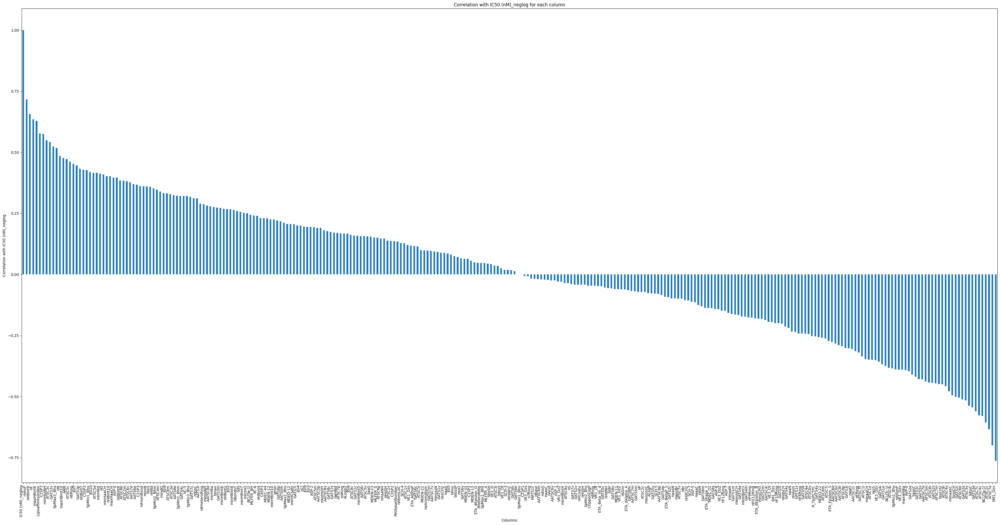

<Figure size 640x480 with 0 Axes>

In [95]:

plt.figure(figsize=(38, 20)) 
correlation_series.plot(kind="bar")
plt.xlabel("Columns")
plt.ylabel("Correlation with IC50 (nM)_neglog")
plt.title("Correlation with IC50 (nM)_neglog for each column")
plt.xticks(rotation=90, ha='right')


plt.tight_layout()
plt.show()
save_path = "C:/Users/aswin/Downloads/heatmap_parts3.pdf"
plt.savefig(save_path, format="pdf", dpi=300)

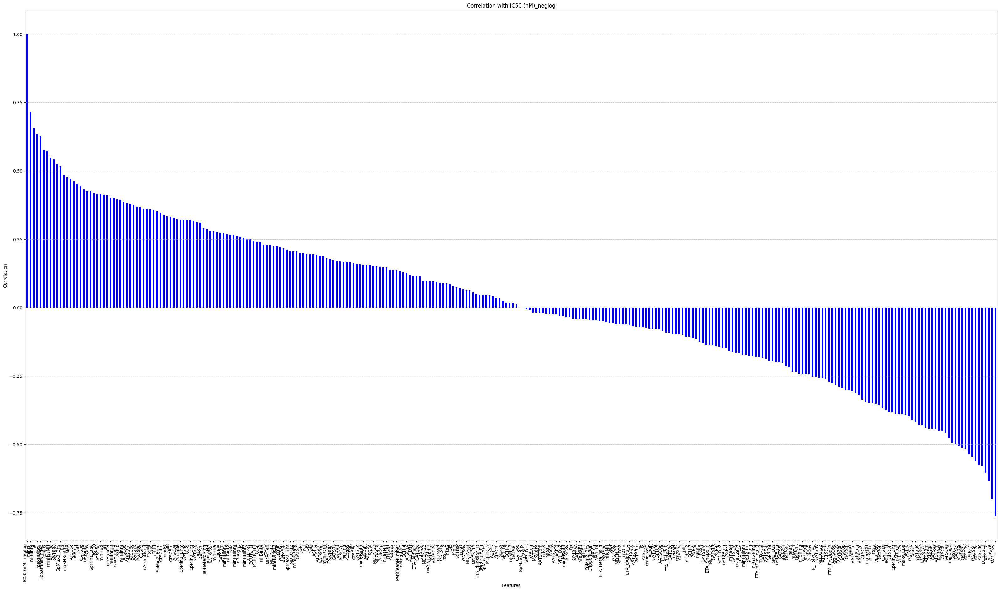

In [97]:
import pandas as pd
import matplotlib.pyplot as plt


correlations = corr_b.corrwith(corr_b["IC50 (nM)_neglog"]).sort_values(ascending=False)


plt.figure(figsize=(40, 22)) 
correlations.plot(kind='bar', color='blue')
plt.xlabel('Features')
plt.ylabel('Correlation')
plt.title('Correlation with IC50 (nM)_neglog')
plt.xticks(rotation=90, ha='right')  
plt.grid(axis='y', linestyle='--', alpha=0.7)


save_path4 = "C:/Users/aswin/Downloads/correlation_plot1.png"
plt.savefig(save_path4, dpi=300, bbox_inches='tight')


plt.show()


# Top 20 columns with high correlation

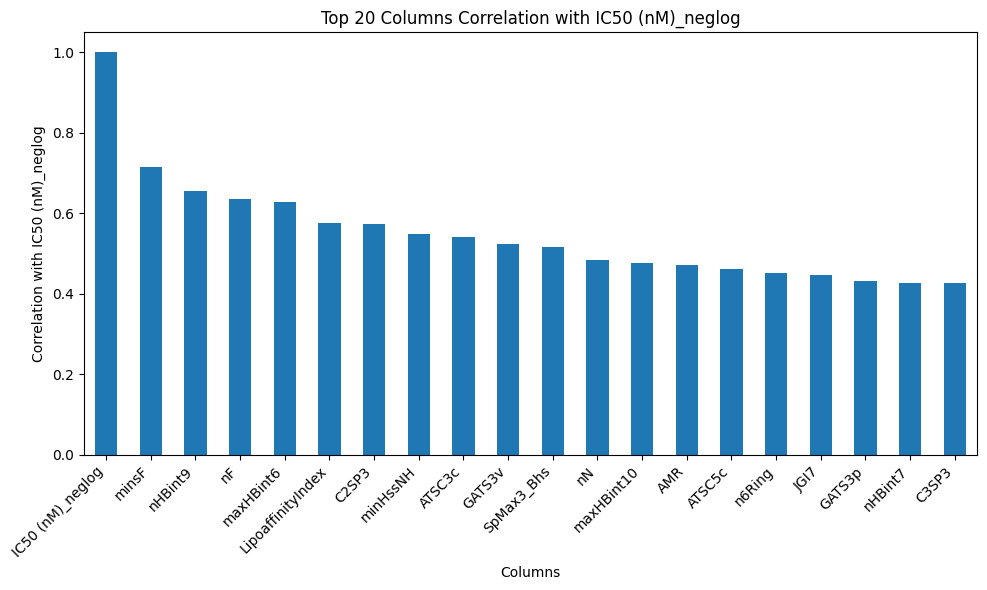

In [76]:
top_n = 20 
top_correlation_series = correlation_series.head(top_n)


plt.figure(figsize=(10, 6))
top_correlation_series.plot(kind="bar")
plt.xlabel("Columns")
plt.ylabel("Correlation with IC50 (nM)_neglog")
plt.title(f"Top {top_n} Columns Correlation with IC50 (nM)_neglog")
plt.xticks(rotation=45, ha='right')


plt.tight_layout()
plt.show()

In [32]:
import seaborn as sns

### scatterplot of minsf vs pic50

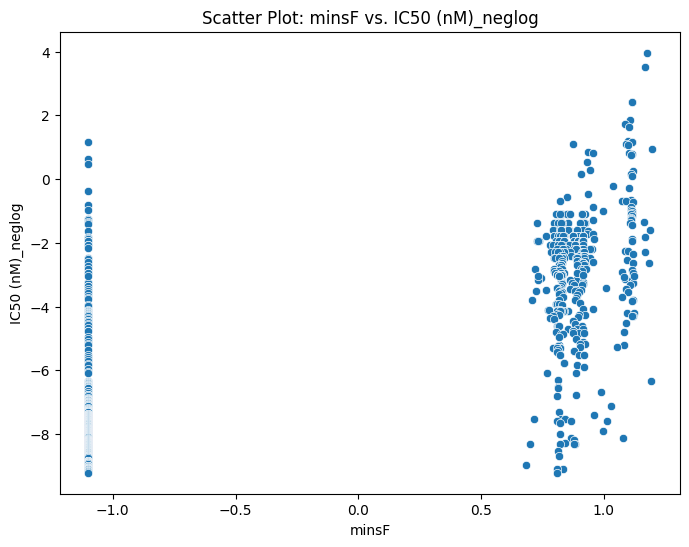

In [98]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


column_name = 'minsF'


plt.figure(figsize=(8, 6))
sns.scatterplot(data=corr_b, x=column_name, y='IC50 (nM)_neglog')
plt.xlabel(column_name)
plt.ylabel('IC50 (nM)_neglog')
plt.title(f'Scatter Plot: {column_name} vs. IC50 (nM)_neglog')
plt.show()


### Joint plot

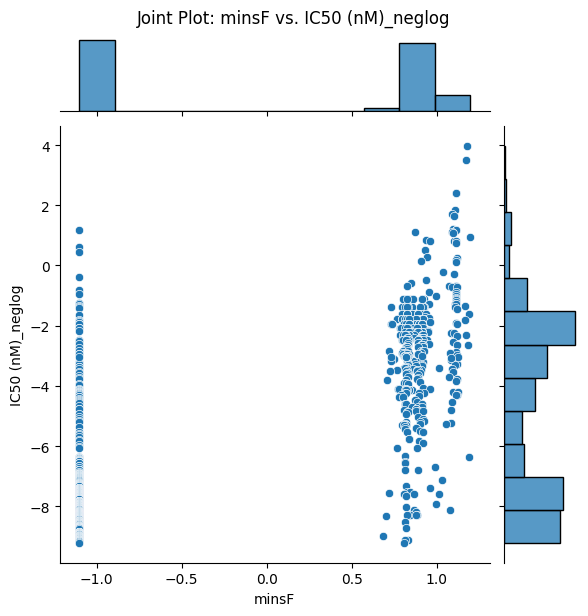

In [99]:

column_name = 'minsF'


sns.jointplot(data=corr_b, x=column_name, y='IC50 (nM)_neglog', kind='scatter')
plt.xlabel(column_name)
plt.ylabel('IC50 (nM)_neglog')
plt.suptitle(f'Joint Plot: {column_name} vs. IC50 (nM)_neglog', y=1.02)
plt.show()

## Heatmap

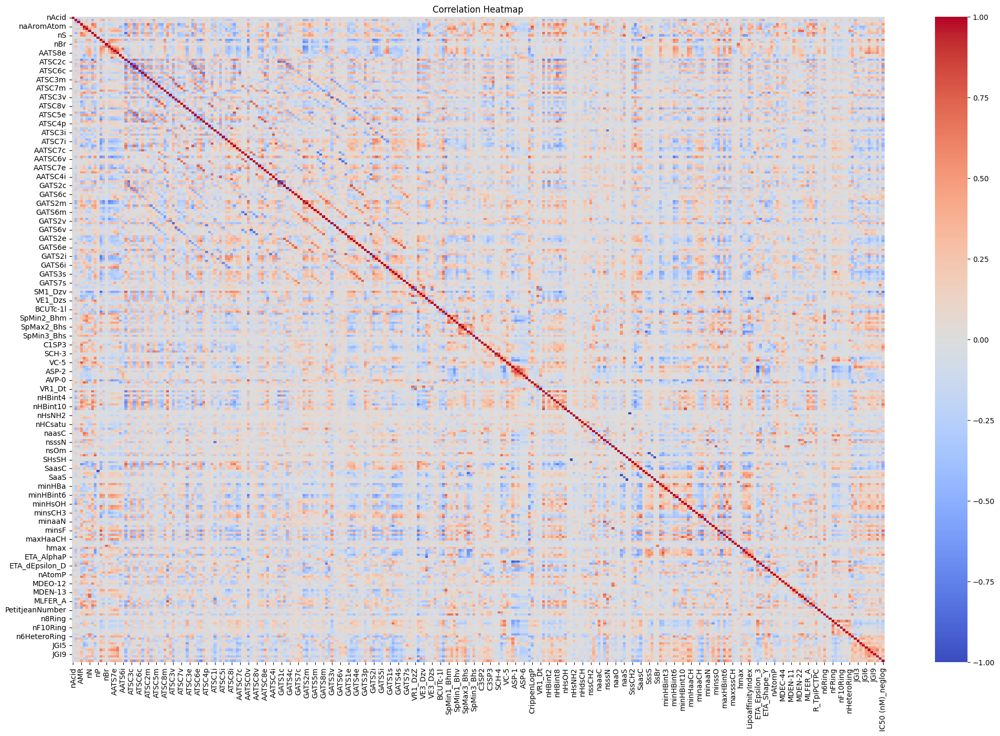

In [83]:

correlation_matrix = corr_b.corr()

plt.figure(figsize=(25, 16)) 
sns.heatmap(correlation_matrix, cmap="coolwarm", annot=False)
plt.title("Correlation Heatmap")
plt.show()

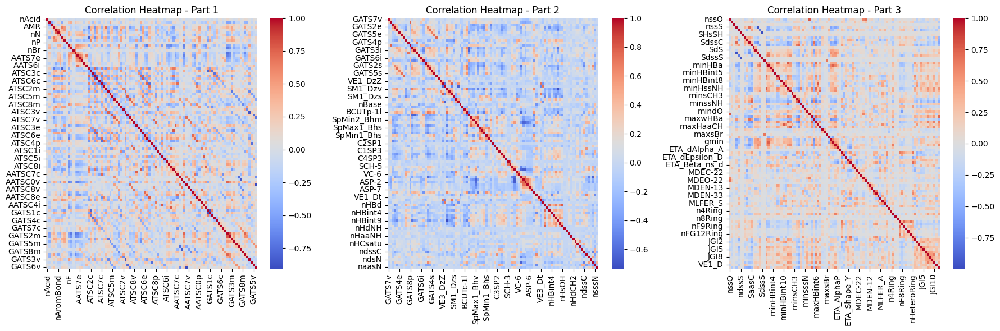

In [84]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

correlation_matrix = corr_b.corr()


num_columns = len(correlation_matrix.columns)
part_size = num_columns // 3
part_1_cols = correlation_matrix.columns[:part_size]
part_2_cols = correlation_matrix.columns[part_size:2 * part_size]
part_3_cols = correlation_matrix.columns[2 * part_size:]


correlation_matrix_part_1 = correlation_matrix.loc[part_1_cols, part_1_cols]
correlation_matrix_part_2 = correlation_matrix.loc[part_2_cols, part_2_cols]
correlation_matrix_part_3 = correlation_matrix.loc[part_3_cols, part_3_cols]

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

sns.heatmap(correlation_matrix_part_1, cmap="coolwarm", annot=False, ax=axes[0])
axes[0].set_title("Correlation Heatmap - Part 1")


sns.heatmap(correlation_matrix_part_2, cmap="coolwarm", annot=False, ax=axes[1])
axes[1].set_title("Correlation Heatmap - Part 2")


sns.heatmap(correlation_matrix_part_3, cmap="coolwarm", annot=False, ax=axes[2])
axes[2].set_title("Correlation Heatmap - Part 3")

plt.tight_layout()
plt.show()


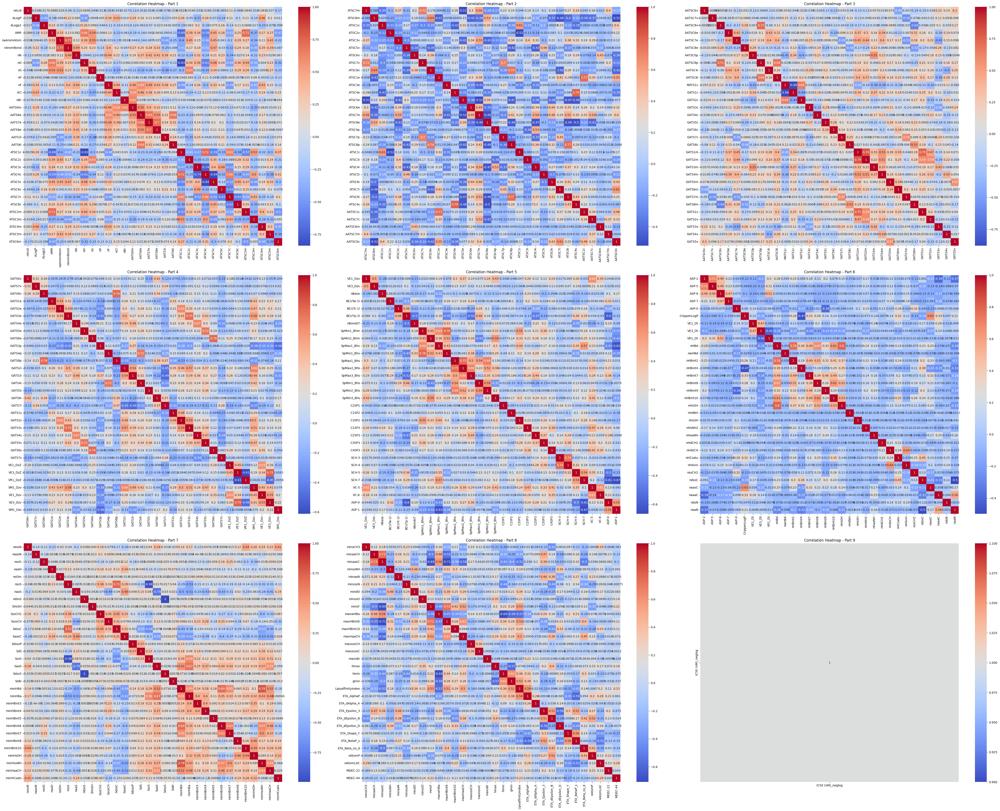

In [91]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt




correlation_matrix = corr_b.corr()

target_column = "IC50 (nM)_neglog"

remaining_columns = [col for col in correlation_matrix.columns if col != target_column]

num_parts = 9
part_size = len(remaining_columns) // num_parts

parts = [remaining_columns[i * part_size: (i + 1) * part_size] for i in range(num_parts - 1)]
parts.append([target_column])
parts.append(remaining_columns[(num_parts - 1) * part_size:])


correlation_matrices = [correlation_matrix.loc[part, part] for part in parts]


fig, axes = plt.subplots(3, 3, figsize=(48, 38))

for i in range(3):
    for j in range(3):
        sns.heatmap(correlation_matrices[i * 3 + j], cmap="coolwarm", annot=True, ax=axes[i, j])
        axes[i, j].set_title(f"Correlation Heatmap - Part {i * 3 + j + 1}")

plt.tight_layout()
plt.show()


In [92]:
plt.savefig("heatmap_parts.pdf", format="pdf", dpi=300)

<Figure size 640x480 with 0 Axes>

In [93]:
save_path = "C:/Users/aswin/Downloads/heatmap_parts.pdf"
plt.savefig(save_path, format="pdf", dpi=300)

<Figure size 640x480 with 0 Axes>

In [42]:
test=pd.read_csv(r"C:\Users\aswin\Downloads\cid_and_IC50.csv")

In [43]:
test

,cid,cmpdname,IC50 nm
0,441300,Abacavir,0.000801
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.000801
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.000801
3,46779835,Abacavir-d4,0.000801
4,10660866,"Abacavir, trans-",0.000801
...,...,...,...
277,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",0.002064
278,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,0.000524
279,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,0.000524
280,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",0.008686


# model building and evaluation

### evaluation is done seperately for both standardized and normalized data

In [33]:
from sklearn import metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
import numpy as np
import math
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
import numpy as np
import math
from sklearn.model_selection import train_test_split, cross_val_score

### splitting normalized  data

In [32]:
x = corr_a.drop(['IC50 (nM)_neglog'],axis=1)
y = corr_a['IC50 (nM)_neglog']
x.shape,y.shape

((799, 291), (799,))

In [33]:
X_train,X_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state = 50)

In [34]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(559, 291)
(559,)
(240, 291)
(240,)


In [35]:
reg_model = linear_model.LinearRegression()
regressor = RandomForestRegressor(n_estimators=100,
                                  random_state=0)
reg_model = LinearRegression().fit(X_train,y_train)
regressor.fit(X_train, y_train)

RandomForestRegressor(random_state=0)

In [36]:
#Predicting the Test and Train set result 
reg_ypred= reg_model.predict(X_test)  
reg_xpred= reg_model.predict(X_train)
rfr_ypred = regressor.predict(X_test)

#### comparison of liner and random forest regression with actual values

In [37]:
#Actual value and the predicted value
reg_model_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value - reg': reg_ypred,'Predicted value - rfr':rfr_ypred})
reg_model_diff

,Actual value,Predicted value - reg,Predicted value - rfr
344,-7.710653,-7.559209,-7.726264
29,-0.277632,0.638567,-1.135158
558,-9.075208,-5.787863,-7.832336
784,-2.960105,-1.335144,-1.584847
116,-4.084294,0.617641,-0.378335
...,...,...,...
52,-3.135494,-3.296042,-3.219250
611,-1.791759,-2.728618,-2.284867
314,-7.525101,-7.370907,-7.499343
54,-3.178054,-3.287432,-2.839149


In [38]:
reg_mae = metrics.mean_absolute_error(y_test, reg_ypred)
reg_mse = metrics.mean_squared_error(y_test, reg_ypred)
reg_r2 = np.sqrt(metrics.mean_squared_error(y_test, reg_ypred))
reg_R2=r2_score(y_test, reg_ypred)

rfr_mae = metrics.mean_absolute_error(y_test, rfr_ypred)
rfr_mse = metrics.mean_squared_error(y_test, rfr_ypred)
rfr_r2 = np.sqrt(metrics.mean_squared_error(y_test, rfr_ypred))
rfr_R2=r2_score(y_test, rfr_ypred)

In [39]:
model_eval = pd.DataFrame({'Model Name': ['linear regression','random forest regression'], 
                           'Mean Absolute Error': [reg_mae,rfr_mae],
                           'Mean Square Error':[reg_mse,rfr_mse],
                           'Root Mean Square Error':[reg_r2,rfr_r2],
                           'r2_score':[reg_R2,rfr_R2]})
model_eval

,Model Name,Mean Absolute Error,Mean Square Error,Root Mean Square Error,r2_score
0,linear regression,2.362459,176.869338,13.299223,-18.707185
1,random forest regression,0.991342,1.692406,1.300925,0.811428


In [40]:
print('Intercept: ',reg_model.intercept_)
print('Variance score: {}'.format(reg_model.score(X_test, y_test)))
print('Variance score: {}'.format(regressor.score(X_test, y_test)))

Intercept:  73.1126658808266
Variance score: -18.707185031783908
Variance score: 0.8114283025361629


In [51]:
def model(X,y):
    X_train,X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 50)
    print('Shape of train test split\n--------------------------------------------------------')
    print('X_train:',X_train.shape)
    print('y_train:',y_train.shape)
    print('X_test:',X_test.shape)
    print('X_test:',y_test.shape)
    
    
    # model
    reg_model = linear_model.LinearRegression()
    regressor = RandomForestRegressor(n_estimators=100,
                                  random_state=0)
    
    # fitting data to the model
    reg_model = LinearRegression().fit(X_train,y_train)
    regressor.fit(X_train, y_train)
    
    #Predicting the Test and Train set result 
    reg_ypred= reg_model.predict(X_test)  
    reg_xpred= reg_model.predict(X_train)
    rfr_ypred = regressor.predict(X_test)
    
    #Actual value and the predicted value
    reg_model_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value - reg': reg_ypred,'Predicted value - rfr':rfr_ypred})
    #reg_model_diff
    
    # model evaluation
       # Linear regression
    reg_mae = metrics.mean_absolute_error(y_test, reg_ypred)
    reg_mse = metrics.mean_squared_error(y_test, reg_ypred)
    reg_r2 = np.sqrt(metrics.mean_squared_error(y_test, reg_ypred))
    reg_R2=r2_score(y_test, reg_ypred)
       # Random forest regression
    rfr_mae = metrics.mean_absolute_error(y_test, rfr_ypred)
    rfr_mse = metrics.mean_squared_error(y_test, rfr_ypred)
    rfr_r2 = np.sqrt(metrics.mean_squared_error(y_test, rfr_ypred))
    rfr_R2=r2_score(y_test, rfr_ypred)
    
    
    model_eval = pd.DataFrame({'Model Name': ['linear regression','random forest regression'], 
                           'Mean Absolute Error': [reg_mae,rfr_mae],
                           'Mean Square Error':[reg_mse,rfr_mse],
                           'Root Mean Square Error':[reg_r2,rfr_r2],
                           'r2_score':[reg_R2,rfr_R2]})
    #model_eval
    
    return reg_model_diff,model_eval
    
    

In [149]:
model(x,y)

Shape of train test split
--------------------------------------------------------
X_train: (559, 291)
y_train: (559,)
X_test: (240, 291)
X_test: (240,)


(     Actual value  Predicted value - reg  Predicted value - rfr
 344     -7.710653              -7.559209              -7.726264
 29      -0.277632               0.638567              -1.135158
 558     -9.075208              -5.787863              -7.832336
 784     -2.960105              -1.335144              -1.584847
 116     -4.084294               0.617641              -0.378335
 ..            ...                    ...                    ...
 52      -3.135494              -3.296042              -3.219250
 611     -1.791759              -2.728618              -2.284867
 314     -7.525101              -7.370907              -7.499343
 54      -3.178054              -3.287432              -2.839149
 124     -4.127134              -4.749831              -3.818727
 
 [240 rows x 3 columns],
                  Model Name  Mean Absolute Error  Mean Square Error  \
 0         linear regression             2.362459         176.869338   
 1  random forest regression             0.991342

In [150]:
print("Model Evaluation Results:")
print(model_eval)

Model Evaluation Results:
                 Model Name  Mean Absolute Error  Mean Square Error  \
0         linear regression             2.362459         176.869338   
1  random forest regression             0.991342           1.692406   

   Root Mean Square Error   r2_score  
0               13.299223 -18.707185  
1                1.300925   0.811428  


In [37]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb
from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor


# ML model

# evaluation metrics

In [42]:


def model(x, y, model_name):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=50)
    model = None

    if model_name == 'linear regression':
        model = LinearRegression()
    elif model_name == 'decision tree':
        model = DecisionTreeRegressor(random_state=0)
    elif model_name == 'svr':
        model = SVR()
    elif model_name == 'gradient boosting':
        model = GradientBoostingRegressor(random_state=0)
    elif model_name == 'xgboost':
        model = xgb.XGBRegressor(random_state=0)
    elif model_name == 'lasso regression':
        model = Lasso()
    elif model_name == 'ridge regression':
        model = Ridge()
    elif model_name == 'elasticnet regression':
        model = ElasticNet()
    elif model_name == 'knn':
        model = KNeighborsRegressor()
    elif model_name == 'neural network regression':
        model = MLPRegressor(random_state=0)

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Model evaluation
    mae = metrics.mean_absolute_error(y_test, y_pred)
    mse = metrics.mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    model_eval = pd.DataFrame({
        'Model Name': [model_name],
        'Mean Absolute Error': [mae],
        'Mean Square Error': [mse],
        'r2_score': [r2]
    })

    return model_eval


model_names = ['linear regression', 'decision tree', 'svr', 'gradient boosting', 'xgboost',
               'lasso regression', 'ridge regression', 'elasticnet regression', 'knn',
               'neural network regression']

model_eval_results = []

for model_name in model_names:
    model_eval_results.append(model(x, y, model_name))

all_model_eval = pd.concat(model_eval_results, ignore_index=True)

print(all_model_eval)


                  Model Name  Mean Absolute Error  Mean Square Error  \
0          linear regression             2.362459         176.869338   
1              decision tree             1.140530           2.573913   
2                        svr             1.106208           2.066374   
3          gradient boosting             0.956663           1.572835   
4                    xgboost             1.094992           2.116061   
5           lasso regression             2.730544           9.035364   
6           ridge regression             1.049139           1.862154   
7      elasticnet regression             2.539062           7.925643   
8                        knn             0.969382           1.765753   
9  neural network regression             1.088507           1.969630   

    r2_score  
0 -18.707185  
1   0.713209  
2   0.769760  
3   0.824751  
4   0.764224  
5  -0.006741  
6   0.792515  
7   0.116907  
8   0.803256  
9   0.780539  


C:\Users\aswin\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


## prediction of accuracy ,mse,mae of normalized data

## now on the standardized data and the approach is to select best results

In [34]:
X=corr_b.drop(['IC50 (nM)_neglog'],axis=1)
Y = corr_b['IC50 (nM)_neglog']
X.shape,Y.shape

((799, 291), (799,))

In [35]:
def model(X,Y):
    X_train,X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 50)
    print('Shape of train test split\n--------------------------------------------------------')
    print('X_train:',X_train.shape)
    print('y_train:',y_train.shape)
    print('X_test:',X_test.shape)
    print('X_test:',y_test.shape)
    
    
    # model
    reg_model = linear_model.LinearRegression()
    regressor = RandomForestRegressor(n_estimators=100,
                                  random_state=0)
    
    # fitting data to the model
    reg_model = LinearRegression().fit(X_train,y_train)
    regressor.fit(X_train, y_train)
    
    #Predicting the Test and Train set result 
    reg_ypred= reg_model.predict(X_test)  
    reg_xpred= reg_model.predict(X_train)
    rfr_ypred = regressor.predict(X_test)
    
    #Actual value and the predicted value
    reg_model_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value - reg': reg_ypred,'Predicted value - rfr':rfr_ypred})
    #reg_model_diff
    
    # model evaluation
       # Linear regression
    reg_mae = metrics.mean_absolute_error(y_test, reg_ypred)
    reg_mse = metrics.mean_squared_error(y_test, reg_ypred)
    reg_r2 = np.sqrt(metrics.mean_squared_error(y_test, reg_ypred))
    reg_R2=r2_score(y_test, reg_ypred)
       # Random forest regression
    rfr_mae = metrics.mean_absolute_error(y_test, rfr_ypred)
    rfr_mse = metrics.mean_squared_error(y_test, rfr_ypred)
    rfr_r2 = np.sqrt(metrics.mean_squared_error(y_test, rfr_ypred))
    rfr_R2=r2_score(y_test, rfr_ypred)
    
    
    model_eval = pd.DataFrame({'Model Name': ['linear regression','random forest regression'], 
                           'Mean Absolute Error': [reg_mae,rfr_mae],
                           'Mean Square Error':[reg_mse,rfr_mse],
                           'Root Mean Square Error':[reg_r2,rfr_r2],
                           'r2_score':[reg_R2,rfr_R2]})
    #model_eval
    
    return reg_model_diff,model_eval
    
    

In [155]:
model(X,Y)

Shape of train test split
--------------------------------------------------------
X_train: (559, 291)
y_train: (559,)
X_test: (240, 291)
X_test: (240,)


(     Actual value  Predicted value - reg  Predicted value - rfr
 344     -7.710653              -7.559209              -7.732442
 29      -0.277632               0.638567              -1.080524
 558     -9.075208              -5.787863              -7.820424
 784     -2.960105              -1.335144              -1.665366
 116     -4.084294               0.617641              -0.502092
 ..            ...                    ...                    ...
 52      -3.135494              -3.296042              -3.310281
 611     -1.791759              -2.728618              -2.272691
 314     -7.525101              -7.370907              -7.582661
 54      -3.178054              -3.287432              -2.861962
 124     -4.127134              -4.749831              -3.753981
 
 [240 rows x 3 columns],
                  Model Name  Mean Absolute Error  Mean Square Error  \
 0         linear regression             2.362459         176.869338   
 1  random forest regression             0.989399

# prediction of R2 score ,MAE,MSE of the standardized data

In [38]:


def model(X, Y, model_name):
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=50)
    model = None

    if model_name == 'linear regression':
        model = LinearRegression()
    elif model_name == 'decision tree':
        model = DecisionTreeRegressor(random_state=0)
    elif model_name == 'svr':
        model = SVR()
    elif model_name == 'gradient boosting':
        model = GradientBoostingRegressor(random_state=0)
    elif model_name == 'xgboost':
        model = xgb.XGBRegressor(random_state=0)
    elif model_name == 'lasso regression':
        model = Lasso()
    elif model_name == 'ridge regression':
        model = Ridge()
    elif model_name == 'elasticnet regression':
        model = ElasticNet()
    elif model_name == 'knn':
        model = KNeighborsRegressor()
    elif model_name == 'neural network regression':
        model = MLPRegressor(random_state=0)

    model.fit(X_train, Y_train)
    Y_pred = model.predict(X_test)

    # Model evaluation
    mae = metrics.mean_absolute_error(Y_test, Y_pred)
    mse = metrics.mean_squared_error(Y_test, Y_pred)
    r2 = r2_score(Y_test, Y_pred)

    model_eval = pd.DataFrame({
        'Model Name': [model_name],
        'Mean Absolute Error': [mae],
        'Mean Square Error': [mse],
        'r2_score': [r2]
    })

    return model_eval


model_names = ['linear regression', 'decision tree', 'svr', 'gradient boosting', 'xgboost',
               'lasso regression', 'ridge regression', 'elasticnet regression', 'knn',
               'neural network regression']

model_eval_results = []

for model_name in model_names:
    model_eval_results.append(model(X, Y, model_name))

all_model_eval = pd.concat(model_eval_results, ignore_index=True)

print(all_model_eval)


                  Model Name  Mean Absolute Error  Mean Square Error  \
0          linear regression             2.362459         176.869338   
1              decision tree             1.166019           2.728619   
2                        svr             1.006178           1.767417   
3          gradient boosting             0.957129           1.572931   
4                    xgboost             1.090431           2.114026   
5           lasso regression             1.883339           4.734470   
6           ridge regression             1.240826           4.838017   
7      elasticnet regression             1.528884           3.305816   
8                        knn             0.963889           1.778770   
9  neural network regression             1.190628           2.988762   

    r2_score  
0 -18.707185  
1   0.695971  
2   0.803070  
3   0.824740  
4   0.764450  
5   0.472475  
6   0.460937  
7   0.631658  
8   0.801805  
9   0.666985  


C:\Users\aswin\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


# gradient boosting regression is chosen as it is having 0.82 R2-score

In [39]:
b=corr_b.drop(['IC50 (nM)_neglog'],axis=1)
d = corr_b['IC50 (nM)_neglog']

In [40]:
X_train,X_test, y_train, y_test = train_test_split(b, d, test_size = 0.3, random_state = 50)

In [41]:

gb_regressor = GradientBoostingRegressor(n_estimators=100, random_state=42)


gb_regressor.fit(X_train, y_train)


y_pred = gb_regressor.predict(X_test)


mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)

Mean Squared Error: 1.5691447514013086


## cross validation on the gradient boosting algorithm

### Cross-validation is a statistical technique used to assess how well a predictive model generalizes to an independent data set. It is commonly used to estimate the performance of a machine learning model on unseen data and to avoid overfitting.

Mean CV R-squared (Training set): 0.7768286311653443
Mean CV R-squared (Test set): 0.7606764149586984


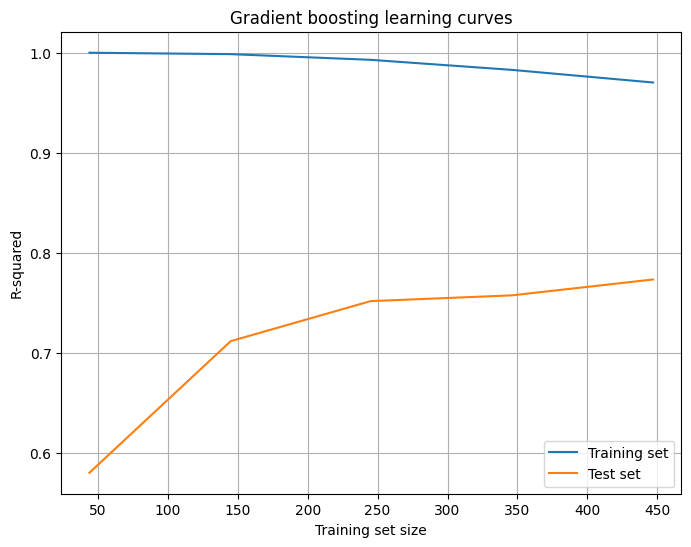

In [47]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt


X_train, X_test, y_train, y_test = train_test_split(b, d, test_size=0.3, random_state=50)

gb_regressor = GradientBoostingRegressor(n_estimators=100, random_state=42)



cv_scores_train = cross_val_score(gb_regressor, X_train, y_train, cv=5) 
cv_scores_test = cross_val_score(gb_regressor, X_test, y_test, cv=5)  
print("Mean CV R-squared (Training set):", np.mean(cv_scores_train))
print("Mean CV R-squared (Test set):", np.mean(cv_scores_test))


train_sizes, train_scores, test_scores = learning_curve(gb_regressor, X_train, y_train, cv=5, scoring='r2')
train_scores_mean = np.mean(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)

plt.figure(figsize=(8, 6))
plt.plot(train_sizes, train_scores_mean, label='Training set')
plt.plot(train_sizes, test_scores_mean, label='Test set')
plt.xlabel('Training set size')
plt.ylabel('R-squared')
plt.title('Gradient boosting learning curves')
plt.legend()
plt.grid()
plt.show()


### An R-squared of 0.7768 on the training set indicates that the model explains about 77.68% of the variance in the target variable during training, which is a reasonably high value. Similarly, an R-squared of 0.7607 on the test set suggests that the model is able to generalize well to unseen data, explaining approximately 76.07% of the variance.

In [60]:
r2 = r2_score(y_test, y_pred)

In [61]:
r2

0.8251623134389214

# saving the model

In [164]:
# Save the model to a file
gb = "trained_model.joblib"
joblib.dump(gb_regressor, gb)
print(f"Model saved to {gb}")

Model saved to trained_model.joblib


In [165]:
model_filename = "trained_model.joblib"
model = joblib.load(model_filename)





In [167]:
X_train.columns

Index(['nAcid', 'ALogP', 'ALogp2', 'AMR', 'naAromAtom', 'nAromBond', 'nN',
       'nO', 'nS', 'nP',
       ...
       'JGI2', 'JGI3', 'JGI4', 'JGI5', 'JGI6', 'JGI7', 'JGI8', 'JGI9', 'JGI10',
       'VE1_D'],
      dtype='object', length=291)

# after model saving we have to test 334 compounds and predict their IC50 values

# prediction of new test data of abacavir analogues

In [44]:
r=pd.read_csv(r"C:\Users\aswin\Downloads\PubChem_compound_cache_MHeXUaGhxB3zN8YuRFaPBAGC8OL2VDQ_Thovc1ULPXJVEgE.csv")

# the testing data have 334 compounds

In [45]:
r

,cid,cmpdname,cmpdsynonym,mw,mf,polararea,complexity,xlogp,heavycnt,hbonddonor,...,gpfamilycnt,neighbortype,meshheadings,annothits,annothitcnt,aids,cidcdate,sidsrcname,depcatg,annotation
0,441300,Abacavir,abacavir|136470-78-5|Ziagen|Abacavir sulfate|A...,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,7235,2D+3D,NaN,Biological Test Results|Chemical and Physical ...,12,880|1469|1471|1479|1487|1490|1688|1766|1768|25...,20040916,001Chemical|3B Scientific (Wuhan) Corp|3WAY PH...,Chemical Vendors|Curation Efforts|Governmental...,C254 - Anti-Infective Agent > C281 - Antiviral...
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,SCHEMBL8157177,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,3,2D+3D,NaN,Patents,1,NaN,20121201,SureChEMBL,Curation Efforts|Research and Development,NaN
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,SCHEMBL7395771,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,1,2D+3D,NaN,Patents,1,NaN,20121201,PATENTSCOPE (WIPO)|SureChEMBL,Curation Efforts|Governmental Organizations|Re...,NaN
3,46779835,Abacavir-d4,Abacavir-d4|1217731-56-0|1260619-56-4|rel-Abac...,290.36,C14H18N6O,102.0,414.0,0.9,21,3,...,0,2D+3D,NaN,Literature,1,NaN,20100726,A2B Chem|AA BLOCKS|AbaChemScene|Alsachim|Amadi...,Chemical Vendors|Legacy Depositors|Research an...,NaN
4,10660866,"Abacavir, trans-","Abacavir, trans-|trans-Abacavir|783292-37-5|6B...",286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,5,2D+3D,NaN,Classification|Literature|Patents|Pharmacology...,4,NaN,20061025,BenchChem|Biosynth|BOC Sciences|Chembase.cn|Ch...,Chemical Vendors|Curation Efforts|Governmental...,D000890 - Anti-Infective Agents > D000998 - An...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",SCHEMBL6553442,231.25,C11H13N5O,89.8,310.0,0.0,17,2,...,2,2D+3D,NaN,Patents,1,NaN,20061025,ChemSpider|NextBio|SureChEMBL|Thomson Pharma,Curation Efforts|Journal Publishers|Legacy Dep...,NaN
330,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,CHEMBL290878|SCHEMBL3836293|XCC-I-58|[2-(6-All...,272.31,C13H16N6O,102.0,400.0,0.2,20,3,...,1,2D+3D,NaN,Biological Test Results|Literature|Patents,3,3005|42122|46978|55954|55956|79098|82237|82240...,20050801,ABI Chem|ChEMBL|ChemSpider|DiscoveryGate|NextB...,Chemical Vendors|Curation Efforts|Governmental...,NaN
331,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,NaN,272.31,C13H16N6O,102.0,400.0,0.2,20,3,...,1,2D+3D,NaN,Patents,1,NaN,20050801,IBM,Research and Development,NaN
332,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...","LUCNVDPVGCJZJK-BQBZGAKWSA-|[(1R,4S)-4-(6-amino...",217.23,C10H11N5O,89.8,297.0,-0.1,16,2,...,0,2D+3D,NaN,Literature,2,NaN,20050801,ABI Chem|ChemTik|Japan Chemical Substance Dict...,Chemical Vendors|Curation Efforts|Governmental...,NaN


### the test data had 334 compounds and some have many null values so dropping them

In [170]:
combined_dataframe1[X_train.columns]

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,0,-2.2135000000000007,4.8995822500000035,73.2054,0,0,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.0709898651319078
1,0,-2.2135000000000007,4.8995822500000035,73.2054,0,0,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.0709898651319078
2,0,-2.2135000000000007,4.8995822500000035,73.2054,0,0,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.0709898651319078
3,0,-2.2135000000000007,4.8995822500000035,73.2054,0,0,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.07098986513190941
4,0,-2.2135000000000007,4.8995822500000035,73.2054,0,0,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.0709898651319078
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,0,-2.252100000000001,5.071954410000004,61.9167,0,0,5,1,0,0,...,0.07407407407407411,0.04600694444444445,0.04325396825396827,0.02289215686274511,0.01784057212628641,0.017750850340136053,0.014361300075585788,0.0078125,0.0,0.11568248401413583
330,0,-1.4686000000000003,2.156785960000001,73.7702,0,0,6,1,0,0,...,0.09126984126984128,0.0505952380952381,0.041831275720164623,0.02348888888888889,0.01882086167800454,0.01767165199413099,0.012598506480781611,0.008616622574955908,0.009132231404958679,0.09210895073304365
331,0,-1.4686000000000003,2.156785960000001,73.7702,0,0,6,1,0,0,...,0.09126984126984128,0.0505952380952381,0.041831275720164623,0.02348888888888889,0.01882086167800454,0.01767165199413099,0.012598506480781611,0.008616622574955908,0.009132231404958679,0.09210895073304365
332,0,-2.2481999999999998,5.054403239999999,59.30590000000001,0,0,5,1,0,0,...,0.09259259259259263,0.061342592592592594,0.04150793650793652,0.02257936507936508,0.01989280560709132,0.01707175925925926,0.01020408163265306,0.0,0.0,0.10812964462039065


In [177]:
test_data.dtypes

nAcid         object
ALogP         object
ALogp2        object
AMR           object
naAromAtom    object
               ...  
JGI7          object
JGI8          object
JGI9          object
JGI10         object
VE1_D         object
Length: 291, dtype: object

In [180]:



test_data1 = test_data.replace('', np.nan)


In [181]:

test_data1 = test_data1.apply(pd.to_numeric, errors='coerce')


In [182]:
contains_null = test_data1.isnull().any().any()


print("Does the DataFrame contain any null value?", contains_null)

Does the DataFrame contain any null value? True


In [183]:
test_data1.isnull().sum()

nAcid         0
ALogP         0
ALogp2        0
AMR           0
naAromAtom    0
             ..
JGI7          0
JGI8          0
JGI9          0
JGI10         0
VE1_D         0
Length: 291, dtype: int64

In [187]:
test_data2= test_data1.dropna()

In [234]:
test_data1.shape

(334, 291)

In [237]:
original_index = test_data1.index.tolist()

In [238]:
dropped_index = set(original_index) - set(test_data2.index)

In [239]:
dropped_index

{21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 32,
 33,
 35,
 98,
 99,
 146,
 147,
 250,
 264,
 265,
 291,
 292,
 293,
 294,
 295,
 296,
 297,
 298,
 299,
 300,
 301,
 302,
 303,
 304,
 305,
 306,
 307,
 308,
 309,
 310,
 311,
 312,
 313,
 314,
 315,
 316,
 317,
 318,
 319,
 320,
 323,
 325}

# of the given test data there are null values dropped them

# removing the dropped rows from the testing data based on index

In [243]:
test_data3 = r.drop(dropped_index)

In [245]:
test_data3

,cid,cmpdname,cmpdsynonym,mw,mf,polararea,complexity,xlogp,heavycnt,hbonddonor,...,gpfamilycnt,neighbortype,meshheadings,annothits,annothitcnt,aids,cidcdate,sidsrcname,depcatg,annotation
0,441300,Abacavir,abacavir|136470-78-5|Ziagen|Abacavir sulfate|A...,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,7235,2D+3D,NaN,Biological Test Results|Chemical and Physical ...,12,880|1469|1471|1479|1487|1490|1688|1766|1768|25...,20040916,001Chemical|3B Scientific (Wuhan) Corp|3WAY PH...,Chemical Vendors|Curation Efforts|Governmental...,C254 - Anti-Infective Agent > C281 - Antiviral...
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,SCHEMBL8157177,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,3,2D+3D,NaN,Patents,1,NaN,20121201,SureChEMBL,Curation Efforts|Research and Development,NaN
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,SCHEMBL7395771,286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,1,2D+3D,NaN,Patents,1,NaN,20121201,PATENTSCOPE (WIPO)|SureChEMBL,Curation Efforts|Governmental Organizations|Re...,NaN
3,46779835,Abacavir-d4,Abacavir-d4|1217731-56-0|1260619-56-4|rel-Abac...,290.36,C14H18N6O,102.0,414.0,0.9,21,3,...,0,2D+3D,NaN,Literature,1,NaN,20100726,A2B Chem|AA BLOCKS|AbaChemScene|Alsachim|Amadi...,Chemical Vendors|Legacy Depositors|Research an...,NaN
4,10660866,"Abacavir, trans-","Abacavir, trans-|trans-Abacavir|783292-37-5|6B...",286.33,C14H18N6O,102.0,414.0,0.9,21,3,...,5,2D+3D,NaN,Classification|Literature|Patents|Pharmacology...,4,NaN,20061025,BenchChem|Biosynth|BOC Sciences|Chembase.cn|Ch...,Chemical Vendors|Curation Efforts|Governmental...,D000890 - Anti-Infective Agents > D000998 - An...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",SCHEMBL6553442,231.25,C11H13N5O,89.8,310.0,0.0,17,2,...,2,2D+3D,NaN,Patents,1,NaN,20061025,ChemSpider|NextBio|SureChEMBL|Thomson Pharma,Curation Efforts|Journal Publishers|Legacy Dep...,NaN
330,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,CHEMBL290878|SCHEMBL3836293|XCC-I-58|[2-(6-All...,272.31,C13H16N6O,102.0,400.0,0.2,20,3,...,1,2D+3D,NaN,Biological Test Results|Literature|Patents,3,3005|42122|46978|55954|55956|79098|82237|82240...,20050801,ABI Chem|ChEMBL|ChemSpider|DiscoveryGate|NextB...,Chemical Vendors|Curation Efforts|Governmental...,NaN
331,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,NaN,272.31,C13H16N6O,102.0,400.0,0.2,20,3,...,1,2D+3D,NaN,Patents,1,NaN,20050801,IBM,Research and Development,NaN
332,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...","LUCNVDPVGCJZJK-BQBZGAKWSA-|[(1R,4S)-4-(6-amino...",217.23,C10H11N5O,89.8,297.0,-0.1,16,2,...,0,2D+3D,NaN,Literature,2,NaN,20050801,ABI Chem|ChemTik|Japan Chemical Substance Dict...,Chemical Vendors|Curation Efforts|Governmental...,NaN


# after droping Test data reduced to 282 rows from 334

In [246]:
cid=test_data3[["cid","cmpdname"]]

In [247]:
cid

,cid,cmpdname
0,441300,Abacavir
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...
3,46779835,Abacavir-d4
4,10660866,"Abacavir, trans-"
...,...,...
329,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1..."
330,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...
331,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...
332,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-..."


In [252]:
# extracting cid and compound name

In [248]:
cid["IC50 nm"]=formatted_predictions

C:\Users\aswin\AppData\Local\Temp\ipykernel_17472\2323525293.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cid["IC50 nm"]=formatted_predictions


In [250]:
output_path = 'C:/Users/aswin/Downloads/cid_and_IC50.csv'
cid.to_csv(output_path, index=False)


# Descriptor generation for the test data

It is done last on the notebook file

In [240]:
len(dropped_index)

52

# around 52 index are dropped

In [188]:
test_data2 = test_data2.astype('float64')

In [233]:
test_data2.shape

(282, 291)

In [186]:
for i in test_data1:
    print(i,'...',test_data1[i].isnull().sum())
    

nAcid ... 0
ALogP ... 0
ALogp2 ... 0
AMR ... 0
naAromAtom ... 0
nAromBond ... 0
nN ... 0
nO ... 0
nS ... 0
nP ... 0
nF ... 0
nCl ... 0
nBr ... 0
AATS0m ... 0
AATS6e ... 0
AATS7e ... 0
AATS8e ... 0
AATS3i ... 0
AATS6i ... 0
ATSC1c ... 0
ATSC2c ... 0
ATSC3c ... 0
ATSC4c ... 0
ATSC5c ... 0
ATSC6c ... 0
ATSC7c ... 0
ATSC8c ... 0
ATSC2m ... 0
ATSC3m ... 0
ATSC4m ... 0
ATSC5m ... 0
ATSC6m ... 0
ATSC7m ... 0
ATSC8m ... 0
ATSC1v ... 0
ATSC2v ... 0
ATSC3v ... 0
ATSC5v ... 0
ATSC6v ... 0
ATSC7v ... 0
ATSC8v ... 0
ATSC1e ... 0
ATSC3e ... 0
ATSC4e ... 0
ATSC5e ... 0
ATSC6e ... 0
ATSC7e ... 0
ATSC8e ... 0
ATSC4p ... 0
ATSC7p ... 0
ATSC8p ... 0
ATSC1i ... 0
ATSC3i ... 0
ATSC4i ... 0
ATSC5i ... 0
ATSC6i ... 0
ATSC7i ... 0
ATSC8i ... 0
ATSC4s ... 10
AATSC1c ... 0
AATSC7c ... 0
AATSC6m ... 0
AATSC7m ... 0
AATSC0v ... 0
AATSC6v ... 0
AATSC7v ... 0
AATSC8v ... 0
AATSC6e ... 0
AATSC7e ... 0
AATSC8e ... 0
AATSC0p ... 0
AATSC8p ... 0
AATSC4i ... 0
AATSC8i ... 0
MATS1c ... 0
GATS1c ... 0
GATS2c ... 0
GATS3c 

# the final test data of 282 compounds

In [189]:
test_data2

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,0.0,-2.2135,4.899582,73.2054,0.0,0.0,6.0,1.0,0.0,0.0,...,0.071181,0.043459,0.037014,0.023194,0.014084,0.016901,0.008659,0.006953,0.006667,0.070990
1,0.0,-2.2135,4.899582,73.2054,0.0,0.0,6.0,1.0,0.0,0.0,...,0.071181,0.043459,0.037014,0.023194,0.014084,0.016901,0.008659,0.006953,0.006667,0.070990
2,0.0,-2.2135,4.899582,73.2054,0.0,0.0,6.0,1.0,0.0,0.0,...,0.071181,0.043459,0.037014,0.023194,0.014084,0.016901,0.008659,0.006953,0.006667,0.070990
3,0.0,-2.2135,4.899582,73.2054,0.0,0.0,6.0,1.0,0.0,0.0,...,0.071181,0.043459,0.037014,0.023194,0.014084,0.016901,0.008659,0.006953,0.006667,0.070990
4,0.0,-2.2135,4.899582,73.2054,0.0,0.0,6.0,1.0,0.0,0.0,...,0.071181,0.043459,0.037014,0.023194,0.014084,0.016901,0.008659,0.006953,0.006667,0.070990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,0.0,-2.2521,5.071954,61.9167,0.0,0.0,5.0,1.0,0.0,0.0,...,0.074074,0.046007,0.043254,0.022892,0.017841,0.017751,0.014361,0.007812,0.000000,0.115682
330,0.0,-1.4686,2.156786,73.7702,0.0,0.0,6.0,1.0,0.0,0.0,...,0.091270,0.050595,0.041831,0.023489,0.018821,0.017672,0.012599,0.008617,0.009132,0.092109
331,0.0,-1.4686,2.156786,73.7702,0.0,0.0,6.0,1.0,0.0,0.0,...,0.091270,0.050595,0.041831,0.023489,0.018821,0.017672,0.012599,0.008617,0.009132,0.092109
332,0.0,-2.2482,5.054403,59.3059,0.0,0.0,5.0,1.0,0.0,0.0,...,0.092593,0.061343,0.041508,0.022579,0.019893,0.017072,0.010204,0.000000,0.000000,0.108130


#  standardizing test data

In [194]:

scaler = StandardScaler()


standardized_data = scaler.fit_transform(test_data2)

standardized_test = pd.DataFrame(standardized_data, columns=test_data2.columns)

In [195]:
standardized_test

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,-0.342101,-0.357703,0.191436,-0.550012,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,-0.362051,-0.704998,-0.554062,-0.531977,-1.109333,0.214631,-0.865374,-0.275918,0.156394,-0.343313
1,-0.342101,-0.357703,0.191436,-0.550012,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,-0.362051,-0.704998,-0.554062,-0.531977,-1.109333,0.214631,-0.865374,-0.275918,0.156394,-0.343313
2,-0.342101,-0.357703,0.191436,-0.550012,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,-0.362051,-0.704998,-0.554062,-0.531977,-1.109333,0.214631,-0.865374,-0.275918,0.156394,-0.343313
3,-0.342101,-0.357703,0.191436,-0.550012,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,-0.362051,-0.704998,-0.554062,-0.531977,-1.109333,0.214631,-0.865374,-0.275918,0.156394,-0.343313
4,-0.342101,-0.357703,0.191436,-0.550012,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,-0.362051,-0.704998,-0.554062,-0.531977,-1.109333,0.214631,-0.865374,-0.275918,0.156394,-0.343313
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,-0.342101,-0.411085,0.250861,-1.663821,0.0,0.0,-1.451711,-0.468767,-0.215952,-0.187014,...,-0.090596,-0.323168,1.025467,-0.622835,0.304905,0.528477,0.860302,0.067278,-1.420223,-0.243096
278,-0.342101,0.672449,-0.754140,-0.494285,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,1.522622,0.364366,0.665346,-0.443476,0.673908,0.499246,0.326790,0.388409,0.739481,-0.295957
279,-0.342101,0.672449,-0.754140,-0.494285,0.0,0.0,0.205708,-0.468767,-0.215952,-0.187014,...,1.522622,0.364366,0.665346,-0.443476,0.673908,0.499246,0.326790,0.388409,0.739481,-0.295957
280,-0.342101,-0.405691,0.244810,-1.921418,0.0,0.0,-1.451711,-0.468767,-0.215952,-0.187014,...,1.646716,1.974806,0.583501,-0.716850,1.077412,0.277836,-0.397886,-3.052685,-1.420223,-0.260033


# model Evaluation

In [196]:

predictions = model.predict(standardized_test)

# predicted PIC50 values

In [197]:
predictions

array([-7.12911416, -7.12911416, -7.12911416, -7.12911416, -7.12911416,
       -7.12911416, -7.12911416, -7.12911416, -7.12911416, -7.12911416,
       -6.94440885, -7.54335506, -6.94417065, -6.91430585, -6.94417065,
       -6.91430585, -6.94417065, -6.94417065, -6.91430585, -7.54335506,
       -7.54335506, -7.07174367, -7.16706585, -7.1856293 , -7.1856293 ,
       -7.40258117, -7.2932954 , -7.2932954 , -6.73183885, -7.38514042,
       -6.45074773, -7.21526671, -7.55991596, -7.55991596, -7.2863852 ,
       -7.19750851, -7.38591402, -7.38591402, -4.89327197, -6.95574914,
       -6.95574914, -7.50123462, -6.95574914, -7.61515201, -7.50496885,
       -4.89327197, -7.38591402, -7.21526671, -7.38591402, -7.61515201,
       -7.59825846, -7.50496885, -4.89327197, -7.21526671, -7.50123462,
       -7.50123462, -7.50496885, -7.32866124, -7.38591402, -7.59825846,
       -7.61515201, -7.32866124, -7.04807336, -7.5644103 , -7.40060024,
       -3.8168247 , -7.13059866, -7.13059866, -6.67206374, -7.04

In [198]:
original_data = np.exp(predictions)

# predicted IC50 values

In [199]:
original_data

array([8.01429008e-04, 8.01429008e-04, 8.01429008e-04, 8.01429008e-04,
       8.01429008e-04, 8.01429008e-04, 8.01429008e-04, 8.01429008e-04,
       8.01429008e-04, 8.01429008e-04, 9.64010040e-04, 5.29617738e-04,
       9.64239689e-04, 9.93470835e-04, 9.64239689e-04, 9.93470835e-04,
       9.64239689e-04, 9.64239689e-04, 9.93470835e-04, 5.29617738e-04,
       5.29617738e-04, 8.48751876e-04, 7.71583354e-04, 7.57392230e-04,
       7.57392230e-04, 6.09677047e-04, 6.80083210e-04, 6.80083210e-04,
       1.19233841e-03, 6.20403541e-04, 1.57934081e-03, 7.35274461e-04,
       5.20919022e-04, 5.20919022e-04, 6.84798997e-04, 7.48448240e-04,
       6.19923780e-04, 6.19923780e-04, 7.49685286e-03, 9.53139636e-04,
       9.53139636e-04, 5.52401944e-04, 9.53139636e-04, 4.92925748e-04,
       5.50342992e-04, 7.49685286e-03, 6.19923780e-04, 7.35274461e-04,
       6.19923780e-04, 4.92925748e-04, 5.01323750e-04, 5.50342992e-04,
       7.49685286e-03, 7.35274461e-04, 5.52401944e-04, 5.52401944e-04,
      

In [221]:

decimal_places = 8

# Round the values to the specified number of decimal places
rounded_predictions = np.around(original_data, decimals=decimal_places)


In [222]:
rounded_predictions

array([8.0143000e-04, 8.0143000e-04, 8.0143000e-04, 8.0143000e-04,
       8.0143000e-04, 8.0143000e-04, 8.0143000e-04, 8.0143000e-04,
       8.0143000e-04, 8.0143000e-04, 9.6401000e-04, 5.2962000e-04,
       9.6424000e-04, 9.9347000e-04, 9.6424000e-04, 9.9347000e-04,
       9.6424000e-04, 9.6424000e-04, 9.9347000e-04, 5.2962000e-04,
       5.2962000e-04, 8.4875000e-04, 7.7158000e-04, 7.5739000e-04,
       7.5739000e-04, 6.0968000e-04, 6.8008000e-04, 6.8008000e-04,
       1.1923400e-03, 6.2040000e-04, 1.5793400e-03, 7.3527000e-04,
       5.2092000e-04, 5.2092000e-04, 6.8480000e-04, 7.4845000e-04,
       6.1992000e-04, 6.1992000e-04, 7.4968500e-03, 9.5314000e-04,
       9.5314000e-04, 5.5240000e-04, 9.5314000e-04, 4.9293000e-04,
       5.5034000e-04, 7.4968500e-03, 6.1992000e-04, 7.3527000e-04,
       6.1992000e-04, 4.9293000e-04, 5.0132000e-04, 5.5034000e-04,
       7.4968500e-03, 7.3527000e-04, 5.5240000e-04, 5.5240000e-04,
       5.5034000e-04, 6.5645000e-04, 6.1992000e-04, 5.0132000e

In [223]:

original_predictions = np.exp(predictions)


decimal_places = 8

formatted_predictions = [f'{pred:.{decimal_places}f}' for pred in original_predictions]


# final predicted values on the test abacavir analogues

# results of test data

# predicted IC50 values

In [224]:
formatted_predictions

['0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00080143',
 '0.00096401',
 '0.00052962',
 '0.00096424',
 '0.00099347',
 '0.00096424',
 '0.00099347',
 '0.00096424',
 '0.00096424',
 '0.00099347',
 '0.00052962',
 '0.00052962',
 '0.00084875',
 '0.00077158',
 '0.00075739',
 '0.00075739',
 '0.00060968',
 '0.00068008',
 '0.00068008',
 '0.00119234',
 '0.00062040',
 '0.00157934',
 '0.00073527',
 '0.00052092',
 '0.00052092',
 '0.00068480',
 '0.00074845',
 '0.00061992',
 '0.00061992',
 '0.00749685',
 '0.00095314',
 '0.00095314',
 '0.00055240',
 '0.00095314',
 '0.00049293',
 '0.00055034',
 '0.00749685',
 '0.00061992',
 '0.00073527',
 '0.00061992',
 '0.00049293',
 '0.00050132',
 '0.00055034',
 '0.00749685',
 '0.00073527',
 '0.00055240',
 '0.00055240',
 '0.00055034',
 '0.00065645',
 '0.00061992',
 '0.00050132',
 '0.00049293',
 '0.00065645',
 '0.00086908',
 '0.00051858',
 '0.00061089',
 '0.02199754',
 '0.000800

In [225]:
sorted_predictions = sorted(formatted_predictions)

# sorted order of predicted values

In [226]:
sorted_predictions

['0.00013776',
 '0.00022969',
 '0.00022969',
 '0.00028334',
 '0.00035381',
 '0.00035381',
 '0.00035381',
 '0.00037414',
 '0.00040771',
 '0.00041190',
 '0.00043134',
 '0.00043173',
 '0.00048789',
 '0.00048789',
 '0.00049263',
 '0.00049293',
 '0.00049293',
 '0.00049293',
 '0.00049519',
 '0.00049920',
 '0.00049920',
 '0.00049920',
 '0.00049920',
 '0.00050132',
 '0.00050132',
 '0.00051858',
 '0.00052043',
 '0.00052043',
 '0.00052092',
 '0.00052092',
 '0.00052312',
 '0.00052431',
 '0.00052431',
 '0.00052962',
 '0.00052962',
 '0.00052962',
 '0.00053194',
 '0.00053194',
 '0.00055034',
 '0.00055034',
 '0.00055034',
 '0.00055240',
 '0.00055240',
 '0.00055240',
 '0.00057369',
 '0.00058868',
 '0.00059378',
 '0.00059995',
 '0.00060041',
 '0.00060968',
 '0.00061089',
 '0.00061089',
 '0.00061089',
 '0.00061992',
 '0.00061992',
 '0.00061992',
 '0.00061992',
 '0.00061992',
 '0.00062016',
 '0.00062040',
 '0.00064053',
 '0.00065465',
 '0.00065465',
 '0.00065465',
 '0.00065645',
 '0.00065645',
 '0.000661

# RESULT

In [230]:
sorted_predictions_float = [float(pred) for pred in sorted_predictions]

In [232]:
s=0
for i in sorted_predictions_float:
    if i < 0.00037:
        s=s+1
print(s)

7


# total 7 compounds under 0.00037

# final result by attatching the IC50 values to their corresponding CID's

In [253]:
cid

,cid,cmpdname,IC50 nm
0,441300,Abacavir,0.00080143
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.00080143
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.00080143
3,46779835,Abacavir-d4,0.00080143
4,10660866,"Abacavir, trans-",0.00080143
...,...,...,...
329,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",0.00206434
330,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,0.00052431
331,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,0.00052431
332,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",0.00868568


# this is the predicted result for 282 compounds

# end

### checking a compound outside data for an extra validation

In [200]:
t1= from_smiles(["C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C=C4)CO"], threads=8, timeout=600)
t1

[{'nAcid': '0',
  'ALogP': '-2.2135000000000007',
  'ALogp2': '4.8995822500000035',
  'AMR': '73.2054',
  'apol': '44.04427399999998',
  'naAromAtom': '9',
  'nAromBond': '10',
  'nAtom': '39',
  'nHeavyAtom': '21',
  'nH': '18',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3471.131140999999',
  'ATS1m': '4025.9096360000026',
  'ATS2m': '5672.706036000001',
  'ATS3m': '5616.401151000003',
  'ATS4m': '5777.223856000006',
  'ATS5m': '5114.319496000004',
  'ATS6m': '4518.24212',
  'ATS7m': '3209.421483000001',
  'ATS8m': '2157.3047909999987',
  'ATS0v': '8165.019840541816',
  'ATS1v': '10762.764779417712',
  'ATS2v': '15434.881053090072',
  'ATS3v': '15986.394173454048',
  'ATS4v': '15952.631301699505',
  'ATS5v': '15178.689513517298',
  'ATS6v': '13712.81540433837',
  'ATS7v': '10778.966538331404',
  'ATS8v': '8044.45263931157',
  'ATS0e': '301.06110799999993',
  'AT

In [201]:
tt=pd.DataFrame(t1)

In [202]:
tt

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,9,10,39,21,18,...,0.8375045432334032,0.13101095726949105,0.5532974474877222,0.37739518031669955,0.3064844551883225,19.057516213140957,50.92471577328823,93.89283225822689,0.7562568148501049,1.2371770829927444


In [203]:
tt=tt[X_train.columns]

In [204]:
tt

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,0,-2.2135000000000007,4.8995822500000035,73.2054,9,10,6,1,0,0,...,0.07118055555555557,0.04345878136200717,0.03701388888888889,0.023194444444444438,0.01408352229780802,0.016900510204081634,0.008659440207059254,0.006953125000000003,0.006666666666666668,0.0709898651319078


In [209]:

standardized_data = scaler.fit_transform(tt)


standardized_df = pd.DataFrame(standardized_data, columns=tt.columns)

In [210]:
standardized_df

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [211]:
pred = model.predict(standardized_df)

In [212]:
pred

array([-4.31395142])

In [213]:
true = np.exp(pred)

In [214]:
true

array([0.01338057])

# predicted value for the outside data

## value is  0.01338057

In [215]:
pre= model.predict(tt)

In [216]:
pre

array([-1.86313587])

In [219]:
t = np.exp(pre)

In [220]:
t

array([0.15518523])

In [207]:
stander= scaler.fit_transform(tt)


stand = pd.DataFrame(stander, columns=tt.columns)

In [208]:
stand

,nAcid,ALogP,ALogp2,AMR,naAromAtom,nAromBond,nN,nO,nS,nP,...,JGI2,JGI3,JGI4,JGI5,JGI6,JGI7,JGI8,JGI9,JGI10,VE1_D
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [173]:
test_data.shape

(334, 291)

In [174]:
X_train.shape

(559, 291)

# from now these are the code for descriptor generation of the given testing data

In [168]:
combined_dataframe1

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
1,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
2,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
3,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,0,-2.252100000000001,5.071954410000004,61.9167,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
330,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
331,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
332,0,-2.2481999999999998,5.054403239999999,59.30590000000001,31.236722999999994,0,0,27,16,11,...,,,,,,,,,,


In [176]:
corr_b["IC50 (nM)_neglog"].duplicated().sum()

293

In [172]:
for i in combined_dataframe1:
    print(combined_dataframe1[i].isnull().sum())

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


In [163]:
import joblib

In [38]:
dfk=pd.read_excel(r"C:\Users\aswin\Downloads\Prediction compounds abacavir analogs.xlsx")

In [39]:
dfk

,cmpdname,isosmiles
0,Abacavir,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C...
1,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4CC(C=C4)CO
2,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4CC(C=C4)CO
3,Abacavir-d4,[2H]C1(C(C1([2H])[2H])NC2=C3C(=NC(=N2)N)N(C=N3...
4,"Abacavir, trans-",C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@H](C=...
...,...,...
329,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",C1[C@H](C=C[C@H]1N2C=NC3=CN=C(N=C32)N)CO
330,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)/C=C\3/C[C@@H]3CO
331,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)C=C3C[C@@H]3CO
332,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",C1=C[C@@H]([C@@H]1CO)N2C=NC3=C(N=CN=C32)N


In [40]:
import pandas as pd
from padelpy import padeldescriptor


In [49]:
dfk

,cmpdname,isosmiles
0,Abacavir,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C...
1,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4CC(C=C4)CO
2,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4CC(C=C4)CO
3,Abacavir-d4,[2H]C1(C(C1([2H])[2H])NC2=C3C(=NC(=N2)N)N(C=N3...
4,"Abacavir, trans-",C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@H](C=...
...,...,...
329,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",C1[C@H](C=C[C@H]1N2C=NC3=CN=C(N=C32)N)CO
330,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)/C=C\3/C[C@@H]3CO
331,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)C=C3C[C@@H]3CO
332,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",C1=C[C@@H]([C@@H]1CO)N2C=NC3=C(N=CN=C32)N


In [51]:
l1=dfk['isosmiles'].to_list()

In [52]:
l1

['C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4CC(C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4CC(C=C4)CO',
 '[2H]C1(C(C1([2H])[2H])NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C=C4)CO)[2H]',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)C4C[C@@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4C[C@@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4C[C@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)C4C[C@H](C=C4)CO',
 'C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)C4CC(C=C4)CO',
 'C1CC1NC2=NC(=C3C(=N2)N(C=N3)[C@@H]4C[C@@H](C=C4)CO)N',
 'C1CC1NC2=C3C(=NC=N2)N(C=N3)C4CC(C=C4)CO',
 'C1CC1CNC2=C3C(=NC(=N2)N)N(C=N3)C4C[C@@H](C=C4)CO',
 'C1[C@@H](C=C[C@@H]1N2C=NC3=C(N=CN=C32)NC4CC4N)CO',
 'C1CC1CNC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C=C4)CO',
 'C1[C@@H](C=C[C@@H]1N2C=NC3=C(N=CN=C32)N[C@@H]4C[C@@H]4N)CO',
 'C1CC1CNC2=C3C(=NC(=N2)N)N(C=N3)C4CC(C=C4)CO',
 'C1CC1CNC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4C[C@H](C=C4)CO',
 'C1C(C=CC1N

In [69]:
desc_result1 = from_smiles(l1[0:11], threads=8, timeout=600)
desc_result1

[{'nAcid': '0',
  'ALogP': '-2.2135000000000007',
  'ALogp2': '4.8995822500000035',
  'AMR': '73.2054',
  'apol': '44.04427399999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '39',
  'nHeavyAtom': '21',
  'nH': '18',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3471.131140999999',
  'ATS1m': '4025.9096360000026',
  'ATS2m': '5672.706036000001',
  'ATS3m': '5616.401151000003',
  'ATS4m': '5777.223856000006',
  'ATS5m': '5114.319496000004',
  'ATS6m': '4518.24212',
  'ATS7m': '3209.421483000001',
  'ATS8m': '2157.3047909999987',
  'ATS0v': '8165.019840541816',
  'ATS1v': '10762.764779417712',
  'ATS2v': '15434.881053090072',
  'ATS3v': '15986.394173454048',
  'ATS4v': '15952.631301699505',
  'ATS5v': '15178.689513517298',
  'ATS6v': '13712.81540433837',
  'ATS7v': '10778.966538331404',
  'ATS8v': '8044.45263931157',
  'ATS0e': '301.06110799999993',
  'ATS

In [71]:
d1= pd.DataFrame(desc_result1)

In [72]:
d1

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
1,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
2,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
3,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
5,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
6,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
7,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
8,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
9,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,


In [75]:
for i in d1.columns:
    print(d1[i].isnull().sum())

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


In [77]:
d1["XLogP"]

0     -0.14100000000000007
1     -0.14100000000000007
2     -0.14100000000000007
3     -0.14100000000000007
4     -0.14100000000000007
5     -0.14100000000000007
6     -0.14100000000000007
7     -0.14100000000000007
8     -0.14100000000000007
9     -0.14100000000000007
10    -0.14100000000000001
Name: XLogP, dtype: object

In [78]:
desc_result2 = from_smiles(l1[11:21], threads=8, timeout=600)
desc_result2

[{'nAcid': '0',
  'ALogP': '-2.2895000000000003',
  'ALogp2': '5.241810250000001',
  'AMR': '72.0567',
  'apol': '42.27748099999999',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '37',
  'nHeavyAtom': '20',
  'nH': '17',
  'nB': '0',
  'nC': '14',
  'nN': '5',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3273.919027999999',
  'ATS1m': '3841.540535000003',
  'ATS2m': '5283.3218099999995',
  'ATS3m': '5247.662949000002',
  'ATS4m': '5208.5105290000065',
  'ATS5m': '4370.056144000006',
  'ATS6m': '3751.496420000003',
  'ATS7m': '2702.4854730000006',
  'ATS8m': '1912.3145699999982',
  'ATS0v': '7890.621922889202',
  'ATS1v': '10382.558664854925',
  'ATS2v': '14861.628079275986',
  'ATS3v': '15225.981944328476',
  'ATS4v': '14974.715074813777',
  'ATS5v': '13770.299858098404',
  'ATS6v': '11795.553516996917',
  'ATS7v': '8870.846597970734',
  'ATS8v': '6832.295126095553',
  'ATS0e': '284.141008',
  'AT

In [79]:
d2= pd.DataFrame(desc_result2)

In [80]:
d2

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2895000000000003,5.241810250000001,72.0567,42.27748099999999,0,0,37,20,17,...,,,,,,,,,,
1,0,-1.3703999999999987,1.8779961599999966,80.4029,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
2,0,-2.8018,7.85008324,76.76510000000002,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
3,0,-1.3703999999999987,1.8779961599999966,80.4029,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
4,0,-2.8018,7.85008324,76.76510000000002,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
5,0,-1.3703999999999987,1.8779961599999966,80.4029,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
6,0,-1.3703999999999987,1.8779961599999966,80.4029,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
7,0,-2.8018,7.85008324,76.76510000000002,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
8,0,-2.2895000000000003,5.241810250000001,72.0567,42.27748099999999,0,0,37,20,17,...,,,,,,,,,,
9,0,-2.2895000000000003,5.241810250000001,72.0567,42.27748099999999,0,0,37,20,17,...,,,,,,,,,,


In [82]:
desc_result3= from_smiles(l1[21:31], threads=8, timeout=600)
desc_result3

[{'nAcid': '0',
  'ALogP': '-2.2135000000000007',
  'ALogp2': '4.8995822500000035',
  'AMR': '73.2054',
  'apol': '48.47144599999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '44',
  'nHeavyAtom': '22',
  'nH': '22',
  'nB': '0',
  'nC': '15',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3619.459517999999',
  'ATS1m': '4074.3379880000025',
  'ATS2m': '5678.802420000004',
  'ATS3m': '5616.401151000003',
  'ATS4m': '5777.223856000006',
  'ATS5m': '5114.319496000004',
  'ATS6m': '4518.24212',
  'ATS7m': '3209.421483000001',
  'ATS8m': '2157.3047909999987',
  'ATS0v': '8712.871720014882',
  'ATS1v': '11221.711244899785',
  'ATS2v': '15621.383519675657',
  'ATS3v': '15986.394173454048',
  'ATS4v': '15952.631301699505',
  'ATS5v': '15178.689513517298',
  'ATS6v': '13712.81540433837',
  'ATS7v': '10778.966538331404',
  'ATS8v': '8044.45263931157',
  'ATS0e': '335.4754799999999',
  'ATS1

In [83]:
d3= pd.DataFrame(desc_result3)

In [84]:
d3

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2135000000000007,4.8995822500000035,73.2054,48.47144599999998,0,0,44,22,22,...,,,,,,,,,,
1,0,-2.2135000000000007,4.8995822500000035,73.2054,46.89106699999998,0,0,41,22,19,...,,,,,,,,,,
2,0,-2.2135000000000007,4.8995822500000035,73.2054,46.89106699999998,0,0,41,22,19,...,,,,,,,,,,
3,0,-2.2135000000000007,4.8995822500000035,73.2054,47.761066999999976,0,0,41,22,19,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,46.891066999999985,0,0,41,22,19,...,,,,,,,,,,
5,0,-1.6583999999999974,2.7502905599999914,83.31450000000001,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
6,0,-2.2135000000000007,4.8995822500000035,73.2054,49.026652999999975,0,0,44,23,21,...,,,,,,,,,,
7,0,-2.210699999999999,4.887194489999996,76.12870000000001,45.37106699999998,0,0,40,21,19,...,,,,,,,,,,
8,0,-2.210699999999999,4.887194489999996,76.12870000000001,45.37106699999998,0,0,40,21,19,...,,,,,,,,,,
9,0,-0.8680000000000005,0.753424000000001,78.84370000000001,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,


In [85]:
desc_result4= from_smiles(l1[31:41], threads=8, timeout=600)
desc_result4

[{'nAcid': '0',
  'ALogP': '-2.2135000000000007',
  'ALogp2': '4.8995822500000035',
  'AMR': '73.2054',
  'apol': '48.47144599999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '44',
  'nHeavyAtom': '22',
  'nH': '22',
  'nB': '0',
  'nC': '15',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3619.459517999999',
  'ATS1m': '4074.3379880000025',
  'ATS2m': '5678.802420000004',
  'ATS3m': '5616.401151000003',
  'ATS4m': '5777.223856000006',
  'ATS5m': '5114.319496000004',
  'ATS6m': '4518.24212',
  'ATS7m': '3209.421483000001',
  'ATS8m': '2157.3047909999987',
  'ATS0v': '8712.871720014882',
  'ATS1v': '11221.711244899785',
  'ATS2v': '15621.383519675657',
  'ATS3v': '15986.394173454048',
  'ATS4v': '15952.631301699505',
  'ATS5v': '15178.689513517298',
  'ATS6v': '13712.81540433837',
  'ATS7v': '10778.966538331404',
  'ATS8v': '8044.45263931157',
  'ATS0e': '335.4754799999999',
  'ATS1

In [86]:
d4= pd.DataFrame(desc_result4)

In [87]:
d4

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-1.3810999999999978,1.9074372099999939,84.9873,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
1,0,-2.2135000000000007,4.8995822500000035,73.2054,49.737859999999976,0,0,43,23,20,...,,,,,,,,,,
2,0,-2.2135000000000007,4.8995822500000035,73.2054,49.89665299999997,0,0,44,23,21,...,,,,,,,,,,
3,0,-1.2166000000000003,1.4801155600000009,76.8417,43.79068799999999,0,0,37,21,16,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,51.47785999999997,0,0,43,23,20,...,,,,,,,,,,
5,0,-0.8680000000000005,0.753424000000001,78.84370000000001,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
6,0,-0.8680000000000005,0.753424000000001,78.84370000000001,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
7,0,-1.5037000000000003,2.2611136900000006,78.49600000000001,42.71068799999999,0,0,37,21,16,...,,,,,,,,,,
8,0,-0.9212999999999985,0.8487936899999972,80.9234,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
9,0,-0.9212999999999985,0.8487936899999972,80.9234,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,


In [88]:
desc_result5= from_smiles(l1[41:61], threads=8, timeout=600)
desc_result5

[{'nAcid': '0',
  'ALogP': '-0.7722000000000009',
  'ALogp2': '0.5962928400000014',
  'AMR': '86.65180000000001',
  'apol': '48.72748099999999',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '39',
  'nHeavyAtom': '22',
  'nH': '17',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '1.0',
  'nX': '1.0',
  'ATS0m': '19574.859582980895',
  'ATS1m': '5538.052137170001',
  'ATS2m': '10209.13353951',
  'ATS3m': '11289.42198566999',
  'ATS4m': '7921.366636570006',
  'ATS5m': '8138.604498339999',
  'ATS6m': '9684.151973509992',
  'ATS7m': '6233.706485339995',
  'ATS8m': '7447.600356870004',
  'ATS0v': '9191.163374454454',
  'ATS1v': '11317.172109720057',
  'ATS2v': '17098.103043997104',
  'ATS3v': '18242.481962692244',
  'ATS4v': '16823.441818090054',
  'ATS5v': '16287.504174121992',
  'ATS6v': '15257.8605019706',
  'ATS7v': '11887.7811989361',
  'ATS8v': '9305.114310671037',
  'ATS0e': '302.059927999999

In [89]:
d5= pd.DataFrame(desc_result5)

In [90]:
d5

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-0.7722000000000009,0.5962928400000014,86.65180000000001,48.72748099999999,0,0,39,22,17,...,,,,,,,,,,
1,0,-1.8228999999999984,3.322964409999994,82.0912,48.47144599999998,0,0,44,22,22,...,,,,,,,,,,
2,0,-1.0025999999999977,1.0052067599999954,82.96430000000001,48.47144599999998,0,0,44,22,22,...,,,,,,,,,,
3,0,-1.202099999999999,1.4450444099999977,85.0642,48.89785999999998,0,0,43,23,20,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
5,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
6,0,-2.9718,8.83159524,72.912,44.711066999999986,0,0,40,21,19,...,,,,,,,,,,
7,0,-3.4862,12.153590440000002,75.60650000000003,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
8,0,-1.8121999999999976,3.2840688399999913,77.5068,45.377859999999984,0,0,41,21,20,...,,,,,,,,,,
9,0,-1.8121999999999976,3.2840688399999913,77.5068,45.377859999999984,0,0,41,21,20,...,,,,,,,,,,


In [91]:
desc_result6= from_smiles(l1[61:91], threads=8, timeout=600)
desc_result6

[{'nAcid': '0',
  'ALogP': '-1.8121999999999976',
  'ALogp2': '3.2840688399999913',
  'AMR': '77.5068',
  'apol': '45.37785999999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '41',
  'nHeavyAtom': '21',
  'nH': '20',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3473.1632689999988',
  'ATS1m': '3905.8596910000024',
  'ATS2m': '5653.792240000002',
  'ATS3m': '5675.720627000002',
  'ATS4m': '5669.5262590000075',
  'ATS5m': '4995.305775000003',
  'ATS6m': '4382.506311000004',
  'ATS7m': '3699.040914000001',
  'ATS8m': '2195.567294',
  'ATS0v': '8227.187329403678',
  'ATS1v': '10568.721110409419',
  'ATS2v': '15602.868365530245',
  'ATS3v': '16376.88961818091',
  'ATS4v': '16103.820597893671',
  'ATS5v': '15105.667519271694',
  'ATS6v': '13842.176243426085',
  'ATS7v': '11803.823623059528',
  'ATS8v': '8821.895671365812',
  'ATS0e': '314.4980359999999',
  'A

In [92]:
d6= pd.DataFrame(desc_result6)

In [93]:
d6

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-1.8121999999999976,3.2840688399999913,77.5068,45.37785999999998,0,0,41,21,20,...,,,,,,,,,,
1,0,-1.4848000000000001,2.20463104,69.68100000000001,39.19068799999999,0,0,35,19,16,...,,,,,,,,,,
2,0,-1.2344000000000008,1.523743360000002,73.9748,42.28427399999998,0,0,38,20,18,...,,,,,,,,,,
3,0,-2.100199999999998,4.410840039999991,80.4184,48.47144599999998,0,0,44,22,22,...,,,,,,,,,,
4,0,-1.3460999999999985,1.811985209999996,87.70009999999999,50.23823899999997,0,0,46,23,23,...,,,,,,,,,,
5,0,-1.202099999999999,1.4450444099999977,85.0642,48.89785999999998,0,0,43,23,20,...,,,,,,,,,,
6,0,-2.202099999999998,4.849244409999991,78.10210000000001,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
7,0,-2.202099999999998,4.849244409999991,78.10210000000001,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
8,0,-2.100199999999998,4.410840039999991,80.4184,48.47144599999998,0,0,44,22,22,...,,,,,,,,,,
9,0,-1.5348999999999988,2.3559180099999963,79.17960000000001,45.37785999999998,0,0,41,21,20,...,,,,,,,,,,


In [94]:
desc_result7= from_smiles(l1[91:121], threads=8, timeout=600)
desc_result7

[{'nAcid': '0',
  'ALogP': '-2.1073000000000004',
  'ALogp2': '4.4407132900000015',
  'AMR': '89.58519999999999',
  'apol': '57.75220399999996',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '53',
  'nHeavyAtom': '25',
  'nH': '28',
  'nB': '0',
  'nC': '18',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '4058.3482649999987',
  'ATS1m': '4579.772879',
  'ATS2m': '6571.654385000002',
  'ATS3m': '6188.077977000006',
  'ATS4m': '6162.6995220000135',
  'ATS5m': '5791.816500000004',
  'ATS6m': '5536.679333999996',
  'ATS7m': '4660.711114999998',
  'ATS8m': '2736.3325850000006',
  'ATS0v': '10169.92489184846',
  'ATS1v': '13180.681648370888',
  'ATS2v': '19407.448146471397',
  'ATS3v': '19222.097685713252',
  'ATS4v': '17874.342948436537',
  'ATS5v': '17251.025522485852',
  'ATS6v': '16855.714938684367',
  'ATS7v': '14817.820259189051',
  'ATS8v': '11082.446705322935',
  'ATS0e': '398.40781199

In [95]:
d7= pd.DataFrame(desc_result7)

In [96]:
d7

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.1073000000000004,4.4407132900000015,89.58519999999999,57.75220399999996,0,0,53,25,28,...,,,,,,,,,,
1,0,-2.7403000000000004,7.509244090000002,72.4504,44.84627399999998,0,0,40,22,18,...,,,,,,,,,,
2,0,-2.7430999999999983,7.524597609999991,83.1403,48.90465299999998,0,0,44,23,21,...,,,,,,,,,,
3,0,-2.7430999999999983,7.524597609999991,83.1403,48.90465299999998,0,0,44,23,21,...,,,,,,,,,,
4,0,-2.7430999999999983,7.524597609999991,83.1403,48.90465299999998,0,0,44,23,21,...,,,,,,,,,,
5,0,-1.3346999999999989,1.7814240899999971,92.59679999999999,53.33182499999997,0,0,49,24,25,...,,,,,,,,,,
6,0,-3.176199999999999,10.088246439999992,87.61970000000001,55.46061799999997,0,0,51,25,26,...,,,,,,,,,,
7,2,-2.871300000000001,8.244363690000005,86.40259999999999,54.33265299999997,0,0,48,27,21,...,,,,,,,,,,
8,2,-2.871300000000001,8.244363690000005,86.40259999999999,55.20265299999997,0,0,48,27,21,...,,,,,,,,,,
9,0,-1.794,3.218436,82.35589999999999,47.571066999999985,0,0,42,23,19,...,,,,,,,,,,


In [98]:
desc_result8= from_smiles(l1[121:131], threads=8, timeout=600)
desc_result8

[{'nAcid': '0',
  'ALogP': '-2.7894999999999985',
  'ALogp2': '7.781310249999992',
  'AMR': '79.02860000000001',
  'apol': '50.23144599999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '45',
  'nHeavyAtom': '23',
  'nH': '22',
  'nB': '0',
  'nC': '16',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3763.7236389999994',
  'ATS1m': '4362.86623',
  'ATS2m': '6492.915472999999',
  'ATS3m': '6178.933401000003',
  'ATS4m': '6162.6995220000135',
  'ATS5m': '5791.816500000004',
  'ATS6m': '5536.679333999996',
  'ATS7m': '4660.711114999998',
  'ATS8m': '2736.3325850000006',
  'ATS0v': '9136.388621764216',
  'ATS1v': '12068.745048398448',
  'ATS2v': '18532.52598166272',
  'ATS3v': '18942.34398583489',
  'ATS4v': '17874.342948436537',
  'ATS5v': '17251.025522485852',
  'ATS6v': '16855.714938684367',
  'ATS7v': '14817.820259189051',
  'ATS8v': '11082.446705322935',
  'ATS0e': '343.015995999999

In [99]:
d8= pd.DataFrame(desc_result8)

In [100]:
d8

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.7894999999999985,7.781310249999992,79.02860000000001,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
1,0,-1.6583999999999974,2.7502905599999914,83.31450000000001,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
2,0,-2.5349000000000004,6.4257180100000015,81.9358,46.98185999999998,0,0,43,23,20,...,,,,,,,,,,
3,0,-1.4733999999999994,2.170907559999998,74.5777,42.28427399999998,0,0,38,20,18,...,,,,,,,,,,
4,0,-1.4733999999999994,2.170907559999998,74.5777,42.28427399999998,0,0,38,20,18,...,,,,,,,,,,
5,0,-4.0417999999999985,16.33614723999999,95.10040000000001,62.61258299999996,0,0,58,27,31,...,,,,,,,,,,
6,0,-2.5349000000000004,6.4257180100000015,81.9358,46.98185999999998,0,0,43,23,20,...,,,,,,,,,,
7,0,-2.7894999999999985,7.781310249999992,79.02860000000001,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
8,0,-1.6583999999999974,2.7502905599999914,83.31450000000001,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
9,0,-1.9166000000000003,3.673355560000001,64.9064,36.09710199999999,0,0,32,18,14,...,,,,,,,,,,


In [101]:
desc_result9= from_smiles(l1[131:151], threads=8, timeout=600)
desc_result9

[{'nAcid': '2',
  'ALogP': '-2.871300000000001',
  'ALogp2': '8.244363690000005',
  'AMR': '86.40259999999999',
  'apol': '51.485859999999974',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '46',
  'nHeavyAtom': '26',
  'nH': '20',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '5',
  'nS': '1',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '5524.878873000008',
  'ATS1m': '6109.875380000002',
  'ATS2m': '7273.147002000003',
  'ATS3m': '5713.163103000005',
  'ATS4m': '5778.239920000006',
  'ATS5m': '5114.319496000004',
  'ATS6m': '4518.24212',
  'ATS7m': '3209.421483000001',
  'ATS8m': '2157.3047909999987',
  'ATS0v': '9689.527674027766',
  'ATS1v': '12364.218017551355',
  'ATS2v': '17005.62300641818',
  'ATS3v': '16478.47595720684',
  'ATS4v': '15983.715046130435',
  'ATS5v': '15178.689513517298',
  'ATS6v': '13712.81540433837',
  'ATS7v': '10778.966538331404',
  'ATS8v': '8044.45263931157',
  'ATS0e': '376.6487489999997',
 

In [102]:
d9= pd.DataFrame(desc_result9)

In [103]:
d9

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,2,-2.871300000000001,8.244363690000005,86.40259999999999,51.485859999999974,0,0,46,26,20,...,,,,,,,,,,
1,0,-1.4733999999999994,2.170907559999998,74.5777,42.28427399999998,0,0,38,20,18,...,,,,,,,,,,
2,0,-1.9926000000000004,3.9704547600000013,63.757700000000014,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
3,0,-1.9926000000000004,3.9704547600000013,63.757700000000014,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
4,0,-1.9166000000000003,3.673355560000001,64.9064,36.09710199999999,0,0,32,18,14,...,,,,,,,,,,
5,0,-1.9926000000000004,3.9704547600000013,63.757700000000014,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
6,0,-1.9166000000000003,3.673355560000001,64.9064,36.09710199999999,0,0,32,18,14,...,,,,,,,,,,
7,0,-1.1093999999999986,1.230768359999997,102.6422,56.03823899999997,0,0,48,25,23,...,,,,,,,,,,
8,0,-2.2780000000000005,5.1892840000000025,73.5342,45.09148099999998,0,0,39,22,17,...,,,,,,,,,,
9,0,-2.3639,5.58802321,77.00319999999999,43.88827399999998,0,0,40,22,18,...,,,,,,,,,,


In [104]:
desc_result10= from_smiles(l1[151:181], threads=8, timeout=600)
desc_result10

[{'nAcid': '0',
  'ALogP': '-1.8189000000000013',
  'ALogp2': '3.3083972100000048',
  'AMR': '63.57630000000001',
  'apol': '34.220515999999996',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '30',
  'nHeavyAtom': '18',
  'nH': '12',
  'nB': '0',
  'nC': '11',
  'nN': '5',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '1.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '1.0',
  'ATS0m': '3196.98566914977',
  'ATS1m': '3410.1764438352',
  'ATS2m': '5116.675327096002',
  'ATS3m': '5507.425017979201',
  'ATS4m': '4878.885526169599',
  'ATS5m': '3618.1341399312005',
  'ATS6m': '2860.0249106704005',
  'ATS7m': '2457.8872386704006',
  'ATS8m': '972.0025768511999',
  'ATS0v': '6641.696501168711',
  'ATS1v': '8463.37087772424',
  'ATS2v': '12891.954493143405',
  'ATS3v': '13548.350096276892',
  'ATS4v': '12453.368440961678',
  'ATS5v': '9936.898209592457',
  'ATS6v': '7775.241870143901',
  'ATS7v': '5952.563824368282',
  'ATS8v': '3282.5961764329645',
  'ATS0e': '243.927140000

In [105]:
d10= pd.DataFrame(desc_result10)

In [106]:
d10

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-1.8189000000000013,3.3083972100000048,63.57630000000001,34.220515999999996,0,0,30,18,12,...,,,,,,,,,,
1,0,-1.5545999999999984,2.4167811599999953,82.2504,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
2,0,-1.9427999999999992,3.774471839999997,75.52029999999999,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
3,0,-1.9427999999999992,3.774471839999997,75.52029999999999,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
4,0,-3.390799999999999,11.497524639999995,75.84620000000001,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
5,0,-2.327099999999999,5.415394409999995,83.5713,49.69985999999997,0,0,44,24,20,...,,,,,,,,,,
6,0,-1.7055000000000002,2.908730250000001,81.2009,47.56427399999998,0,0,41,23,18,...,,,,,,,,,,
7,0,-1.7055000000000002,2.908730250000001,81.2009,47.56427399999998,0,0,41,23,18,...,,,,,,,,,,
8,0,-2.8024999999999993,7.854006249999996,72.2865,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
9,0,-1.2076999999999998,1.4585392899999994,79.73370000000001,45.377859999999984,0,0,41,21,20,...,,,,,,,,,,


In [107]:
desc_result11= from_smiles(l1[181:211], threads=8, timeout=600)
desc_result11

[{'nAcid': '0',
  'ALogP': '-3.6535000000000015',
  'ALogp2': '13.34806225000001',
  'AMR': '87.76339999999999',
  'apol': '59.51220399999996',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '54',
  'nHeavyAtom': '26',
  'nH': '28',
  'nB': '0',
  'nC': '19',
  'nN': '6',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '4202.612386000011',
  'ATS1m': '4868.301120999999',
  'ATS2m': '7074.041084000001',
  'ATS3m': '7490.524193000009',
  'ATS4m': '7451.6375680000165',
  'ATS5m': '6539.329331000014',
  'ATS6m': '6413.010554999996',
  'ATS7m': '6017.896830999991',
  'ATS8m': '4696.840824000002',
  'ATS0v': '10593.441793597789',
  'ATS1v': '14027.715451869548',
  'ATS2v': '21273.167316649706',
  'ATS3v': '24080.32352944689',
  'ATS4v': '24025.534741984673',
  'ATS5v': '21587.801729083883',
  'ATS6v': '20075.40923760702',
  'ATS7v': '18996.88779801932',
  'ATS8v': '16692.75019335358',
  'ATS0e': '405.94832799

In [108]:
d11= pd.DataFrame(desc_result11)

In [109]:
d11

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-3.6535000000000015,13.34806225000001,87.76339999999999,59.51220399999996,0,0,54,26,28,...,,,,,,,,,,
1,0,-0.8737000000000021,0.7633516900000037,91.76039999999999,56.418617999999974,0,0,51,25,26,...,,,,,,,,,,
2,0,-2.5349000000000004,6.4257180100000015,81.9358,46.98185999999998,0,0,43,23,20,...,,,,,,,,,,
3,0,-2.5187999999999993,6.344353439999996,81.3435,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
4,0,-2.3158999999999996,5.363392809999998,83.35810000000002,47.13785999999998,0,0,42,22,20,...,,,,,,,,,,
5,0,-1.6027000000000011,2.5686472900000035,93.23349999999998,55.88703199999997,0,0,50,26,24,...,,,,,,,,,,
6,1,-3.404999999999998,11.594024999999986,89.2088,53.60223899999997,0,0,49,26,23,...,,,,,,,,,,
7,0,-2.501499999999999,6.2575022499999955,76.117,47.137859999999975,0,0,42,22,20,...,,,,,,,,,,
8,0,-2.0828,4.338055840000001,63.88550000000001,34.220515999999996,0,0,30,18,12,...,,,,,,,,,,
9,1,-2.2623000000000006,5.118001290000003,82.91040000000001,49.350273999999985,0,0,43,25,18,...,,,,,,,,,,


In [110]:
desc_result12= from_smiles(l1[211:241], threads=8, timeout=600)
desc_result12

[{'nAcid': '2',
  'ALogP': '-2.0934000000000004',
  'ALogp2': '4.3823235600000015',
  'AMR': '79.6841',
  'apol': '45.89348099999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '40',
  'nHeavyAtom': '23',
  'nH': '17',
  'nB': '0',
  'nC': '12',
  'nN': '6',
  'nO': '4',
  'nS': '0',
  'nP': '1',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '4908.864770432651',
  'ATS1m': '5447.723503096001',
  'ATS2m': '7131.393656718',
  'ATS3m': '6513.202631478007',
  'ATS4m': '6590.019710716006',
  'ATS5m': '6587.148959098',
  'ATS6m': '6672.721253383998',
  'ATS7m': '5781.279848670004',
  'ATS8m': '3126.479920859999',
  'ATS0v': '8532.851860271952',
  'ATS1v': '10892.838720040148',
  'ATS2v': '16184.588876382804',
  'ATS3v': '16836.092577626645',
  'ATS4v': '16449.373203718722',
  'ATS5v': '15626.964814194334',
  'ATS6v': '14603.661665208045',
  'ATS7v': '12466.482728351495',
  'ATS8v': '9088.77299000243',
  'ATS0e': '325.64198499999986',
  'ATS

In [111]:
d12= pd.DataFrame(desc_result12)

In [112]:
d12

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,2,-2.0934000000000004,4.3823235600000015,79.6841,45.89348099999998,0,0,40,23,17,...,,,,,,,,,,
1,2,-2.0934000000000004,4.3823235600000015,79.6841,45.89348099999998,0,0,40,23,17,...,,,,,,,,,,
2,0,-0.7405999999999984,0.5484883599999976,86.2334,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
3,0,-2.4299,5.90441401,68.28840000000001,37.42389499999999,0,0,33,18,15,...,,,,,,,,,,
4,0,-1.3602999999999994,1.8504160899999984,84.5761,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
5,0,-1.764800000000001,3.114519040000004,82.4289,46.23748099999999,0,0,40,23,17,...,,,,,,,,,,
6,0,-0.7405999999999984,0.5484883599999976,86.2334,50.23144599999998,0,0,45,23,22,...,,,,,,,,,,
7,0,-1.2548999999999995,1.5747740099999987,87.4906,51.88165299999998,0,0,46,25,21,...,,,,,,,,,,
8,0,-2.4299,5.90441401,68.28840000000001,37.423894999999995,0,0,33,18,15,...,,,,,,,,,,
9,0,0.24690000000000034,0.06095961000000017,89.5984,60.03861799999997,0,0,51,25,26,...,,,,,,,,,,


In [114]:
desc_result13= from_smiles(l1[241:261], threads=8, timeout=600)
desc_result13

[{'nAcid': '0',
  'ALogP': '-2.745100000000001',
  'ALogp2': '7.535574010000007',
  'AMR': '70.33050000000001',
  'apol': '42.27748099999999',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '37',
  'nHeavyAtom': '20',
  'nH': '17',
  'nB': '0',
  'nC': '14',
  'nN': '5',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3273.919027999999',
  'ATS1m': '3841.540535000001',
  'ATS2m': '4949.633467999998',
  'ATS3m': '5058.989372000004',
  'ATS4m': '4898.023323000008',
  'ATS5m': '4353.9220960000075',
  'ATS6m': '3885.6855810000043',
  'ATS7m': '2847.7656580000025',
  'ATS8m': '1978.4205939999983',
  'ATS0v': '7890.621922889202',
  'ATS1v': '10382.558664854927',
  'ATS2v': '13890.940866614597',
  'ATS3v': '14389.461098683649',
  'ATS4v': '14258.264960599401',
  'ATS5v': '13655.256514530778',
  'ATS6v': '12166.501291237597',
  'ATS7v': '9325.447244150997',
  'ATS8v': '6850.128711679969',
  'ATS0e': '284.14100

In [115]:
d13= pd.DataFrame(desc_result13)

In [116]:
d13

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.745100000000001,7.535574010000007,70.33050000000001,42.27748099999999,0,0,37,20,17,...,,,,,,,,,,
1,0,-2.1098000000000003,4.451256040000001,65.32000000000001,36.09710199999999,0,0,32,18,14,...,,,,,,,,,,
2,0,-2.1858000000000004,4.777721640000002,64.17130000000002,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
3,0,-0.6811000000000005,0.46389721000000067,66.8206,35.843515999999994,0,0,30,18,12,...,,,,,,,,,,
4,0,-0.6811000000000005,0.46389721000000067,66.8206,35.843515999999994,0,0,30,18,12,...,,,,,,,,,,
5,0,-2.8489999999999993,8.116800999999995,88.17380000000001,55.46061799999997,0,0,51,25,26,...,,,,,,,,,,
6,1,-1.8432000000000004,3.3973862400000017,73.9667,43.51268799999999,0,0,38,22,16,...,,,,,,,,,,
7,0,-2.1046999999999985,4.429762089999993,74.2987,45.377859999999984,0,0,41,21,20,...,,,,,,,,,,
8,2,-2.623499999999998,6.8827522499999905,96.7424,58.29303199999996,0,0,53,29,24,...,,,,,,,,,,
9,0,-2.5187999999999993,6.344353439999996,81.3435,55.92503199999997,0,0,49,25,24,...,,,,,,,,,,


In [117]:
desc_result14= from_smiles(l1[261:291], threads=8, timeout=600)
desc_result14

[{'nAcid': '3',
  'ALogP': '-2.429100000000001',
  'ALogp2': '5.900526810000004',
  'AMR': '94.0908',
  'apol': '57.44985999999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '49',
  'nHeavyAtom': '29',
  'nH': '20',
  'nB': '0',
  'nC': '14',
  'nN': '6',
  'nO': '7',
  'nS': '0',
  'nP': '2',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '6927.719139865297',
  'ATS1m': '8022.5573659040065',
  'ATS2m': '10157.279404102637',
  'ATS3m': '9731.66109900199',
  'ATS4m': '9983.046470529982',
  'ATS5m': '8296.381475625998',
  'ATS6m': '7796.514112386003',
  'ATS7m': '6792.937025816005',
  'ATS8m': '6400.904951672007',
  'ATS0v': '10719.086464723125',
  'ATS1v': '13801.643994434065',
  'ATS2v': '19424.94468544045',
  'ATS3v': '20387.0752580134',
  'ATS4v': '21238.689804279453',
  'ATS5v': '20930.804720965847',
  'ATS6v': '19865.777755454015',
  'ATS7v': '16888.446410587214',
  'ATS8v': '14820.328631499935',
  'ATS0e': '407.25878199999966',
 

In [118]:
d14= pd.DataFrame(desc_result14)

In [119]:
d14

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,3,-2.429100000000001,5.900526810000004,94.0908,57.44985999999998,0,0,49,29,20,...,,,,,,,,,,
1,1,-2.0287000000000006,4.115623690000002,75.7656,42.55468799999999,0,0,38,22,16,...,,,,,,,,,,
2,0,-1.9302000000000001,3.7256720400000005,68.62310000000001,37.42389499999999,0,0,33,18,15,...,,,,,,,,,,
3,0,-2.5187999999999993,6.344353439999996,81.3435,55.92503199999997,0,0,49,25,24,...,,,,,,,,,,
4,0,-2.5187999999999993,6.344353439999996,81.3435,55.92503199999997,0,0,49,25,24,...,,,,,,,,,,
5,2,-2.623499999999998,6.8827522499999905,96.7424,58.29303199999997,0,0,53,29,24,...,,,,,,,,,,
6,0,-2.513000000000001,6.315169000000004,67.5481,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
7,0,-0.6811000000000005,0.46389721000000067,66.8206,35.843515999999994,0,0,30,18,12,...,,,,,,,,,,
8,4,-2.7089000000000008,7.338139210000004,104.67689999999999,64.15265299999999,0,0,54,33,21,...,,,,,,,,,,
9,2,-2.623499999999998,6.8827522499999905,96.7424,58.29303199999996,0,0,53,29,24,...,,,,,,,,,,


In [121]:
desc_result15= from_smiles(l1[291:321], threads=8, timeout=600)
desc_result15

[{'nAcid': '0',
  'ALogP': '-1.3478999999999997',
  'ALogp2': '1.8168344099999991',
  'AMR': '86.92989999999998',
  'apol': '49.33106699999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '43',
  'nHeavyAtom': '24',
  'nH': '19',
  'nB': '0',
  'nC': '16',
  'nN': '7',
  'nO': '1',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3956.8714959999993',
  'ATS1m': '4516.745031000002',
  'ATS2m': '6667.424803000001',
  'ATS3m': '6800.338604999997',
  'ATS4m': '6551.512444000005',
  'ATS5m': '6091.726130000003',
  'ATS6m': '5401.398908999994',
  'ATS7m': '5077.478607000005',
  'ATS8m': '3450.7159610000026',
  'ATS0v': '9286.451561693104',
  'ATS1v': '11970.809501271566',
  'ATS2v': '18179.96604147744',
  'ATS3v': '19607.34082964576',
  'ATS4v': '18538.88536303624',
  'ATS5v': '17318.340086806475',
  'ATS6v': '16252.675350469579',
  'ATS7v': '14441.625463569871',
  'ATS8v': '11614.232764617514',
  'ATS0e': '333.062239

In [122]:
d15= pd.DataFrame(desc_result15)

In [123]:
d15

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-1.3478999999999997,1.8168344099999991,86.92989999999998,49.33106699999998,0,0,43,24,19,...,,,,,,,,,,
1,0,-4.427000000000001,19.598329000000014,146.4108,88.08854799999995,0,0,78,42,36,...,,,,,,,,,,
2,0,-1.8707000000000003,3.499518490000001,63.72410000000001,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
3,0,-2.2911000000000015,5.249139210000007,72.5935,42.27748099999999,0,0,37,20,17,...,,,,,,,,,,
4,0,-0.6811000000000005,0.46389721000000067,66.8206,37.97910199999999,0,0,33,19,14,...,,,,,,,,,,
5,0,-0.6811000000000005,0.46389721000000067,66.8206,38.69030899999999,0,0,32,19,13,...,,,,,,,,,,
6,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
7,0,-2.1690999999999985,4.704994809999993,89.27700000000002,54.12703199999997,0,0,49,25,24,...,,,,,,,,,,
8,0,-0.9912999999999996,0.9826756899999992,89.5544,52.793445999999975,0,0,47,25,22,...,,,,,,,,,,
9,0,-2.5063999999999984,6.282040959999992,84.0591,50.50185999999997,0,0,45,25,20,...,,,,,,,,,,


In [124]:
desc_result16= from_smiles(l1[321:335], threads=8, timeout=600)
desc_result16

[{'nAcid': '0',
  'ALogP': '-1.785699999999998',
  'ALogp2': '3.188724489999993',
  'AMR': '83.65220000000001',
  'apol': '47.93985999999998',
  'naAromAtom': '0',
  'nAromBond': '0',
  'nAtom': '43',
  'nHeavyAtom': '23',
  'nH': '20',
  'nB': '0',
  'nC': '15',
  'nN': '6',
  'nO': '2',
  'nS': '0',
  'nP': '0',
  'nF': '0.0',
  'nCl': '0.0',
  'nBr': '0.0',
  'nI': '0.0',
  'nX': '0.0',
  'ATS0m': '3873.395390999999',
  'ATS1m': '4456.413778',
  'ATS2m': '6550.295289',
  'ATS3m': '6587.759136',
  'ATS4m': '6567.420324000006',
  'ATS5m': '6248.223782000001',
  'ATS6m': '5455.490963999993',
  'ATS7m': '4394.750381000007',
  'ATS8m': '2771.1276140000014',
  'ATS0v': '8867.095008117381',
  'ATS1v': '11522.960937163014',
  'ATS2v': '17503.06483307322',
  'ATS3v': '18935.310726910226',
  'ATS4v': '18754.301863265653',
  'ATS5v': '17919.77803098034',
  'ATS6v': '16234.376665846477',
  'ATS7v': '13095.246830919494',
  'ATS8v': '10243.413151356106',
  'ATS0e': '335.3902679999999',
  'ATS1e':

In [125]:
d16= pd.DataFrame(desc_result16)

In [130]:
l1[333]

'C1CC(C=CC1CO)N2C=NC3=C(N=C(N=C32)N)N'

In [126]:
d16

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-1.785699999999998,3.188724489999993,83.65220000000001,47.93985999999998,0,0,43,23,20,...,,,,,,,,,,
1,0,-1.785699999999998,3.188724489999993,83.65220000000001,47.93985999999998,0,0,43,23,20,...,,,,,,,,,,
2,0,-0.6811000000000005,0.46389721000000067,66.8206,37.97910199999999,0,0,33,19,14,...,,,,,,,,,,
3,2,-2.9114999999999984,8.47683224999999,99.65400000000001,61.38661799999996,0,0,56,30,26,...,,,,,,,,,,
4,0,-0.6811000000000005,0.46389721000000067,66.8206,38.69030899999999,0,0,32,19,13,...,,,,,,,,,,
5,0,-1.5894000000000001,2.5261923600000005,65.4605,36.09710199999999,0,0,32,18,14,...,,,,,,,,,,
6,0,-1.6654000000000002,2.7735571600000006,64.3118,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
7,0,-1.8343999999999987,3.365023359999995,82.3569,49.69985999999998,0,0,44,24,20,...,,,,,,,,,,
8,0,-2.252100000000001,5.071954410000004,61.9167,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
9,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,


In [70]:
type(desc_result1)

list

In [131]:



dataframes_list = [d1, d2, d3, d4, d5, d6, d7, d8, d9, d10, d11, d12, d13, d14, d15, d16]


combined_dataframe1 = pd.concat(dataframes_list)

combined_dataframe1.reset_index(drop=True, inplace=True)




In [132]:
combined_dataframe1

,nAcid,ALogP,ALogp2,AMR,apol,naAromAtom,nAromBond,nAtom,nHeavyAtom,nH,...,P1s,P2s,E1s,E2s,E3s,Ts,As,Vs,Ks,Ds
0,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
1,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
2,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
3,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999999,0,0,39,21,18,...,,,,,,,,,,
4,0,-2.2135000000000007,4.8995822500000035,73.2054,44.04427399999998,0,0,39,21,18,...,,,,,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,0,-2.252100000000001,5.071954410000004,61.9167,34.33030899999999,0,0,30,17,13,...,,,,,,,,,,
330,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
331,0,-1.4686000000000003,2.156785960000001,73.7702,40.950687999999985,0,0,36,20,16,...,,,,,,,,,,
332,0,-2.2481999999999998,5.054403239999999,59.30590000000001,31.236722999999994,0,0,27,16,11,...,,,,,,,,,,


In [135]:
save_location = 'C:/Users/aswin/Downloads/combined_data.csv'

# Save the combined DataFrame to the specified location
combined_dataframe1.to_csv(save_location, index=False)

# the descriptor generation is ended here

In [133]:
dfk

,cmpdname,isosmiles
0,Abacavir,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@@H](C...
1,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4CC(C=C4)CO
2,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@H]4CC(C=C4)CO
3,Abacavir-d4,[2H]C1(C(C1([2H])[2H])NC2=C3C(=NC(=N2)N)N(C=N3...
4,"Abacavir, trans-",C1CC1NC2=C3C(=NC(=N2)N)N(C=N3)[C@@H]4C[C@H](C=...
...,...,...
329,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",C1[C@H](C=C[C@H]1N2C=NC3=CN=C(N=C32)N)CO
330,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)/C=C\3/C[C@@H]3CO
331,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,C=CCNC1=C2C(=NC(=N1)N)N(C=N2)C=C3C[C@@H]3CO
332,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",C1=C[C@@H]([C@@H]1CO)N2C=NC3=C(N=CN=C32)N


In [120]:
len(l1)

334

In [58]:
type(desc_result1)

list

# final dataset of attatched IC50 Values and Compound names

In [47]:
cid=pd.read_csv(r"C:\Users\aswin\Downloads\cid_and_IC50.csv")

In [48]:
cid

,cid,cmpdname,IC50 nm
0,441300,Abacavir,0.000801
1,70290560,[(4R)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.000801
2,70077776,[(4S)-4-[2-amino-6-(cyclopropylamino)purin-9-y...,0.000801
3,46779835,Abacavir-d4,0.000801
4,10660866,"Abacavir, trans-",0.000801
...,...,...,...
277,10242989,"[(1R,4S)-4-(2-aminopurin-9-yl)cyclopent-2-en-1...",0.002064
278,3006037,[2-(6-Allylamino-2-amino-purin-9-ylmethylene)-...,0.000524
279,503503,[(1S)-2-[[2-amino-6-(prop-2-enylamino)purin-9-...,0.000524
280,473813,"[(1R,4S)-4-(6-aminopurin-9-yl)cyclobut-2-en-1-...",0.008686


## scatterplot of the IC50 values

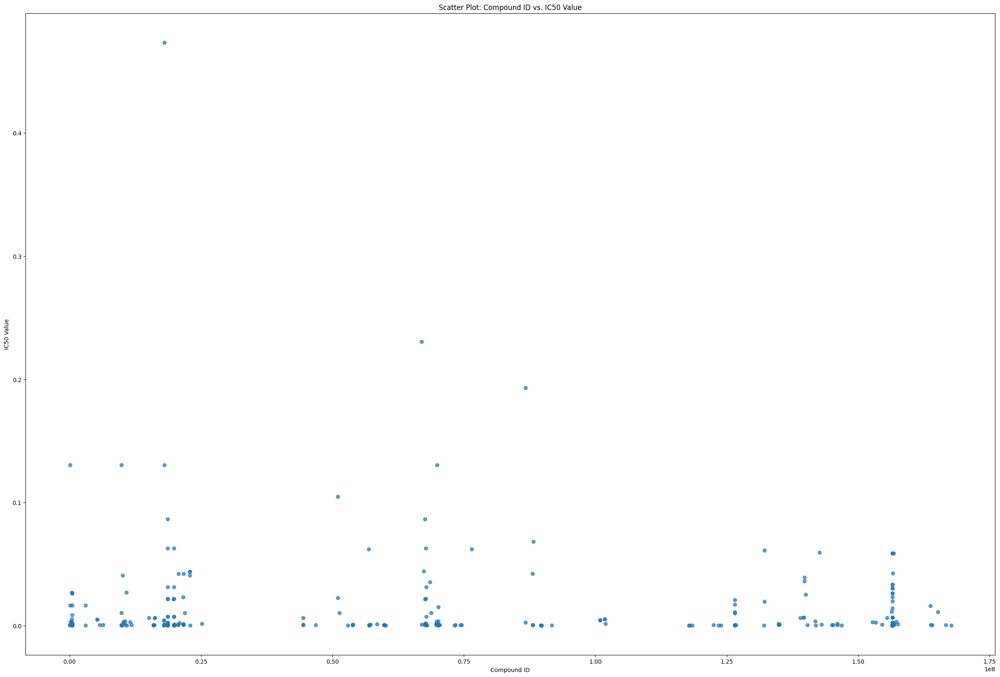

In [105]:
plt.figure(figsize=(30, 20))
plt.scatter(test['cid'], test['IC50 nm'], alpha=0.7)
plt.xlabel('Compound ID')
plt.ylabel('IC50 Value')
plt.title('Scatter Plot: Compound ID vs. IC50 Value')
plt.show()

# histogram

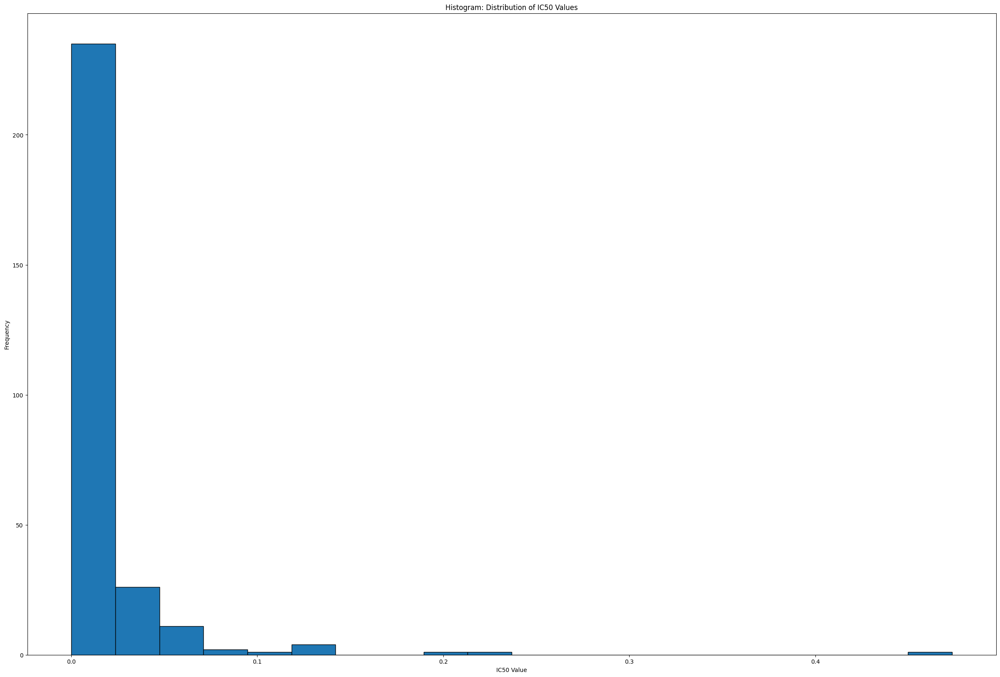

In [107]:
plt.figure(figsize=(30, 20))
plt.hist(test['IC50 nm'], bins=20, edgecolor='black')
plt.xlabel('IC50 Value')
plt.ylabel('Frequency')
plt.title('Histogram: Distribution of IC50 Values')
plt.show()

# now arranging the IC50 values in sorted order

In [49]:
sorted_df = cid.sort_values(by='IC50 nm')

In [50]:
sorted_df

,cid,cmpdname,IC50 nm
152,156452102,"[(1S,4R)-4-[[2-amino-6-(methylamino)purin-9-yl...",0.000138
234,60114946,"[(1S,4R)-4-(2-amino-6-methylpurin-9-yl)cyclope...",0.000230
240,22899310,[4-(2-Amino-6-methylpurin-9-yl)cyclopent-2-en-...,0.000230
203,91726673,N6-Cyclopropyl-9-(4-{[(trimethylsilyl)oxy]meth...,0.000283
77,9817873,(+/-)-cis-4-(2-Amino-6-(tert-butylamino)-9H-pu...,0.000354
...,...,...,...
232,69930853,"[(1R,4S)-4-[2-amino-6-(cyclopropylamino)purin-...",0.130579
246,18000489,[4-[2-Amino-6-(cyclopropylamino)purin-9-yl]cyc...,0.130579
229,86745071,2-Amino-6-((6-hydroxyhexyl)amino)9H-purin-9-yl...,0.193196
233,66939067,"[(1S,4R)-4-[6-[(2-aminocyclopropyl)amino]purin...",0.230523


# Top 25 columns based on IC50 ascending order 

In [51]:
sorted_df.head(25)

,cid,cmpdname,IC50 nm
152,156452102,"[(1S,4R)-4-[[2-amino-6-(methylamino)purin-9-yl...",0.000138
234,60114946,"[(1S,4R)-4-(2-amino-6-methylpurin-9-yl)cyclope...",0.000230
240,22899310,[4-(2-Amino-6-methylpurin-9-yl)cyclopent-2-en-...,0.000230
203,91726673,N6-Cyclopropyl-9-(4-{[(trimethylsilyl)oxy]meth...,0.000283
77,9817873,(+/-)-cis-4-(2-Amino-6-(tert-butylamino)-9H-pu...,0.000354
72,19822729,[4-[2-Amino-6-(tert-butylamino)purin-9-yl]cycl...,0.000354
73,18647004,"[(1R,4S)-4-[2-amino-6-(tert-butylamino)purin-9...",0.000354
160,126559182,6-De(cyclopropylamino)-6-(2-methylazetidin-1-y...,0.000374
161,89804902,6-N-cyclopropyl-9-[(4S)-4-(propan-2-yloxymethy...,0.000408
154,146865505,6-N-cyclopropyl-9-[4-(methoxymethyl)cyclopent-...,0.000412


# these 25 compounds are studied further using swiss adme 

## End